In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
mpl.rcParams['figure.facecolor'] = "white"
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
import random
mpl.rcParams['figure.facecolor'] = "white"
from PIL import Image
#plt.style.use('science')
def translate(frase, de = "en", a  = "es"):
    a = ! translate-cli -f {de} -t {a} {frase} -o
    return a
from tqdm.notebook import tqdm
tqdm.pandas()
import itertools
from matplotlib.ticker import FuncFormatter
import pickle
a_file = open("paises_dict.pkl", "rb")
paises_dict = pickle.load(a_file)
#mpl.style.use('classic')
#plt.style.use('classic')

In [2]:
OWID = pd.read_csv("https://covid.ourworldindata.org/data/owid-covid-data.csv")
OWID["datetime"] = pd.to_datetime(OWID.date)
print("OWID read")
#movilidad = pd.read_csv("https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv", sep = ",")
#print("MOV read")
#movilidad["datetime"] = pd.to_datetime(movilidad['date'])

OWID read


In [3]:
mov = movilidad[pd.isnull(movilidad.sub_region_1) &
         pd.isnull(movilidad.sub_region_2) &
         pd.isnull(movilidad.metro_area) &
         pd.isnull(movilidad.iso_3166_2_code) &
         pd.isnull(movilidad.census_fips_code)]

NameError: name 'movilidad' is not defined

In [3]:
country = "United Kingdom"
variable = "transit_stations_percent_change_from_baseline"

def plot_mov(country):
    fig, axs = plt.subplots(3,2, figsize = (12,10), dpi = 200)
    fig.suptitle(f"Google Mobility Reports: {country}".upper(), fontsize = 20, fontweight = "bold")

    fig.subplots_adjust(wspace = 0.3, hspace = 0.3, bottom = 0, top = .86)


    zs = list(itertools.product([0,1,2],[0,1]))

    for z,variable in enumerate(['retail_and_recreation_percent_change_from_baseline',
           'grocery_and_pharmacy_percent_change_from_baseline',
           'parks_percent_change_from_baseline',
           'transit_stations_percent_change_from_baseline',
           'workplaces_percent_change_from_baseline',
           'residential_percent_change_from_baseline']):
        t = zs[z]
        m = mov[mov.country_region == country]

        j1 = axs[t]
        p1, = j1.plot(m.datetime, m[variable].rolling(window = 7).mean(), linewidth = 3, color = "g")
        
        j1.axhline(0,linewidth = 1, color = "g", ls = "--")
        
        j2 = axs[t].twinx()
        p2, = j2.plot(OWID[OWID.location == country].datetime,
               OWID[OWID.location == country].new_cases_smoothed, color = "b", alpha = .5)

        j3 = axs[t].twinx()
        p3, = j3.plot(OWID[OWID.location == country].datetime,
               OWID[OWID.location == country].new_deaths_smoothed, color = "r", alpha = .5)
        
        j3.spines["right"].set_position(("axes", 1.08))
        
        
        j1.yaxis.label.set_color(p1.get_color())
        j2.yaxis.label.set_color(p2.get_color())
        j3.yaxis.label.set_color(p3.get_color())
        tkw = dict(size=4, width=1.5)
        j1.tick_params(axis='y', colors=p1.get_color(), labelsize = 7, **tkw)
        j2.tick_params(axis='y', colors=p2.get_color(), labelsize = 7, **tkw)
        j3.tick_params(axis='y', colors=p3.get_color(), labelsize = 7, **tkw)

        j1.set_ylabel("MOBILITY vs. FEB2020 (%)",fontsize = 7)
        j2.set_ylabel("COVID-19 CASES",fontsize = 7)
        j3.set_ylabel("COVID-19 DEATHS",fontsize = 7)


        #axs[z].xticks(fontsize = 3)
        #axs[z].yticks(fontsize = 3)
        axs[t].set_title(f"{variable[:-29]}".replace("_"," ").upper(), fontsize = 10, fontweight = "bold")
        axs[t].grid(alpha =.5)
        axs[t].xaxis.set_tick_params(labelsize=8)
        fig.tight_layout();

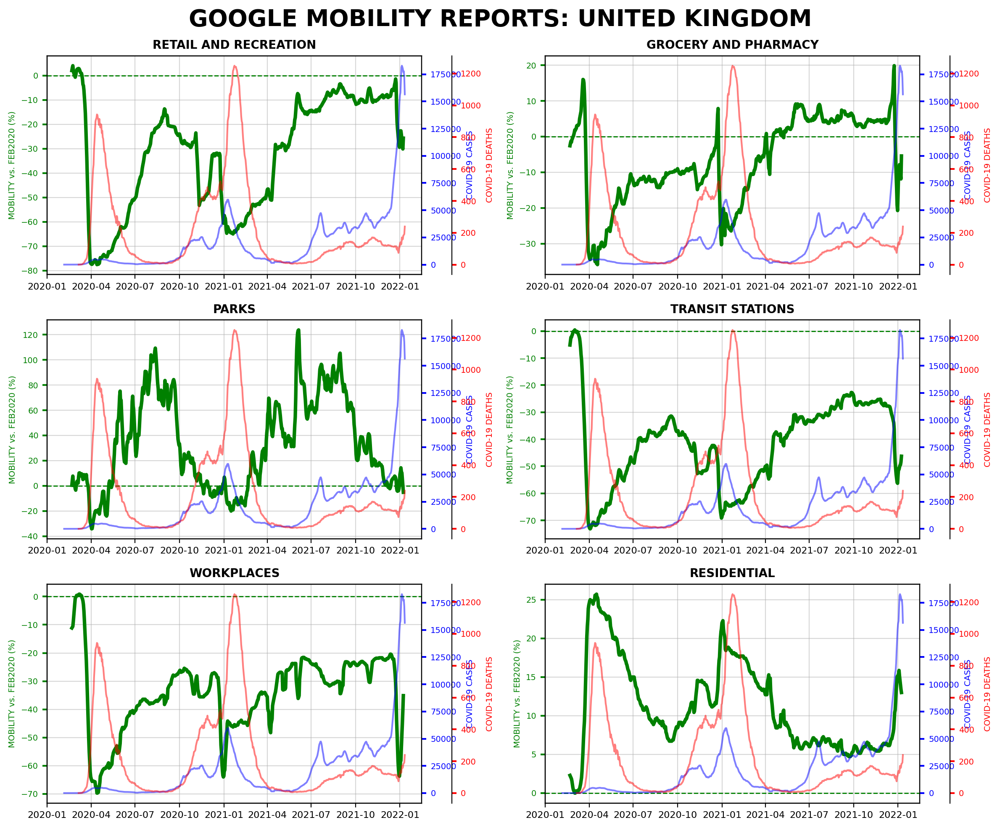

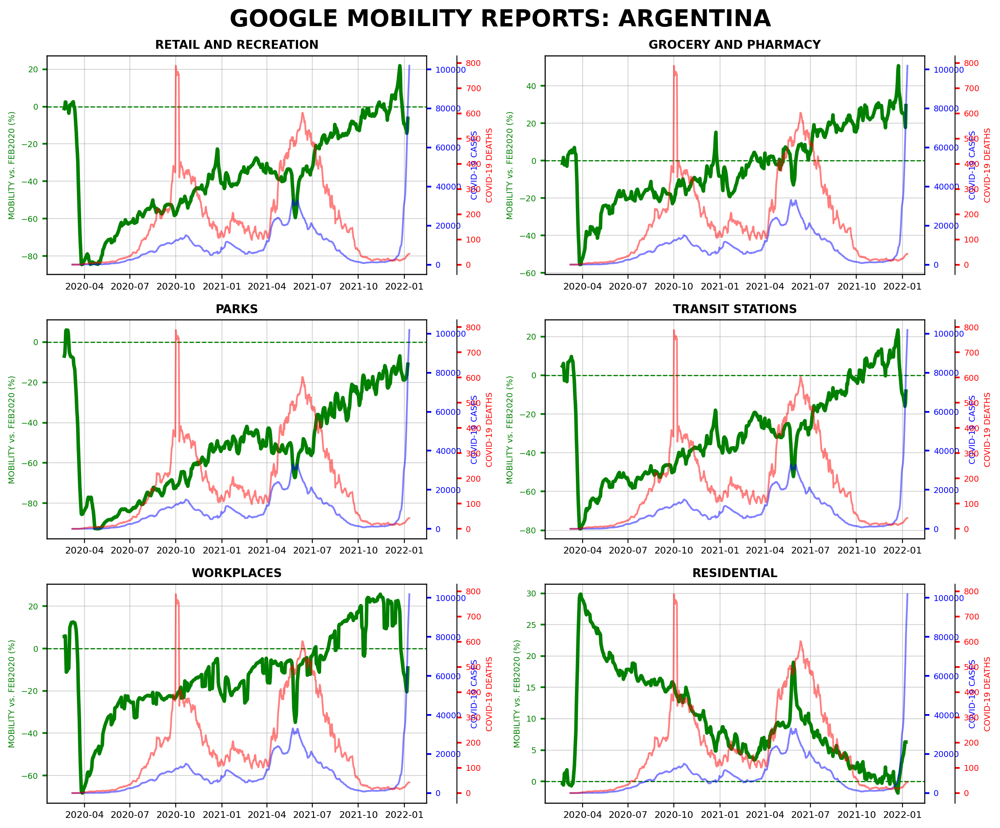

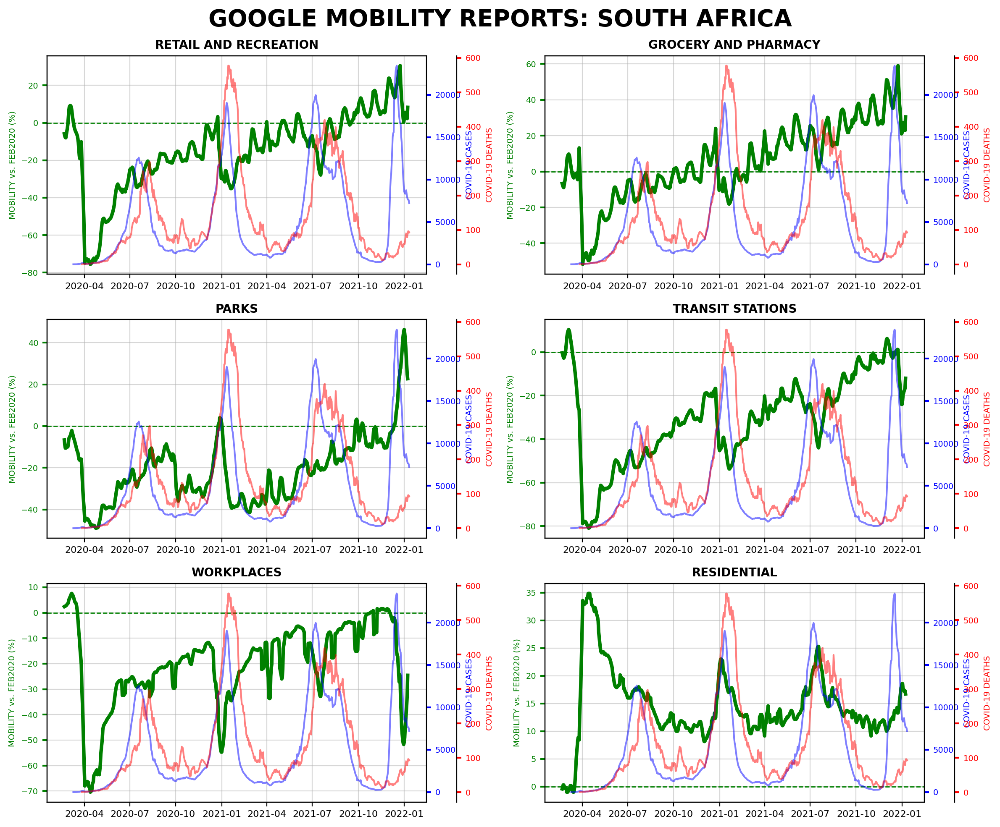

In [8]:
plot_mov("United Kingdom"), plt.savefig("mov_uk")
# plot_mov("Spain")
# plot_mov("France")
#plot_mov("Israel"), plt.savefig("mov_isr")
plot_mov("Argentina");    plt.savefig("mov_arg")
plot_mov("South Africa");    plt.savefig("mov_saf")

# Leo el archivo de movilidad y elijo región

In [ ]:
# movilidad = pd.read_csv("https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv?cachebust=6d352e35dcffafce", sep = ",")
# movilidad["datetime"] = pd.to_datetime(movilidad['date'])
# mov_it = movilidad[movilidad.country_region == "Italy"]
# mov_it = mov_it[pd.isna(mov_it.sub_region_1)] # Me quedo con los datos de movilidad del país en general.

# Leo el archivo de casos 

In [ ]:
casos_it = pd.read_csv("https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv")

muertos_it = casos_it[["data","deceduti"]]
casos_it = casos_it[["data","nuovi_positivi"]]

casos_it["datetime"] = pd.to_datetime([i[0:10] for i in casos_it['data']])
casos_it = casos_it.drop("data", axis = 1)
muertos_it["datetime"] = pd.to_datetime([i[0:10] for i in muertos_it['data']])
muertos_it = muertos_it.drop("data", axis = 1)

casos = casos_it.nuovi_positivi
muertos = muertos_it.deceduti

nouvi_deceduti = [muertos[i] - muertos[i-1] for i in range(1,len(muertos))]
nouvi_deceduti = [0] + nouvi_deceduti
muertos_it["nuovi_deceduti"] = nouvi_deceduti

In [ ]:
muertos_it.tail(10)

In [ ]:
casos_it.tail(14).nuovi_positivi

# Agrego el inicio de cuarentena 

# GIF IT

In [7]:
# for i in range(0,150,):
#     dias_a_plotear = i

#     fig,ax = plt.subplots(figsize=(10,12))
#     ax.plot(mov_it.days_since_qt[:dias_a_plotear],  mov_it.transit_stations_percent_change_from_baseline.rolling(window = 7).mean()[:dias_a_plotear], "grey", linewidth = 6, label = "Movilidad")
#     ax.set_title("Movilidad, casos y muertes diarias (Italia)", fontsize=16,fontweight='bold')
#     ax.axvline(x= 0, c = "purple", linewidth = 3, label = "Cuarentena estricta", ls = ":")
#     ax.axvline(x= 35, c = "darkblue", linewidth = 2, label = "Inicio desconfinamiento", ls = "--", alpha = 0.3)
#     #ax.axvline(x= 69, c = "darkblue", linewidth = 3, label = "Desconfinamiento (II)", ls = "--", alpha = 0.5)
#     ax.set_xlabel("Días desde que se decretó la cuarentena estricta", fontsize=18)
#     #ax.plot(dias_que_siguen, m*dias_que_siguen+b, label = "Proyección", c = "red",ls = ":", linewidth = 3)
#     #ax.plot(X, m*X+b, label = "Tendencia de aumento \n de movilidad", c = "red", linewidth = 3)
    
#     ax.legend(prop={'size': 12}, loc='upper left')
#     ax.set_ylabel("Cambio porcentual respecto al basal", fontsize=18)
#     ax.set_ylim(-100,20)
#     ax.set_xlim(-20,90)
#     ax.tick_params(labelsize=18)
#     ax.axhline(0, c = "black", ls = "--", alpha = 0.5)
#     ax.text(30,17, "Por @SantiOlsze",fontsize = 13,fontweight='bold')
    
#     ax2=ax.twinx()
#     ax2.set_ylim(0,7000)
#     ax2.tick_params(labelsize=18)
#     if i > 7:
#         ax2.plot(dias_casos[:dias_a_plotear-7], casos.rolling(window = 5).mean()[:dias_a_plotear-7], linewidth = 5, label = "Casos nuevos por día", alpha = 0.6)
#         ax2.plot(dias_casos[:dias_a_plotear-7], pd.Series(nouvi_deceduti).rolling(window = 7).mean()[:dias_a_plotear-7], linewidth = 5, label = "Muertes nuevas por día", alpha = 0.7)
#     ax2.legend(prop={'size': 12}, loc="upper right")
#     ax2.set_ylabel("Casos/muertes nuevos por día", fontsize=18)
#     ax2.tick_params(labelsize=18)

#     plt.legend()
#     plt.savefig(str("IT/" + str(dias_a_plotear)))
#     plt.close()

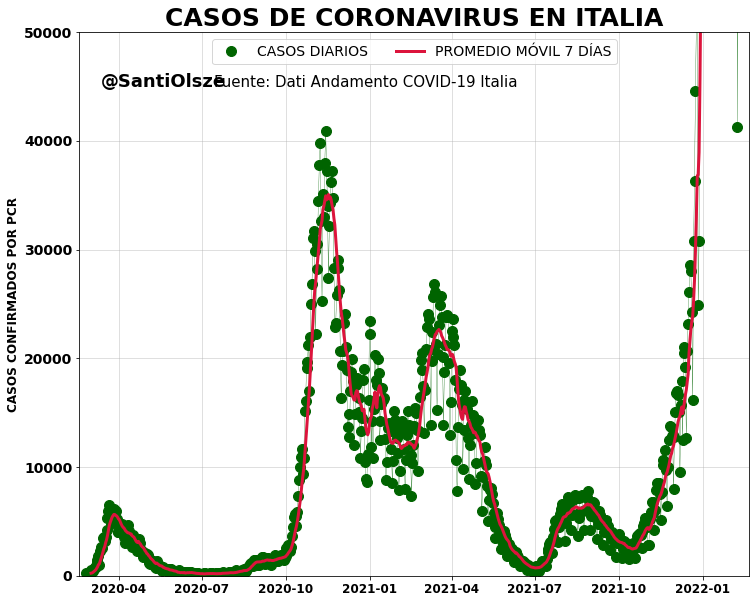

In [4]:
it = pd.read_csv("https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv")
it["date"] = pd.to_datetime(it.data)
it = it.groupby("date").sum()
plt.figure(figsize = (12,10))
plt.title("CASOS DE CORONAVIRUS EN ITALIA",fontsize = 25, fontweight = "bold")
plt.plot(it.index, it.nuovi_positivi, marker = "o",ms = 10, color = "darkgreen", linewidth = 0, label = "Casos diarios".upper())
plt.plot(it.index, it.nuovi_positivi, marker = "o",ms = 0, color = "darkgreen", linewidth = 0.3)

plt.plot(it.index, it.nuovi_positivi.rolling(window = 7).mean(), color = "crimson", linewidth = 3, label = "Promedio móvil 7 días".upper())
plt.xticks(fontsize = 12, fontweight = "bold")
plt.yticks(fontsize = 14, fontweight = "bold")
plt.ylabel("Casos confirmados por PCR".upper(),fontsize = 12, fontweight = "bold")
plt.grid(alpha = 0.5)
plt.legend(loc = "upper center",fontsize = 14, ncol = 2)
ylim = 50000
plt.text(x=pd.to_datetime("2020-05-20"),y =ylim*0.9, s = "@SantiOlsze",fontsize = 18, fontweight = "bold", ha ="center")
plt.text(x=pd.to_datetime("2020-07-14"), y = ylim*0.9, s = "Fuente: Dati Andamento COVID-19 Italia",fontsize = 15)
plt.xlim(pd.to_datetime("2020-02-18"),datetime.datetime.today()+datetime.timedelta(10))
plt.ylim(0,ylim)
plt.savefig("casos_it_ahora", bbox_inches = "tight")

In [9]:
spain = OWID[OWID.location == "Spain"]
antes = spain[spain.datetime < "2020-08-01"]
despues = spain[spain.datetime >= "2020-08-01"]

despues.new_deaths.sum()

60694.0

Sweden 5059.0
Denmark nan
Finland 3223.0
Norway nan


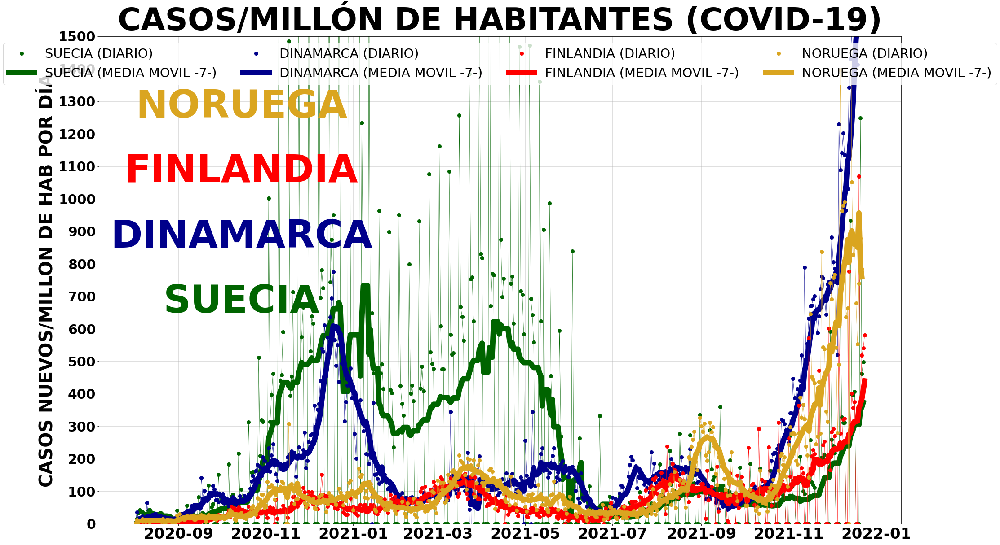

In [5]:
c = ["darkgreen","darkblue","red","goldenrod"]

paises_owid = ["Sweden","Denmark","Finland","Norway"]
paises_esp = {"Spain":"España","France":"Francia","Ireland":"Irlanda","Argentina":"Argentina", "Italy":"Italia","Germany":"Alemania","United Kingdom":"Gran Bretaña","Belgium":"Bélgica"}
paises_esp = {"Sweden":"Suecia","Denmark":"Dinamarca","Finland":"Finlandia","Norway":"Noruega"}


plt.figure(figsize = (32,20))
plt.title("CASOS/MILLÓN de habitantes (covid-19)".upper(),fontsize = 70, fontweight = "bold")
ylim = 1500
plt.xticks(fontsize = 34, fontweight = "bold")
plt.yticks(np.linspace(0,ylim,int(ylim/100+1)),fontsize = 30, fontweight = "bold")
plt.ylabel("Casos nuevos/MILLON DE HAB por día".upper(),fontsize = 40, fontweight = "bold")

plt.ylim(0,ylim)

for z, pa in enumerate(paises_owid):

    sp = OWID[OWID.location == pa]
    sp = sp[sp.datetime > pd.to_datetime("2020-8-01")]
    print(pa,float(sp.tail(1).new_cases))
    #print(pa,int(sp.new_cases[sp.index[-31]]))
    plt.plot(sp.datetime, sp.new_cases/sp.population*1000000, marker = "o",ms = 8, color = c[z], linewidth = 0, label = paises_esp[pa].upper() + " (diario)".upper())
    plt.plot(sp.datetime, sp.new_cases/sp.population*1000000, marker = "o",ms = 0, color = c[z], linewidth = 0.6)
    plt.plot(sp.datetime, sp.new_cases.rolling(window = 7).mean()/sp.population*1000000, color = c[z], linewidth = 12, label = paises_esp[pa].upper() + " (media movil -7-)".upper())
    plt.text(x = pd.to_datetime("2020-10-15"), y = 250 + 200*(z+2), s = paises_esp[pa].upper(), color = c[z], fontsize = 85, fontweight = "bold", ha = "center")
plt.grid(alpha = 0.5)
plt.legend(loc = "upper center",fontsize = 29, ncol = len(paises_owid))
#plt.text(x=sp.datetime[sp.index[-190]], y = ylim - 5700, s = "@SantiOlsze",fontsize = 50, fontweight = "bold")
#plt.text(x=sp.datetime[sp.index[-129]], y = ylim - 5700, s = "Fuente: OurWorldInData",fontsize = 33)

plt.savefig("casos_europeos_mill", bbox_inches = "tight")

In [17]:
casos_it = pd.read_csv("https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv")

#muertos_it = casos_it[["data","deceduti"]]
#casos_it = casos_it[["data","nuovi_positivi"]]
#casos_it["datetime"] = pd.to_datetime([i[0:10] for i in casos_it['data']])
#casos_it = casos_it.drop("data", axis = 1)
#muertos_it["datetime"] = pd.to_datetime([i[0:10] for i in muertos_it['data']])
#muertos_it = muertos_it.drop("data", axis = 1)

casos = casos_it.nuovi_positivi
muertos = casos_it.deceduti

nouvi_deceduti = [muertos[i] - muertos[i-1] for i in range(1,len(muertos))]
nouvi_deceduti = [0] + nouvi_deceduti
casos_it["nuovi_deceduti"] = nouvi_deceduti

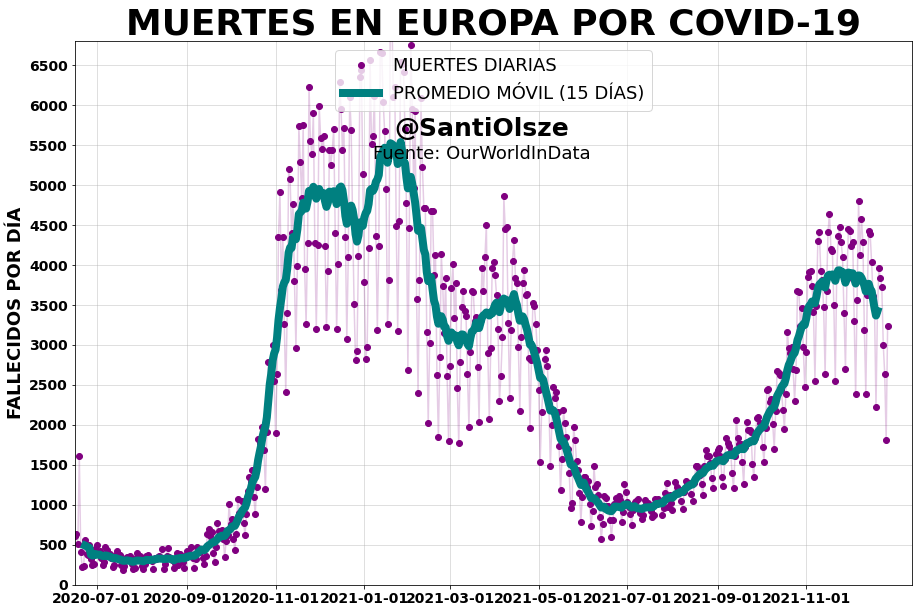

In [10]:
cont = "Europe"
conts = "Europa"
eu = OWID[OWID.continent == cont].groupby("date").sum()
plt.figure(figsize = (15,10))

dias = 560


x = eu.index[-dias:]
x = pd.to_datetime(x)
y = eu.new_deaths[-dias:]
#plt.axvline(pd.to_datetime("2020-10-11"), linewidth = 3, color = "red", ls = "--")
plt.plot(x, y, "ko", label = "Muertes diarias".upper(), color = "purple")
plt.plot(x, y, "purple", alpha = 0.2)
plt.plot(x, y.rolling(window = 15, center = True).mean(), "teal", linewidth = 8, label = "Promedio móvil (15 días)".upper())
plt.xticks([i for i in x if i.day in [1] and (i.month)%2 != 0], fontweight = 'bold', fontsize = 14)
plt.yticks(np.linspace(0,7000,15),fontweight = 'bold', fontsize = 14)
plt.ylabel("Fallecidos por día".upper(),fontweight = 'bold', fontsize = 18)
plt.ylim(0,6800)
plt.xlim(x[0], datetime.datetime.today()+datetime.timedelta(15))

t = y[y == max(y[0:200])].index[0]
t = pd.to_datetime(t)

#plt.text(x = t, y = max(y[0:200])+150, s = str(max(y[0:200]))[:-2], ha = "center", fontweight= "bold", fontsize = 28, color = "k")

d = 15
#plt.text(x = datetime.datetime.today()-datetime.timedelta(d ), y = y[-d ]+150, s = str(y[-d ])[:-2], ha = "center", fontweight= "bold", fontsize = 28, color = "k")

try:
    pos = x[int(len(x)/2)]
except:
    pos = x[int(len(x)+1/2)]

plt.text(x=pos, y = 5620, s = "@SantiOlsze",fontsize = 25, fontweight = "bold", ha = "center")
plt.text(x=pos, y = 5326, s = "Fuente: OurWorldInData",fontsize = 18, ha = "center")
plt.grid(":", alpha = 0.5)



plt.legend(fontsize = 18, loc = "upper center")
plt.title("MUERTES EN EUROPA POR COVID-19", fontweight = 'bold', fontsize = 36);
plt.savefig("muertes en europa"+str(dias), bbox_inches = "tight")

In [19]:
y[-1]

2180.0

In [20]:
eu = OWID[OWID.continent == "Europe"]
antes = eu[eu.date <= "2020-07-15"]
desp = eu[eu.date > "2020-07-15"]

In [21]:
print(desp.new_deaths.sum())
print(antes.new_deaths.sum())

1057342.0
193556.0


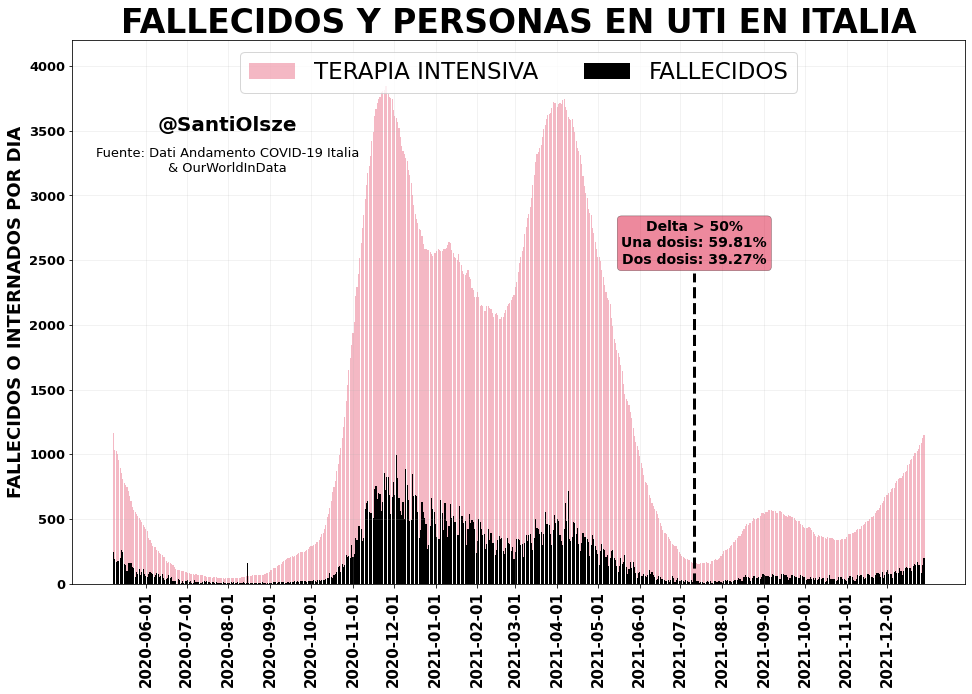

In [12]:
df = pd.read_csv("https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv")

fig = plt.figure(figsize = (16,10))
ax = fig.add_subplot(111)

dias = 600

x = df.data[-dias:]
x = pd.to_datetime(x)
y = df.terapia_intensiva[-dias:]

x2 = muertos_it.datetime[-dias:]
y2 = muertos_it.nuovi_deceduti[-dias:]


ylim = 540
ax.bar(x, y, color = "crimson", linewidth = 5, label = "TERAPIA INTENSIVA", alpha = 0.3)
#ax.plot(x, y, color = "red", linewidth = 3, label = "% FALL / TER")
ax.bar(x, y2, color = "k", linewidth = 5, label = "FALLECIDOS")
#plt.xticks([i for i in x if i.day in [31]], fontweight = 'bold', fontsize = 15)
ax.legend(fontsize = 25)
ax.text(x=pd.to_datetime("2020-08-01"),y =3500, s = "@SantiOlsze",fontsize = 20, fontweight = "bold", ha ="center")
ax.text(x=pd.to_datetime("2020-8-01"), y = 3180, s = "Fuente: Dati Andamento COVID-19 Italia\n& OurWorldInData",fontsize = 13,ha="center")
#plt.plot(muertos_it.datetime[-dias:], muertos_it.nuovi_deceduti[-dias:], linewidth = 3, label = "FALLECIDOS", color = "k")
plt.yticks(np.linspace(0,4000,9),fontweight = 'bold', fontsize = 13)
plt.grid(":", alpha = 0.2)
plt.ylabel("FALLECIDOS O INTERNADOS POR DIA",fontweight = 'bold', fontsize = 18)
#ax2 = ax.twinx()
y3 = (y2.rolling(window = 7,center= True).mean()/y.rolling(window = 7,center= True).mean()*100)
y3_f = []
#ax2.plot(x, y3, color = "blue", label = "% FALL / TER", linewidth = 3)
#ax2.set_ylim(0,30)
plt.xticks([i for i in x if (i.day in [1,155] and i.month//2 == 0)], fontweight = 'bold', fontsize = 15, rotation = 90)
plt.yticks(fontweight = 'bold', fontsize = 13, color = "k")
#plt.ylabel("PORCENTAJE FALLECIDOS/INTERNADOS",fontweight = 'bold', fontsize = 18, color = "blue")
plt.grid(":", alpha = 0.2)
plt.title("FALLECIDOS Y PERSONAS EN UTI EN ITALIA", fontweight = 'bold', fontsize = 33)
plt.legend(loc = "upper center", ncol = 2,fontsize = 23)
plt.xticks([i for i in x if i.day in [1,155]], fontweight = 'bold', fontsize = 15, rotation = 90)
plt.ylim(0,4200)
plt.axvline(pd.to_datetime("2021-07-12"), ls = "--", linewidth = 3, color = "k", alpha = 1, ymax = 0.571)


props = dict(boxstyle='round', facecolor='crimson', alpha=.5, edgecolor = "k", linewidth = 0.5)

plt.text( x = pd.to_datetime("2021-07-12"), y = 2630 , va = "center", ha = "center",
         fontsize = 14, bbox = props,
        s = "Delta > 50%\nUna dosis: 59.81%\nDos dosis: 39.27%", color = "k", fontweight  = "bold")


plt.savefig("it_ter", bbox_inches = "tight");

In [23]:
muertos_it[muertos_it.datetime < pd.to_datetime("2020-07-01")].nuovi_deceduti.sum()

34760

In [24]:
muertos_it[muertos_it.datetime >= pd.to_datetime("2020-07-01")].nuovi_deceduti.sum()

96617

In [25]:
difs = 0
for i,v in enumerate(df.terapia_intensiva):
    if i > 0:
        dif = df.terapia_intensiva[i] - df.terapia_intensiva[i-1]
        if dif > 0:
            difs += 1
        else:
            difs = 0

In [26]:
muertos_it.iloc[190]

deceduti                        35491
datetime          2020-09-01 00:00:00
nuovi_deceduti                      8
Name: 190, dtype: object

In [27]:
it_reg = pd.read_csv("https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-regioni/dpc-covid19-ita-regioni.csv")

lomb = it_reg[it_reg.denominazione_regione == "Lombardia"]

muertos_it = lomb[["data","deceduti"]]
casos_it = lomb[["data","nuovi_positivi"]]

casos_it["datetime"] = pd.to_datetime([i[0:10] for i in casos_it['data']])
casos_it = casos_it.drop("data", axis = 1)
muertos_it["datetime"] = pd.to_datetime([i[0:10] for i in muertos_it['data']])
muertos_it = muertos_it.drop("data", axis = 1)

casos = casos_it.nuovi_positivi
muertos = list(muertos_it.deceduti)

nouvi_deceduti = [muertos[i] - muertos[i-1] for i in range(1,len(muertos))]
nouvi_deceduti = [0] + nouvi_deceduti
muertos_it["nuovi_deceduti"] = nouvi_deceduti

<ipython-input-27-ce330025dff5>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  casos_it["datetime"] = pd.to_datetime([i[0:10] for i in casos_it['data']])
<ipython-input-27-ce330025dff5>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  muertos_it["datetime"] = pd.to_datetime([i[0:10] for i in muertos_it['data']])


In [28]:
muertos_it

,deceduti,datetime,nuovi_deceduti
8,6,2020-02-24,0
29,9,2020-02-25,3
50,9,2020-02-26,0
71,14,2020-02-27,5
92,17,2020-02-28,3
...,...,...,...
12440,34078,2021-10-08,3
12461,34083,2021-10-09,5
12482,34085,2021-10-10,2
12503,34090,2021-10-11,5


In [29]:
(OWID.location == "Montenegro").value_counts()

False    122456
True        574
Name: location, dtype: int64

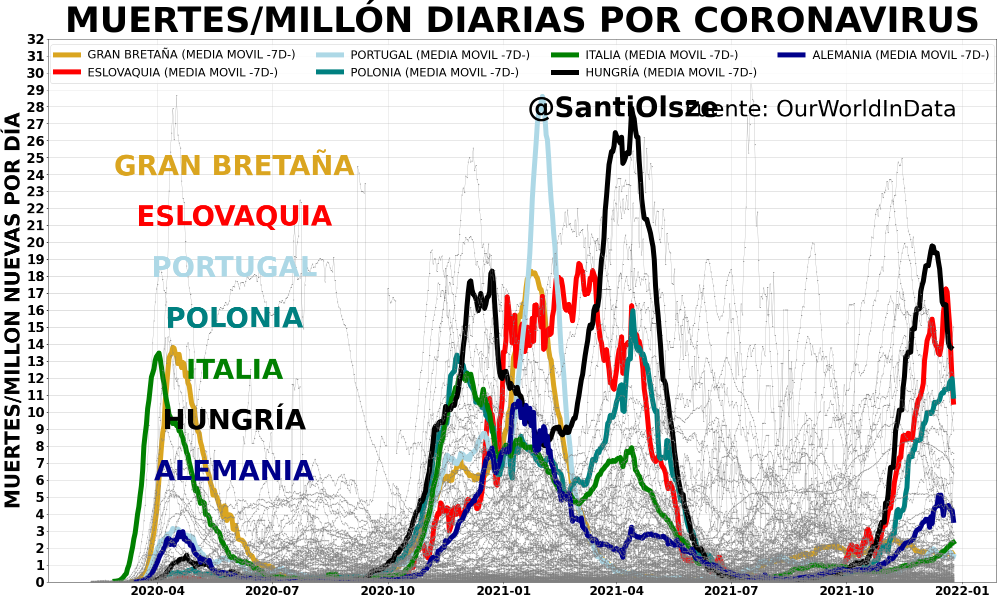

In [7]:
c = ["green","goldenrod","lightblue","red","darkblue","teal", "k","teal"]

paises_owid = ["Italy", "United Kingdom", "Portugal","Slovakia","Germany","Czech Republic", "Hungary","Poland"]
paises_esp = {"Spain":"España","France":"Francia", "Portugal":"Portugal","Slovakia":"Eslovaquia","Mexico":"Mexico", "Italy":"Italia","Bulgaria":"Bulgaria","Germany":"Alemania","United Kingdom":"Gran Bretaña","Belgium":"Bélgica", "Argentina": "Argentina","Switzerland":"Suiza","Czech Republic":"Rep. Checa","Poland":"Polonia", "Hungary":"Hungría","Austria":"Austria", "Slovenia":"Eslovenia","Sweden":"Suecia", "Ireland":"Irlanda", "Brazil":"Brasil", "Chile":"Chile","Perú":"Perú","Peru":"Peru","Ecuador":"Ecuador","Bolivia":"Bolivia", "Colombia":"Colombia","Venezuela":"Venezuela", "Uruguay":"Uruguay",'Bosnia and Herzegovina':'Bosnia y H.'}
#paises_owid = ["Italy", "Slovakia","Brazil","Germany","Czech Republic", "Hungary","Poland","Spain","Mexico", "Argentina"]
#paises_owid = ["Brazil", "Hungary","Bulgaria","Czechia",'Bosnia and Herzegovina',"Slovakia", "Uruguay"]
#paises_owid = ["Brazil", "Colombia","",'Argentina', "Uruguay", "Paraguay","Chile"]


for pais in paises_owid:
    if pais not in paises_esp:
        paises_esp[pais] = pais

colors = dict(zip(paises_owid,c))


plt.figure(figsize = (34,20))
plt.title("MUERTES/millón diarias POR CORONAVIRUS".upper(),fontsize = 70, fontweight = "bold")
ylim = 32
plt.xticks(fontsize = 24, fontweight = "bold")
plt.yticks(np.linspace(0,ylim,ylim+1),fontsize = 26, fontweight = "bold")
plt.ylabel("MUERTES/millon nuevAs por día".upper(),fontsize = 40, fontweight = "bold")

plt.ylim(0,ylim)

todo_europa = set(OWID[OWID.population>2000000].location)
todo_europa = list(todo_europa)
todo_europa.sort(reverse= True)
n = 0
for z, pa in enumerate(todo_europa):
    if pa in paises_owid:
        n += 3
        sp = OWID[OWID.location == pa]
        sp = sp[sp.datetime > pd.to_datetime("2020-02-01")]
        ytrend = sp.new_deaths.rolling(window = 7).mean()/sp.population*1000000
        plt.plot(sp.datetime, ytrend, color = colors[pa], linewidth = 10, label = paises_esp[pa].upper() + " (media movil -7d-)".upper())
        plt.text(x =pd.to_datetime("2020-06-01") , y = ylim -5- n, s = paises_esp[pa].upper(), color = colors[pa], fontsize = 55, fontweight = "bold", ha = "center")
    elif pa != "World":
        sp = OWID[OWID.location == pa]
        sp = sp[sp.datetime > pd.to_datetime("2020-02-01")]
        #print(pa,float(sp.tail(1).new_deaths))
        #print(pa,int(sp.new_cases[sp.index[-31]]))
        ytrend = sp.new_deaths.rolling(window = 7).mean()/sp.population*1000000
        plt.plot(sp.datetime, ytrend, marker = "o",ms = 1, color = "grey", linewidth = 0.4, alpha = 1)
        z = z-1     
plt.grid(alpha = 0.5)
plt.legend(loc = "upper center",fontsize = 23, ncol = 4)
plt.text(x=sp.datetime[sp.index[-340]], y = ylim - 4.57, s = "@SantiOlsze",fontsize = 55, fontweight = "bold")
plt.text(x=sp.datetime[sp.index[-215]], y = ylim - 4.57, s = "Fuente: OurWorldInData",fontsize = 45)

plt.savefig("fall_todos", bbox_inches = "tight")

In [31]:
ayer = OWID[OWID.date == "2021-02-05"]
ayer["d_p_m"] = ayer.total_deaths/ayer.population * 1000000
ayer = ayer[ayer.population > 3000000].sort_values("d_p_m", ascending = False).head(20).sort_values("d_p_m", ascending = True).head(20)

<ipython-input-31-89d9c8059866>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ayer["d_p_m"] = ayer.total_deaths/ayer.population * 1000000


['Grenada', 'Antigua and Barbuda', 'Saint Lucia', 'Suriname', 'Bulgaria', 'Saint Vincent and the Grenadines', 'Romania', 'Bahamas', 'Saint Kitts and Nevis', 'Bosnia and H', 'Montenegro', 'Dominica', 'Lithuania', 'North Macedonia', 'Lesotho']


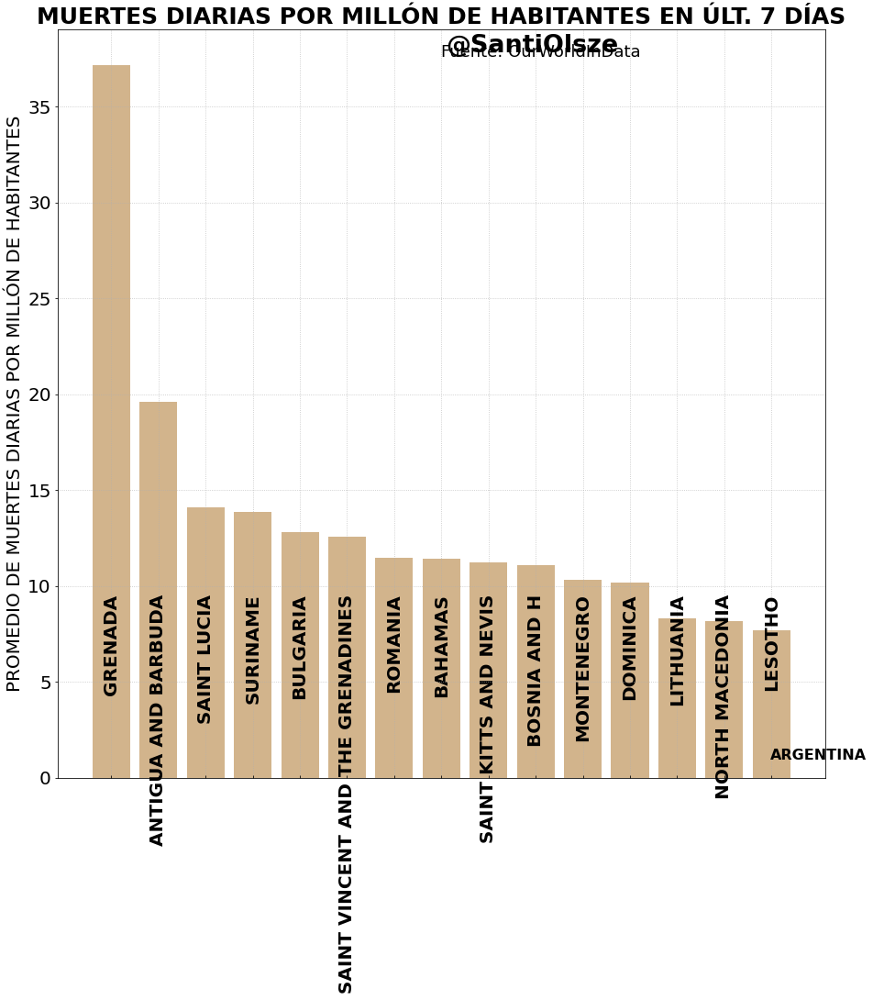

In [32]:

countries = list(set(OWID.location))
countries.remove("Hong Kong")
muertes_nuevos_x_millon = []
subset2 = []

for country in countries:
    #if country in cont:
        try:
            muertes_nuevos_x_millon.append(float(OWID[OWID.location == country].tail(15).new_deaths_per_million.mean()))
            subset2.append(country)
        except:
            print(country, "is NA")
            countries.remove(country)
        

dic_EU_new_deaths = dict(zip(subset2,muertes_nuevos_x_millon))

       
        
x = dic_EU_new_deaths.copy()
x_ord = {k: v for k, v in sorted(x.items(), key=lambda item: item[1])}

#small_countries = ["Andorra","San Marino", "Luxembourg","Monaco", "Montenegro","Malta"]

#for i in small_countries:
#    if i in x_ord:
#        del x[i]


try:
    x_ord["Bosnia and H"] = x_ord['Bosnia and Herzegovina']
    x_ord.pop('Bosnia and Herzegovina')
except:
    print("a")

x_ord = {k: x_ord[k] for k in x_ord if not np.isnan(x_ord[k])}
x_ord = {k: v for k, v in sorted(x_ord.items(), key=lambda item: item[1])}


cantidad = 15

fig, ax = plt.subplots(figsize = (15,15))

label = [i for i in reversed(list(x_ord.keys()))]
height = [i for i in reversed(list(x_ord.values()))]
color = []

dic = dict(zip(label,height))

for i in label:
    if i in ["Argentina","Chile","Brazil","Peru", "Colombia", "Bolivia"]:
        color.append("maroon")
    else:
        color.append("tan")
plt.bar(label[:cantidad], height[:cantidad], color = color)
plt.yticks(fontsize = 20)
plt.ylabel("Promedio de muertes diarias por millón de habitantes".upper(), fontsize = 20)
plt.title("Muertes diarias por millón de habitantes en últ. 7 días".upper(), fontsize = 25, fontweight = "bold")
plt.xticks(label[:cantidad],[i.upper() for i in label[:cantidad]],fontweight= "bold", fontsize = 20, ha = "center")
ax.tick_params(axis="x",direction="in", pad=-200, rotation = 90)


for i in ["Argentina", "Colofmbia"]:
    if i in label:
        n = 1.01
        if i == "Colwsombia":
            plt.text(y = dic[i]*n*1.02, x = i, s = i.upper(),fontsize = 16, ha = "center",  fontweight = "bold")
        else:
            plt.text(y = dic[i]*n, x = i, s = i.upper(),fontsize = 16, ha = "center", fontweight = "bold")
            
plt.text(y = height[0]*1.02-0.05, x = 7.1,s = "@SantiOlsze",fontsize = 27, fontweight = "bold")            
plt.text(y = height[0]*1.02-0.3, x = 7, s = "Fuente: OurWorldInData",fontsize = 18)
plt.grid(linestyle = ":", alpha = 0.8)
plt.savefig("top10_d", bbox_inches = "tight");
print(label[:cantidad])

In [33]:
#FRANCIA

In [34]:

#OWID["datetime"] = pd.to_datetime(OWID['date'], format = "%Y-%m-%d")

In [35]:
def plot_mov_cases_deaths(country, fecha_inicial, legend_pos = "upper left"):
    mov_sw = movilidad[movilidad.country_region == country]
    mov_sw = mov_sw[pd.isna(mov_sw.sub_region_1)]
    df = OWID[OWID.location == country]

    fechas = df.datetime[df.datetime > fecha_inicial]
    casos_nuevos = df.new_cases[df.datetime > fecha_inicial]
    muertes_nuevas = df.new_deaths[df.datetime > fecha_inicial]
    
    
    
    fig,ax = plt.subplots(figsize=(12,10))
    ax.plot(mov_sw.datetime,  mov_sw.transit_stations_percent_change_from_baseline.rolling(window = 7).mean(), linestyle = "dashed", color ="grey", linewidth = 4, label = "Movilidad en el transporte".upper())
    ax.plot(mov_sw.datetime,  mov_sw.workplaces_percent_change_from_baseline.rolling(window = 7).mean(), linewidth = 4, label = "Movilidad en el trabajo".upper(), color = "k")
    ax.set_title(("Movilidad y casos ("+ "Francia" + ")").upper(), fontsize=26, fontweight = "bold")
    #ax.set_title(("Movilidad y casos ("+ country + ")").upper(), fontsize=26, fontweight = "bold")

    ax.grid( alpha = 0.5)
    #ax.set_xlim(-50,100)
    ax.set_xlabel("Fecha", fontsize=18)

    ax.legend(prop={'size': 14}, loc='upper left')
    ax.set_ylabel("Movilidad (cambio porcentual respecto al basal)".upper(), fontsize=20)
    ax.set_ylim(-100,50)
    ax.tick_params(labelsize=12)
    #ax.axhline(0, label = "Movilidad basal en CABA", c = "black", ls = "--")
    ax.text(pd.to_datetime("2020-02-15"),28, "@SantiOlsze",fontsize = 22, fontweight = "bold");
    ax2=ax.twinx()
    #ax2.set_xticklabels(labels = [i for i in mov_sw.datetime if i.day == 1], rotation = 45)
    ax2.plot(fechas, pd.Series(casos_nuevos).rolling(window = 7).mean(), linewidth = 5, label = "Casos diarios (media movil 7 días)".upper(), alpha = 0.5)
    ax2.plot(fechas, pd.Series(casos_nuevos).rolling(window = 1).mean(), "bo", label = "Casos diarios".upper(), alpha = 0.3, ms = 3.5)
    ax2.plot(fechas, pd.Series(casos_nuevos).rolling(window = 1).mean(), "b", alpha = 0.3, linewidth = 0.5)
    #ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 7).mean(), linewidth = 5, label = "Muertes nuevas por día \n (promedio semanal)", alpha = 0.5)
    #ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 1).mean(), "ro", label = "Muertes nuevas por día", alpha = 0.3, ms = 3.5)
    #ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 1).mean(), "r", alpha = 0.3, ms = 3.5,linewidth = 0.5)
    #ax2_ylim = max(casos_nuevos)*1.2
    ax2.grid("--", alpha = 0.5)
    ax2.legend(prop={'size': 14}, loc="upper right")
    ax2.set_ylabel("Casos nuevos por día".upper(), fontsize=20)
    ax2.tick_params(labelsize=14)
    #ax2.set_ylim(0,ax2_ylim)

In [36]:
def plot_mov_cases_deaths(country, fecha_inicial, legend_pos = "upper left"):
    mov_sw = movilidad[movilidad.country_region == country]
    mov_sw = mov_sw[pd.isna(mov_sw.sub_region_1)]
    df = OWID[OWID.location == country]

    fechas = df.datetime[df.datetime > fecha_inicial]
    casos_nuevos = df.new_cases[df.datetime > fecha_inicial]
    muertes_nuevas = df.new_deaths[df.datetime > fecha_inicial]
    
    if country == "France":
        pais = "Francia"
    elif country == "Spain":
        pais = "España"
    elif country == "Italy":
        pais = "Italia"
    elif country == "Germany":
        pais = "Alemania"
    elif country == "United Kingdom":
        pais = "Gran Bretaña"
    
    else:
        pais = country
        
    fig,ax = plt.subplots(figsize=(12,10))
    ax.plot(mov_sw.datetime,  mov_sw.transit_stations_percent_change_from_baseline.rolling(window = 7).mean(), linestyle = "dashed", color ="grey", linewidth = 4, label = "Movilidad en el transporte".upper())
    ax.plot(mov_sw.datetime,  mov_sw.workplaces_percent_change_from_baseline.rolling(window = 7).mean(), linewidth = 4, label = "Movilidad en el trabajo".upper(), color = "k")
    ax.set_title(("Movilidad y fallecidos ("+ pais + ")").upper(), fontsize=30, fontweight = "bold")
    #ax.set_title(("Movilidad y casos ("+ country + ")").upper(), fontsize=26, fontweight = "bold")

    ax.grid( alpha = 0.5)
    #ax.set_xlim(-50,100)
    ax.set_xlabel("Fecha", fontsize=18)

    ax.legend(prop={'size': 14}, loc='upper left')
    ax.set_ylabel("Movilidad (cambio porcentual respecto al basal)".upper(), fontsize=20)
    ax.set_ylim(-100,30)
    ax.tick_params(labelsize=12)
    #ax.axhline(0, label = "Movilidad basal en CABA", c = "black", ls = "--")
    ax.text(pd.to_datetime("2020-02-15"),10, "@SantiOlsze",fontsize = 22, fontweight = "bold");
    ax2=ax.twinx()
    #ax2.set_xticklabels(labels = [i for i in mov_sw.datetime if i.day == 1], rotation = 45)
    ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 7).mean(), linewidth = 5, label = "Muertes diarias (media movil 7 días)".upper(), alpha = 0.5, color = "red")
    ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 1).mean(), "ro", label = "Muertes diarias".upper(), alpha = 0.3, ms = 3.5)
    ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 1).mean(), "r", alpha = 0.3, linewidth = 0.5)
    #ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 7).mean(), linewidth = 5, label = "Muertes nuevas por día \n (promedio semanal)", alpha = 0.5)
    #ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 1).mean(), "ro", label = "Muertes nuevas por día", alpha = 0.3, ms = 3.5)
    #ax2.plot(fechas, pd.Series(muertes_nuevas).rolling(window = 1).mean(), "r", alpha = 0.3, ms = 3.5,linewidth = 0.5)
    #ax2_ylim = max(casos_nuevos)*1.2
    ax2.grid("--", alpha = 0.5)
    ax2.legend(prop={'size': 14}, loc="upper right")
    ax2.set_ylabel("Muertes diarias".upper(), fontsize=20)
    ax2.tick_params(labelsize=14)
    #ax2.set_ylim(0,ax2_ylim)

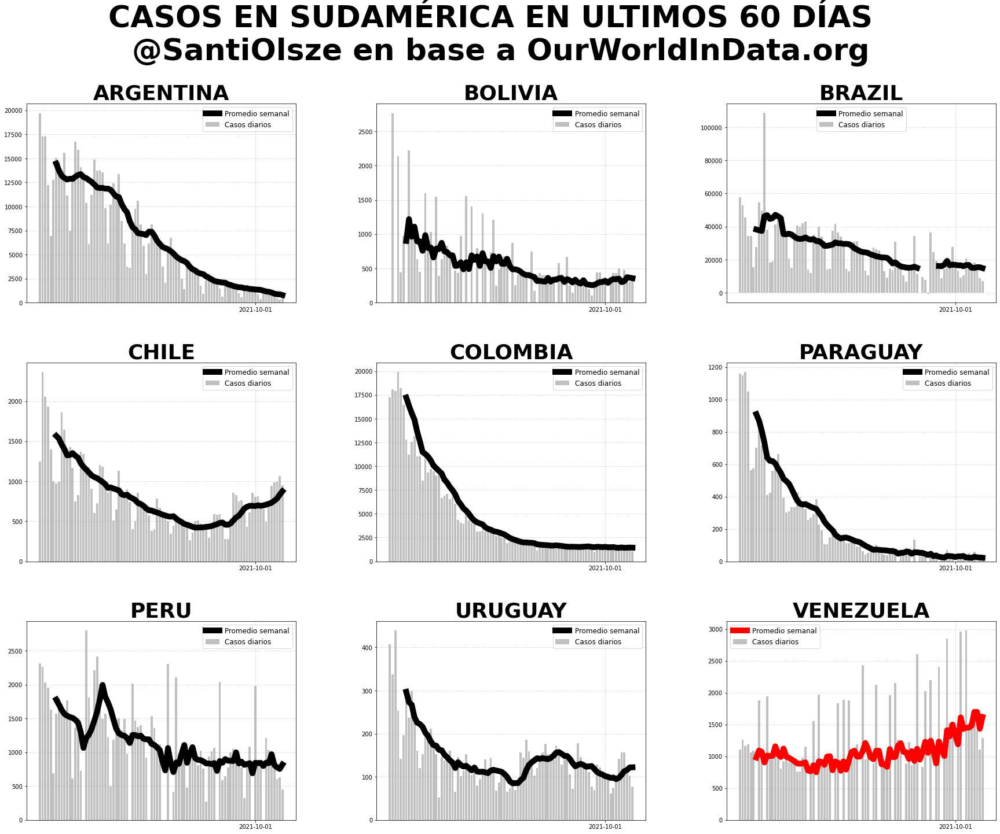

In [37]:
nrow = 3
ncol = 3

axises = []
for a in range(0,nrow):
    for b in range(0,ncol):
        tup = a,b
        axises.append(tup)
axis = axises
fig, axs = plt.subplots(nrow, ncol, figsize =(30,20))
fig.suptitle("COVID AMÉRICA DEL SUR ULT. 60 DÍAS", fontsize = 28, fontweight = "bold")
fig.suptitle("CASOS EN SUDAMÉRICA EN ULTIMOS 60 DÍAS \n @SantiOlsze en base a OurWorldInData.org", fontsize = 52, fontweight = "bold")

barrios = list(set(OWID[OWID.continent == "South America"].location))
barrios.sort()
barrios = [i for i in barrios if i not in ["Guyana","Suriname","Ecuador", "Falkland Islands"]]

for z,barrio in enumerate(barrios):
    days = 90
    df = OWID[OWID.location == barrio][-days:]
    axs[axis[z]].bar(df.datetime, df.new_cases,color =  "grey", label = "Casos diarios", linewidth = 1, alpha = .5)
    media_movil = df.new_cases.rolling(window = 7).mean()
    
    if np.nanmax(media_movil) in list(media_movil[-15:]):
        c = "red"
    elif np.nanmax(media_movil) in list(media_movil[-30:]):
        c = "goldenrod"
    else:
        c = "k"
        
    axs[axis[z]].plot(df.datetime, media_movil,color =  c, label = "Promedio semanal", linewidth = 10, alpha = 1)
    axs[axis[z]].set_title(barrio.upper(), fontweight = "bold",fontsize = 36)
    
    axs[axis[z]].set_xticks([i for i in df.datetime[:-2] if i.day == 1 and i.month >= 10])
    if z < 100:
        axs[axis[z]].legend(fontsize = 12) 
    axs[axis[z]].grid(ls = ":")

fig.subplots_adjust(wspace = 0.3, hspace = 0.3, bottom = 0, top = .86)
plt.savefig("latam", bbox_inches = "tight")

In [38]:
world = OWID[~(OWID.location.isin(["Asia","South America","North America","Africa","Europe","World"]))].groupby("datetime", as_index= False).sum()
world["Muertes_movil"] = world.new_deaths.rolling(window = 7, center = False).mean()

In [39]:
# REVISAR QUE NO SUME LOS CONTINENTES

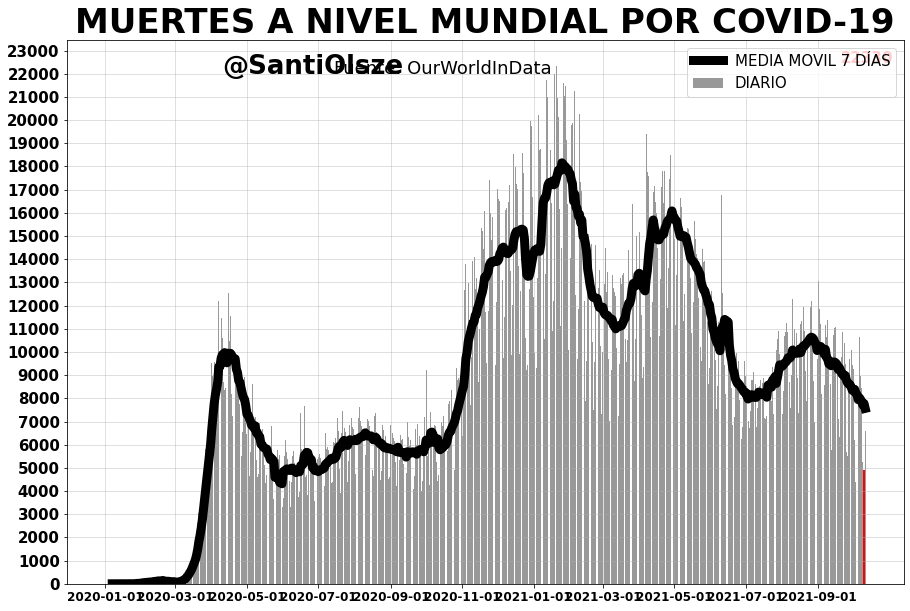

In [40]:
ylim = 22000
plt.figure(figsize = (15,10))
plt.bar(world.datetime, world.new_deaths, color = "gray", alpha =0.8, label = "DIARIO")
plt.plot(world.datetime, world.new_deaths.rolling(window = 7, center = False).mean(),
         color = "k", alpha = 1, linewidth = 9, label = "MEDIA MOVIL 7 DÍAS")
plt.legend(fontsize = 15)
plt.text(x=world.datetime[100], y = ylim, s = "@SantiOlsze",fontsize = 26, fontweight = "bold")
plt.text(x=world.datetime[195], y = ylim, s = "Fuente: OurWorldInData",fontsize = 18)
plt.title("MUERTES A NIVEL MUNDIAL POR COVID-19", fontsize = 34, fontweight = "bold")
plt.grid(alpha= 0.5)
plt.xticks([i for i in world.datetime if i.day == 1 and i.month%2 != 0],fontsize = 12, fontweight = "bold")
plt.yticks(np.linspace(0,25000,26),fontsize = 15, fontweight = "bold")
plt.text(x = datetime.datetime.today(), y = max(world.new_deaths)+150, s = str(int(max(world.new_deaths))), ha = "center", fontsize = 15, fontweight = "bold", color = "red")

plt.bar(world.datetime[-2:-1], world.new_deaths[-2:-1], color = "red", width = 1.99 )
plt.savefig("ww_deaths", bbox_inches = "tight");

In [41]:
world.sort_values("new_deaths",ascending = False).head(10)

,datetime,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million,Muertes_movil
385,2021-01-20,115288469.0,869429.0,779102.573,2578329.0,22330.0,17434.575,3580212.631,26904.390,24172.668,...,4574.4,4715.599,498.178,14105.98,133.022,0.0,0.0,0.0,0.0,17434.571429
384,2021-01-19,114419040.0,732813.0,786648.863,2555999.0,21969.0,17245.147,3553308.242,25321.029,24790.528,...,4574.4,4715.599,498.178,14105.98,133.022,0.0,0.0,0.0,0.0,17245.142857
377,2021-01-12,108912498.0,850261.0,886724.431,2435283.0,21720.0,16855.722,3379774.579,27960.532,28349.282,...,4574.4,4715.599,498.178,14105.98,133.022,0.0,0.0,0.0,0.0,16855.714286
391,2021-01-26,119424064.0,683158.0,715003.425,2682723.0,21592.0,18103.434,3713943.482,22491.864,22947.888,...,4574.4,4715.599,498.178,14255.26,133.642,0.0,0.0,0.0,0.0,18103.428571
393,2021-01-28,120944288.0,760633.0,692962.571,2725244.0,21472.0,17994.001,3766020.394,24562.384,22615.237,...,4574.4,4715.599,498.178,14326.96,133.642,0.0,0.0,0.0,0.0,17994.000000
401,2021-02-05,125801011.0,679244.0,589248.430,2862008.0,21269.0,16800.714,3936699.299,22253.744,20905.664,...,4574.4,4715.599,498.178,14725.28,133.642,0.0,0.0,0.0,0.0,16800.714286
392,2021-01-27,120183655.0,759591.0,699312.288,2703772.0,21049.0,17920.433,3741458.008,27514.533,23035.049,...,4574.4,4715.599,498.178,14326.96,133.642,0.0,0.0,0.0,0.0,17920.428571
378,2021-01-13,109834751.0,922253.0,883183.864,2456287.0,21004.0,17184.862,3411003.979,31229.401,27872.951,...,4574.4,4715.599,498.178,14105.98,133.022,0.0,0.0,0.0,0.0,17184.857143
386,2021-01-21,116093550.0,805081.0,762093.715,2599286.0,20957.0,17633.006,3607713.740,27501.103,24032.069,...,4574.4,4715.599,498.178,14255.26,133.642,0.0,0.0,0.0,0.0,17633.000000
405,2021-02-09,127646119.0,518284.0,537106.285,2916287.0,20261.0,15938.143,4008507.751,19206.460,19985.777,...,4574.4,4715.599,498.178,14965.12,133.642,0.0,0.0,0.0,0.0,15938.142857


In [42]:


country = "Germany"
pais_esp = "ALEMANIA"


In [43]:
def casos_muertes_hosp(country, pais_esp, ylim1 = 0, ylim2 = 1000):
    
    pais = OWID[OWID.location == country]
    pais = pais[pais.datetime >= pd.to_datetime("2020-03-01")]

    fig, axs = plt.subplots(3, sharex=True, sharey=False, figsize = (20,20))
    fig.subplots_adjust(wspace = 0.3, hspace = 0.3, bottom = 0, top = 0.87)

    fig.suptitle("CORONAVIRUS EN "+pais_esp+" \n @SantiOlsze en base a OurWorldInData.org" ,fontsize = 46, fontweight = "bold")
    axs[0].bar(pais.datetime, pais.new_cases, color = "grey", alpha = 0.5)
    axs[0].plot(pais.datetime, pais.new_cases.rolling(window = 7, center = True).mean(), color = "k", linewidth = 7)
    axs[0].set_title("CASOS" ,fontsize = 40, fontweight = "bold")
    axs[0].grid(alpha = 0.5)
    axs[0].tick_params(axis='both', which='major', labelsize=18)
    axs[1].bar(pais.datetime, pais.new_deaths, color = "red", alpha = 0.5)
    axs[1].plot(pais.datetime, pais.new_deaths.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "red")
    axs[1].set_ylim(ylim1,ylim2)
    axs[1].set_title("FALLECIDOS" ,fontsize = 40, fontweight = "bold")
    axs[1].grid(alpha = 0.5)
    axs[1].tick_params(axis='both', which='major', labelsize=18)
    axs[2].bar(pais.datetime, pais.icu_patients, color = "blue", alpha = 0.5)
    axs[2].plot(pais.datetime, pais.icu_patients.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkblue")
    axs[2].set_title("HOSPITALIZACIONES" ,fontsize = 40, fontweight = "bold")
    axs[2].tick_params(axis='both', which='major', labelsize=18)
    plt.grid(alpha = 0.5)
    plt.savefig(pais_esp, bbox_inches = "tight")

In [44]:
def casos_muertes(country, pais_esp, ylim1 = 0, ylim2 = 1000):
    
    pais = OWID[OWID.location == country]
    pais = pais[pais.datetime >= pd.to_datetime("2020-03-01")]

    fig, axs = plt.subplots(2, sharex=True, sharey=False, figsize = (20,10))
    fig.subplots_adjust(wspace = 0.3, hspace = 0.3, bottom = 0, top = 0.8)

    fig.suptitle("CORONAVIRUS EN "+pais_esp+" \n @SantiOlsze en base a OurWorldInData.org" ,fontsize = 40, fontweight = "bold")
    axs[0].bar(pais.datetime, pais.new_cases, color = "grey", alpha = 0.5)
    axs[0].plot(pais.datetime, pais.new_cases.rolling(window = 7, center = True).mean(), color = "k", linewidth = 7)
    axs[0].set_title("CASOS" ,fontsize = 40, fontweight = "bold")
    axs[0].grid(alpha = 0.5)
    axs[0].tick_params(axis='both', which='major', labelsize=18)
    axs[1].bar(pais.datetime, pais.new_deaths, color = "red", alpha = 0.5)
    axs[1].plot(pais.datetime, pais.new_deaths.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "red")
    axs[1].set_ylim(ylim1,ylim2)
    axs[1].set_title("FALLECIDOS" ,fontsize = 40, fontweight = "bold")
    axs[1].grid(alpha = 0.5)
    axs[1].tick_params(axis='both', which='major', labelsize=18)
    axs[1].grid(alpha = 0.5)
    plt.grid()
    plt.savefig(pais_esp, bbox_inches = "tight")

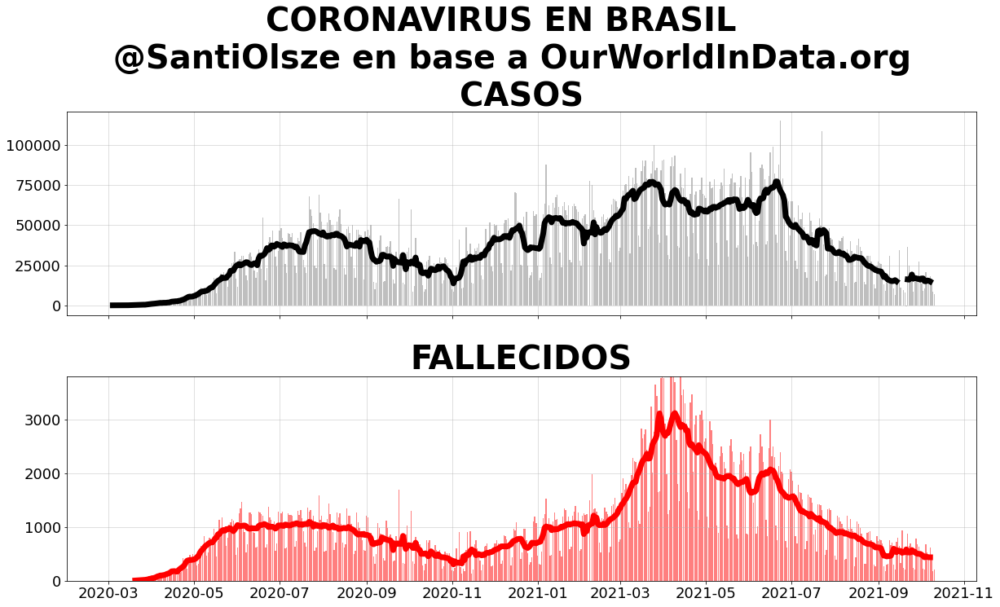

In [45]:
country = "Brazil"
pais_esp = "BRASIL"
casos_muertes(country, pais_esp, ylim1 = 0, ylim2 = 3800)


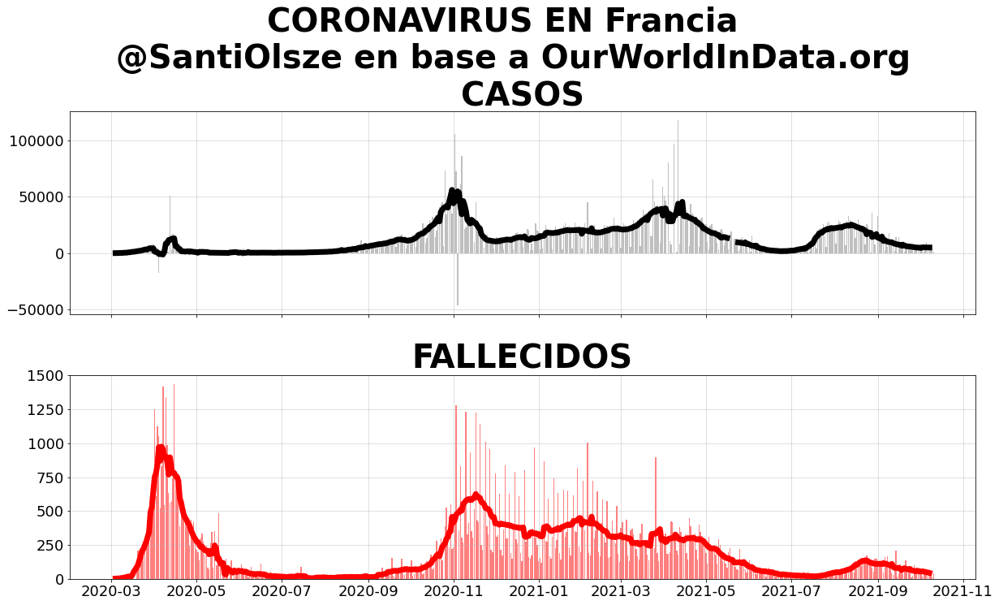

In [46]:
country = "France"
pais_esp = "Francia"
casos_muertes(country, pais_esp, ylim1 = 0, ylim2 = 1500)

In [47]:
def casos_muertes_hosp_test(country, pais_esp, ylim1 = 0, ylim2 = 1000):
    
    pais = OWID[OWID.location == country]
    pais = pais[pais.datetime >= pd.to_datetime("2020-03-01")]

    fig, axs = plt.subplots(4, sharex=True, sharey=False, figsize = (20,20))
    fig.subplots_adjust(wspace = 0.3, hspace = 0.3, bottom = 0, top = 0.87)

    fig.suptitle("CORONAVIRUS EN "+pais_esp+" \n @SantiOlsze en base a OurWorldInData.org" ,fontsize = 46, fontweight = "bold")
    axs[0].bar(pais.datetime, pais.new_cases, color = "grey", alpha = 0.5)
    axs[0].plot(pais.datetime, pais.new_cases.rolling(window = 7, center = True).mean(), color = "k", linewidth = 7)
    axs[0].set_title("CASOS" ,fontsize = 40, fontweight = "bold")
    axs[0].grid(alpha = 0.5)
    axs[0].tick_params(axis='both', which='major', labelsize=18)
    axs[1].bar(pais.datetime, pais.new_deaths, color = "red", alpha = 0.5)
    axs[1].plot(pais.datetime, pais.new_deaths.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "red")
    axs[1].set_ylim(ylim1,ylim2)
    axs[1].set_title("FALLECIDOS" ,fontsize = 40, fontweight = "bold")
    axs[1].grid(alpha = 0.5)
    axs[1].tick_params(axis='both', which='major', labelsize=18)
    axs[2].bar(pais.datetime, pais.icu_patients, color = "blue", alpha = 0.5)
    axs[2].plot(pais.datetime, pais.icu_patients.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkblue")
    axs[2].set_title("HOSPITALIZACIONES" ,fontsize = 40, fontweight = "bold")
    axs[2].tick_params(axis='both', which='major', labelsize=18)
    axs[2].grid(alpha = 0.5)

    axs[3].bar(pais.datetime, pais.new_tests, color = "green", alpha = 0.5)
    axs[3].plot(pais.datetime, pais.new_tests.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkgreen")
    axs[3].set_title("TESTS" ,fontsize = 40, fontweight = "bold")
    axs[3].tick_params(axis='both', which='major', labelsize=18)
    axs[3].grid(alpha = 0.5)

    axs[3].yaxis.get_major_formatter().set_scientific(False)
    plt.savefig(pais_esp, bbox_inches = "tight")

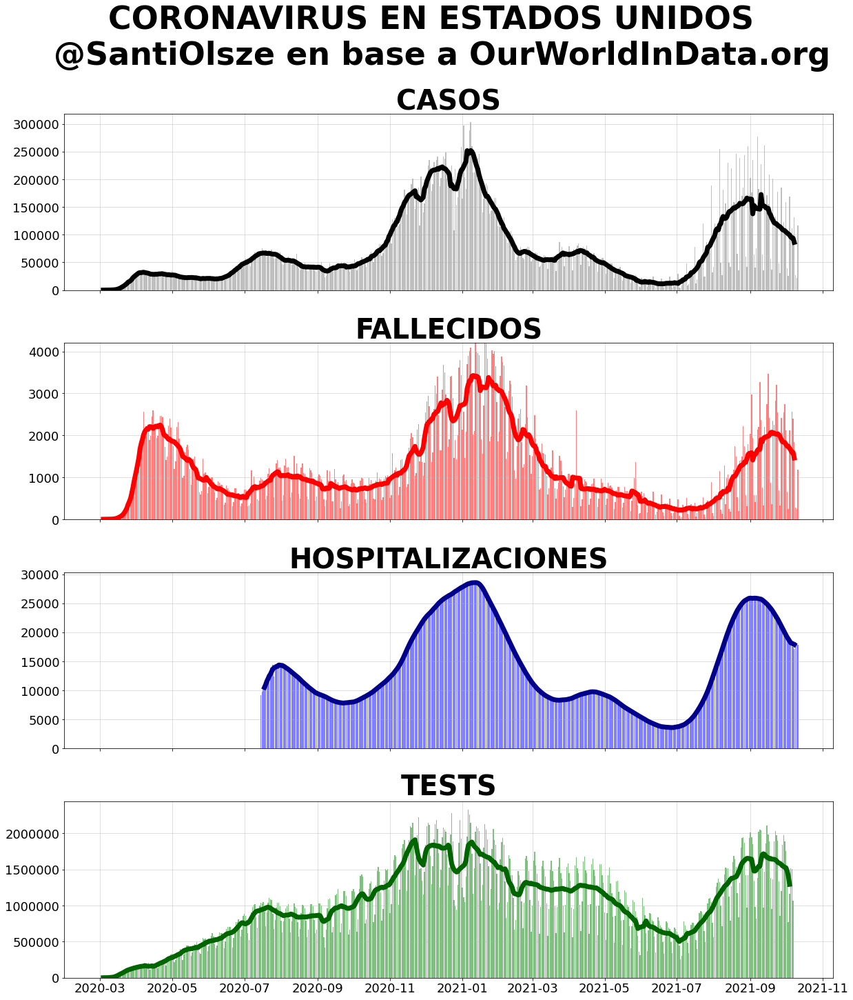

In [48]:
country = "United States"
pais_esp = "ESTADOS UNIDOS"
casos_muertes_hosp_test(country, pais_esp, ylim1 = 0, ylim2 = 4200)

In [7]:
def casos_muertes_hosp_test_pos(country, pais_esp, ylim1 = 0, ylim2 = 1000):
    
    pais = OWID[OWID.location == country]
    pais = pais[pais.datetime >= pd.to_datetime("2020-03-01")]

    fig, axs = plt.subplots(5, sharex=True, sharey=False, figsize = (20,20))
    fig.subplots_adjust(wspace = 0.3, hspace = 0.3, bottom = 0, top = 0.87)

    fig.suptitle("CORONAVIRUS EN "+pais_esp+" \n @SantiOlsze en base a OurWorldInData.org" ,fontsize = 46, fontweight = "bold")
    axs[0].bar(pais.datetime, pais.new_cases, color = "grey", alpha = 0.5)
    axs[0].plot(pais.datetime, pais.new_cases.rolling(window = 7, center = True).mean(), color = "k", linewidth = 7)
    axs[0].set_title("CASOS" ,fontsize = 40, fontweight = "bold")
    axs[0].grid(alpha = 0.5)
    axs[0].tick_params(axis='both', which='major', labelsize=18)
    
    
    axs[1].bar(pais.datetime, pais.new_deaths, color = "red", alpha = 0.5)
    axs[1].plot(pais.datetime, pais.new_deaths.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "red")
    axs[1].set_ylim(ylim1,ylim2)
    axs[1].set_title("FALLECIDOS" ,fontsize = 40, fontweight = "bold")
    axs[1].grid(alpha = 0.5)
    axs[1].tick_params(axis='both', which='major', labelsize=18)
    
    axs[2].bar(pais.datetime, pais.icu_patients, color = "blue", alpha = 0.5)
    axs[2].plot(pais.datetime, pais.icu_patients.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkblue")
    axs[2].set_title("HOSPITALIZACIONES" ,fontsize = 40, fontweight = "bold")
    axs[2].tick_params(axis='both', which='major', labelsize=18)
    axs[2].grid(alpha = 0.5)


    axs[3].bar(pais.datetime, pais.new_tests, color = "green", alpha = 0.5)
    axs[3].plot(pais.datetime, pais.new_tests.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkgreen")
    axs[3].set_title("TESTS" ,fontsize = 40, fontweight = "bold")
    axs[3].tick_params(axis='both', which='major', labelsize=18)
    axs[3].grid(alpha = 0.5)
    axs[3].yaxis.get_major_formatter().set_scientific(False)
    
    axs[4].bar(pais.datetime, ((pais.new_cases/pais.new_tests)*100), color = "goldenrod", alpha = 0.5)
    axs[4].plot(pais.datetime, ((pais.new_cases/pais.new_tests)*100).rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkgoldenrod")
    axs[4].set_title("POSITIVIDAD" ,fontsize = 40, fontweight = "bold")
    axs[4].tick_params(axis='both', which='major', labelsize=18)
    axs[4].grid(alpha = 0.5)
    axs[4].yaxis.get_major_formatter().set_scientific(False)
    
    plt.savefig(pais_esp, bbox_inches = "tight")

In [19]:
OWID.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'new_tests', 'total_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [73]:
def casos_muertes_hosp_test_pos_vac(country, pais_esp, ylim1 = 0, ylim2 = 1000, DELTA_50 = False,OMICRON_50 = False):
    
    variantes = pd.read_csv("/home/santiago/Downloads/covid-variants-area.csv")
    var = variantes[variantes.Delta > 50][["Entity","Day"]].groupby("Entity", as_index = False).min()
    var2 = variantes[variantes.Omicron > 50][["Entity","Day"]].groupby("Entity", as_index = False).min()  
    pais = OWID[OWID.location == country]
    pais = pais[pais.datetime >= pd.to_datetime("2020-03-01")]
    
    pais["boosted"] = pais["total_boosters"]*100 / pais["population"] 
    pais["fully"] = pais["people_fully_vaccinated_per_hundred"]
    pais["partially"] = pais["people_vaccinated_per_hundred"] - pais["fully"]
    
    fig, axs = plt.subplots(6, sharex=True, sharey=False, figsize = (20,30))
    fig.subplots_adjust(wspace = 0.3, hspace = 0.3, bottom = 0, top = 0.90)

    fig.suptitle("CORONAVIRUS EN "+pais_esp+f" al {datetime.datetime.today().strftime('%d-%b').upper()} \n @SantiOlsze en base a OurWorldInData.org" ,fontsize = 46, fontweight = "bold")
    axs[0].fill_between(pais.datetime, pais.new_cases, color = "grey", alpha = 0.5)
    axs[0].plot(pais.datetime, pais.new_cases.rolling(window = 7, center = True).mean(), color = "k", linewidth = 7)
    axs[0].set_title("CASOS DIARIOS" ,fontsize = 40, fontweight = "bold")
    axs[0].grid(alpha = 0.5)
    axs[0].tick_params(axis='both', which='major', labelsize=18)
    axs[0].set_ylim(0,pais.new_cases.rolling(window = 7, center = True).mean().max()*1.2)
    
    axs[1].fill_between(pais.datetime, pais.icu_patients, color = "blue", alpha = 0.5)
    axs[1].plot(pais.datetime, pais.icu_patients.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkblue")
    axs[1].set_title("HOSPITALIZACIONES UTI DIARIAS" ,fontsize = 40, fontweight = "bold")
    axs[1].tick_params(axis='both', which='major', labelsize=18)
    axs[1].grid(alpha = 0.5)

    
    axs[2].fill_between(pais.datetime, pais.new_deaths, color = "red", alpha = 0.5)
    axs[2].plot(pais.datetime, pais.new_deaths.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "red")
    axs[2].set_ylim(ylim1,ylim2)
    axs[2].set_title("FALLECIDOS DIARIOS" ,fontsize = 40, fontweight = "bold")
    axs[2].grid(alpha = 0.5)
    axs[2].tick_params(axis='both', which='major', labelsize=18)
    

    axs[3].fill_between(pais.datetime, pais.people_vaccinated_per_hundred, color = "violet", alpha = 0.5)
    axs[3].plot(pais.datetime, pais.people_vaccinated_per_hundred.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "indigo")
    axs[3].fill_between(pais.datetime, pais.fully, color = "purple", alpha = 0.5)
    axs[3].plot(pais.datetime, pais.fully.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "indigo")
    
    axs[3].fill_between(pais.datetime, pais.boosted, color = "purple", alpha = 1)
    axs[3].plot(pais.datetime, pais.boosted.rolling(window = 1, center = True).mean(),  linewidth = 7, color = "indigo")
    
    
    
    axs[3].set_title("VACUNADOS (%)" ,fontsize = 40, fontweight = "bold")
    
    axs[3].tick_params(axis='both', which='major', labelsize=18)
    axs[3].text(x = pd.to_datetime("2020-12-01"), y = 52, color = "violet", fontsize = 16, alpha = 0.8, s = "Una dosis")
    axs[3].text(x = pd.to_datetime("2020-12-01"), y = 47, color = "purple", fontsize = 16, alpha = 0.8, s = "Esquema completo")
    axs[3].text(x = pd.to_datetime("2020-12-01"), y = 40, color = "purple", fontsize = 16, alpha = 1, s = "Con refuerzo")

    axs[3].grid(alpha = 0.5)
    axs[3].yaxis.get_major_formatter().set_scientific(False)
    axs[3].set_ylim(0,100)    

    
    axs[4].fill_between(pais.datetime, pais.new_tests, color = "green", alpha = 0.5)
    axs[4].plot(pais.datetime, pais.new_tests.rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkgreen")
    axs[4].set_title("TESTS DIARIOS" ,fontsize = 40, fontweight = "bold")
    axs[4].tick_params(axis='both', which='major', labelsize=18)
    axs[4].grid(alpha = 0.5)
    axs[4].yaxis.get_major_formatter().set_scientific(False)
    
    axs[5].fill_between(pais.datetime, ((pais.new_cases/pais.new_tests)*100), color = "goldenrod", alpha = 0.5)
    axs[5].plot(pais.datetime, ((pais.new_cases/pais.new_tests)*100).rolling(window = 7, center = True).mean(),  linewidth = 7, color = "darkgoldenrod")
    axs[5].set_title("POSITIVIDAD DIARIA (%)" ,fontsize = 40, fontweight = "bold")
    axs[5].tick_params(axis='both', which='major', labelsize=18)
    axs[5].grid(alpha = 0.5)
    axs[5].yaxis.get_major_formatter().set_scientific(False)


    if DELTA_50 and country in set(var.Entity):
        f = var[var.Entity == country].Day
        for ax in axs: 
                ax.axvline(pd.to_datetime(f), linewidth = 3, color = "k", ls = "--", alpha = .8)
                props = dict(boxstyle='round', facecolor='lavender', alpha=1, edgecolor = "k")
                axs[0].text(pd.to_datetime(f), axs[0].get_ylim()[1]*0.7, s = "Delta >50%", 
                        fontweight = "bold", bbox = props, va = "center", ha = "center", fontsize = 15)

    if OMICRON_50 and country in set(var.Entity):
        f = var2[var2.Entity == country].Day
        for ax in axs: 
                ax.axvline(pd.to_datetime(f), linewidth = 3, color = "k", ls = "--", alpha = .8)
                props = dict(boxstyle='round', facecolor='lavender', alpha=1, edgecolor = "k")
                axs[0].text(pd.to_datetime(f), axs[0].get_ylim()[1]*0.6, s = "Omicron >50%", 
                        fontweight = "bold", bbox = props, va = "center", ha = "center", fontsize = 15)
    #or ax in axs:
    #    ax.set_facecolor('xkcd:salmon')
    plt.savefig(pais_esp, bbox_inches = "tight")

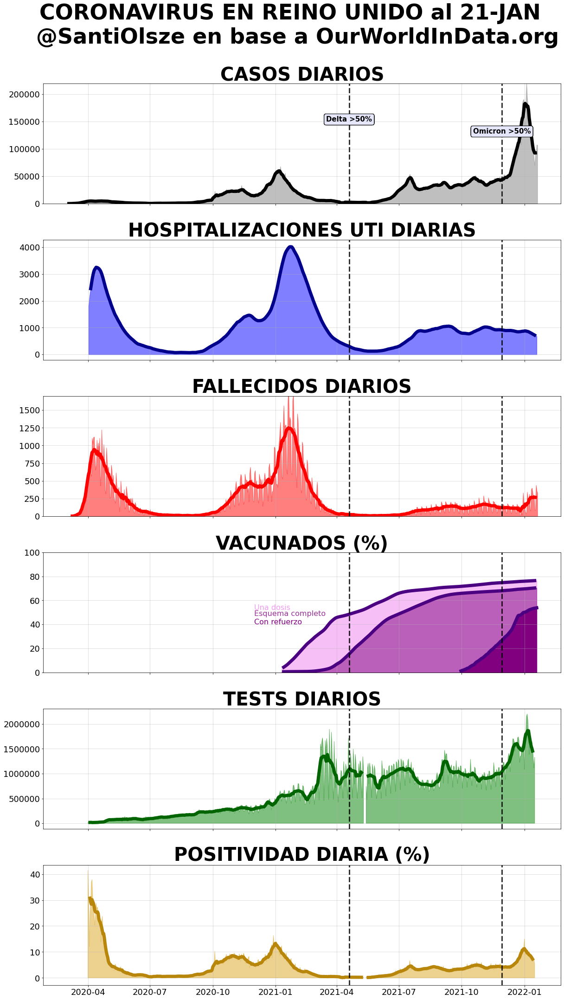

In [74]:
country = "United Kingdom"
pais_esp = "REINO UNIDO"
casos_muertes_hosp_test_pos_vac(country, pais_esp, ylim1 = 0, ylim2 = 1700, DELTA_50 = True, OMICRON_50 = True)

ValueError: shape mismatch: objects cannot be broadcast to a single shape

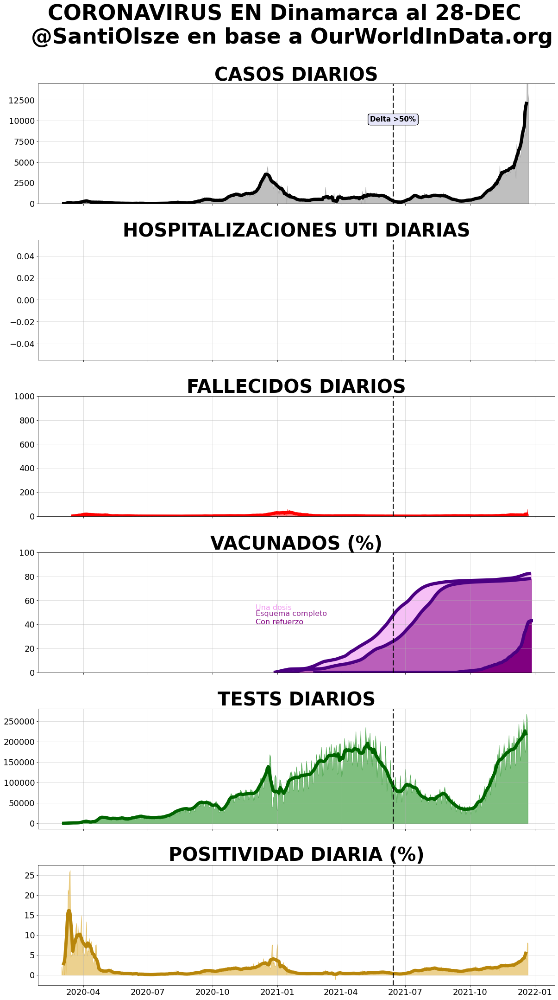

In [10]:
country = "Denmark"
pais_esp = "Dinamarca"
casos_muertes_hosp_test_pos_vac(country, pais_esp, ylim1 = 0, ylim2 = 1000, DELTA_50 = True, OMICRON_50 = True)

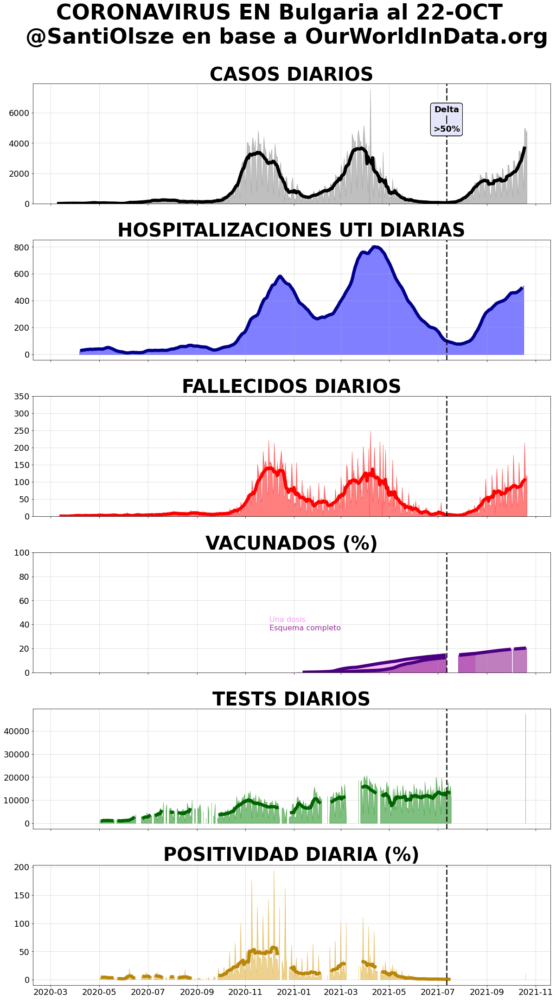

In [18]:
country = "Bulgaria"
pais_esp = "Bulgaria"
casos_muertes_hosp_test_pos_vac(country, pais_esp, ylim1 = 0, ylim2 = 350, DELTA_50 = True)

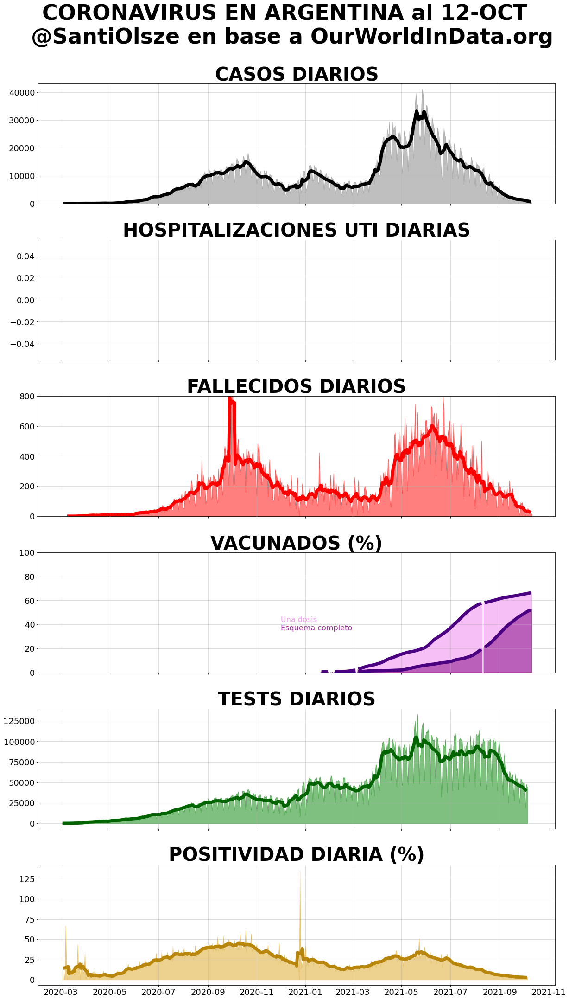

In [54]:
country = "Argentina"
pais_esp = "ARGENTINA"
casos_muertes_hosp_test_pos_vac(country, pais_esp, ylim1 = 0, ylim2 = 800, DELTA_50 = False)

In [28]:
len(OWID[(OWID.location == "United Kingdom")
    & (OWID.datetime >= pd.to_datetime("2021-05-31"))][["datetime","new_deaths"]])

148

In [22]:
variantes[(variantes.Entity == "United Kingdom") &(variantes.Delta > 50)]

,Entity,Code,Day,Beta,Epsilon,Gamma,Kappa,Iota,Eta,Delta,Alpha,non_who,Lambda,Year,Mu
3697,United Kingdom,GBR,2021-05-31,0.11,0.0,0.09,0.13,0.0,0.03,73.26,25.95,0.42,0.0,111,0.0
3698,United Kingdom,GBR,2021-06-14,0.08,0.0,0.04,0.01,0.0,0.00,90.35,9.27,0.25,0.0,111,0.0
3699,United Kingdom,GBR,2021-06-28,0.01,0.0,0.01,0.00,0.0,0.00,98.10,1.67,0.19,0.0,111,0.0
3700,United Kingdom,GBR,2021-07-12,0.00,0.0,0.01,0.00,0.0,0.00,99.28,0.60,0.04,0.0,111,0.0
3701,United Kingdom,GBR,2021-07-26,0.01,0.0,0.02,0.00,0.0,0.00,99.68,0.22,0.04,0.0,111,0.0
3702,United Kingdom,GBR,2021-08-09,0.01,0.0,0.01,0.00,0.0,0.00,99.73,0.22,0.02,0.0,111,0.0
3703,United Kingdom,GBR,2021-08-23,0.00,0.0,0.00,0.00,0.0,0.00,99.95,0.02,0.03,0.0,111,0.0
3704,United Kingdom,GBR,2021-09-06,0.00,0.0,0.00,0.00,0.0,0.00,99.94,0.03,0.03,0.0,111,0.0
3705,United Kingdom,GBR,2021-09-20,0.00,0.0,0.00,0.00,0.0,0.00,99.98,0.02,0.00,0.0,111,0.0
3706,United Kingdom,GBR,2021-10-04,0.00,0.0,0.00,0.00,0.0,0.00,99.95,0.01,0.04,0.0,111,0.0


# VACUNAS
# VACUNAS
# VACUNAS
# VACUNAS


In [47]:
vac = OWID[~pd.isnull(OWID.total_vaccinations_per_hundred)][["location","total_vaccinations_per_hundred","gdp_per_capita","datetime","population","continent"]].groupby("location", as_index = False).max().sort_values("total_vaccinations_per_hundred")
vac = vac[vac.total_vaccinations_per_hundred > 0]
vac = vac[vac.location != "World"]
vac = vac[vac.location != "European Union"]
vac = vac[vac.location != "Europe"]
vac = vac[vac.location != "North America"]
vac = vac[vac.location != "South America"]
vac = vac[vac.location != "Asia"]
vac = vac[vac.location != "Africa"]
vac = vac[vac.location != "Oceania"]

vac = vac[~vac.location.str.upper().isin(["WORLD","AFRICA","SOUTH AMERICA","ASIA","NORTH AMERICA","EUROPE","EUROPEAN UNION",
                              "OCEANIA", "LOWER MIDDLE INCOME","UPPER MIDDLE INCOME","HIGH INCOME", "LOW INCOME"])]


#vac = vac[vac.population > 3000000]
vac["total_vaccinations"] = (vac.total_vaccinations_per_hundred * vac.population / 100).round()
vac = vac.reset_index()

In [48]:
vac.sort_values("total_vaccinations",ascending = False, inplace = True)

In [49]:
vac.head()

,index,location,total_vaccinations_per_hundred,gdp_per_capita,datetime,population,continent,total_vaccinations
200,43,China,205.52,15308.712,2022-01-23,1.444216e+09,Asia,2.968153e+09
107,95,India,116.42,6426.674,2022-01-23,1.393409e+09,Asia,1.622207e+09
157,219,United States,161.02,54225.446,2022-01-23,3.329151e+08,North America,5.360599e+08
166,29,Brazil,164.94,14103.452,2022-01-23,2.139934e+08,South America,3.529608e+08
102,96,Indonesia,110.44,11188.744,2022-01-23,2.763618e+08,Asia,3.052140e+08


In [50]:
vac
vac['cum_sum'] = vac['total_vaccinations'].cumsum()
vac['cum_perc'] = 100*vac['cum_sum']/vac['total_vaccinations'].sum()
vac["location"] = vac.location.str.upper()

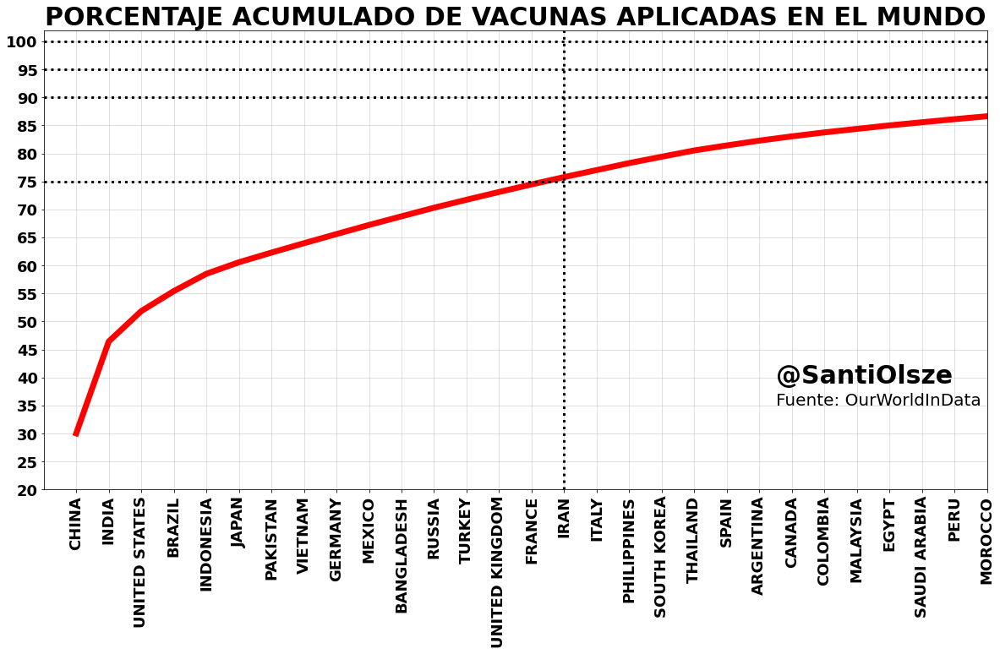

In [51]:
plt.figure(figsize = (20,10))
i = 29
plt.plot(vac.location[:i], vac.cum_perc[:i], linewidth = 7, color = "red")
plt.axhline(75, color = "k", linewidth = 3, ls = ":")
plt.axhline(90, color = "k", linewidth = 3, ls = ":")
plt.axhline(95, color = "k", linewidth = 3, ls = ":")
plt.axhline(100, color = "k", linewidth = 3, ls = ":")


plt.axvline(vac[vac['cum_perc'] > 75].head(1).location.item(), color = "k", linewidth = 3, ls = ":")
plt.axvline(vac[vac['cum_perc'] > 90].head(1).location.item(), color = "k", linewidth = 3, ls = ":")
plt.axvline(vac[vac['cum_perc'] > 95].head(1).location.item(), color = "k", linewidth = 3, ls = ":")
plt.axvline(vac[vac['cum_perc'] <= 100].tail(1).location.item(), color = "k", linewidth = 3, ls = ":")

plt.text(y=39, x = i-7.5, s = "@SantiOlsze",fontsize = 30, fontweight = "bold")
plt.text(y=35, x = i-7.5, s = "Fuente: OurWorldInData",fontsize = 20)

plt.title("PORCENTAJE ACUMULADO DE VACUNAS APLICADAS EN EL MUNDO", fontweight = "bold", fontsize = 30)
plt.ylim(20,102)
plt.xlim(-1,i-1)
plt.yticks(np.linspace(20,100,17),fontweight = "bold", fontsize = 18)
plt.xticks(rotation = 90, fontweight = "bold", fontsize = 18)
plt.grid(alpha = 0.5)
plt.savefig("vac_acumulado_mundial",bbox_inches = "tight");

In [9]:
vac.head(25)

,index,location,total_vaccinations_per_hundred,gdp_per_capita,datetime,population,continent,total_vaccinations,cum_sum,cum_perc
205,43,CHINA,169.14,15308.712,2021-11-22,1.444216e+09,Asia,2.442747e+09,2.442747e+09,31.566984
98,95,INDIA,84.39,6426.674,2021-11-22,1.393409e+09,Asia,1.175898e+09,3.618645e+09,46.762806
153,219,UNITED STATES,134.59,54225.446,2021-11-22,3.329151e+08,North America,4.480704e+08,4.066715e+09,52.553103
163,29,BRAZIL,139.24,14103.452,2021-11-17,2.139934e+08,South America,2.979645e+08,4.364680e+09,56.403620
93,96,INDONESIA,81.41,11188.744,2021-11-22,2.763618e+08,Asia,2.249861e+08,4.589666e+09,59.311057
189,104,JAPAN,155.51,39002.223,2021-11-21,1.260508e+08,Asia,1.960216e+08,4.785688e+09,61.844193
110,133,MEXICO,100.62,17336.469,2021-11-22,1.302622e+08,North America,1.310698e+08,4.916757e+09,63.537975
71,158,PAKISTAN,53.80,5034.708,2021-11-22,2.251999e+08,Asia,1.211576e+08,5.037915e+09,65.103662
95,170,RUSSIA,82.66,24765.954,2021-11-22,1.459120e+08,Europe,1.206109e+08,5.158526e+09,66.662285
166,211,TURKEY,140.49,25129.341,2021-11-22,8.504274e+07,Asia,1.194765e+08,5.278002e+09,68.206250


In [52]:
pob = OWID[["location","population"]].drop_duplicates()
pob["location"] = pob.location.str.upper()
pob = pob[~pob.location.isin(vac.location)]
pob = pob[~pob.location.isin(["WORLD","AFRICA","SOUTH AMERICA","ASIA","NORTH AMERICA","EUROPE","EUROPEAN UNION",
                              "OCEANIA", "LOWER MIDDLE INCOME","UPPER MIDDLE INCOME","HIGH INCOME", "LOW INCOME"])]

In [53]:
vac = vac.append(pob)

In [54]:
vac["10M"] = vac.population > 10000000

In [55]:
vac[">100%"] = vac.total_vaccinations_per_hundred > 99

In [56]:
vac.groupby(["10M",">100%"]).count()[["index"]]

index
10M   >100%       
False False     45
      True      83
True  False     44
      True      47

In [57]:
(77+51)

128

In [58]:
vac["total_vaccinations"] = vac["total_vaccinations"].fillna(0)
vac["population"] = vac["population"].fillna(0)

vac.sort_values("population", ascending = True, inplace = True)
lim = 40
subset = vac.tail(lim).copy()

subset.sort_values("total_vaccinations", ascending = True, inplace = True)
subset["total_rank"] = range(1,len(subset)+1)
subset.sort_values("population", ascending = True, inplace = True)
subset["pop_rank"] = range(1,len(subset)+1)
subset.location = [i.replace("DEMOCRATIC REPUBLIC", "D.R") for i in subset.location]


In [59]:
subset[subset.total_vaccinations_per_hundred > 99]

,index,location,total_vaccinations_per_hundred,gdp_per_capita,datetime,population,continent,total_vaccinations,cum_sum,cum_perc,10M,>100%,total_rank,pop_rank
131,139.0,MOROCCO,138.35,7485.013,2022-01-18,3.734479e+07,Africa,5.166651e+07,8.565568e+09,86.631332,True,True,15,1
127,166.0,POLAND,133.95,27216.445,2022-01-22,3.779700e+07,Europe,5.062908e+07,8.616197e+09,87.143390,True,True,14,2
194,37.0,CANADA,198.41,44017.591,2022-01-22,3.806791e+07,North America,7.553055e+07,8.210722e+09,83.042455,True,True,18,3
179,8.0,ARGENTINA,186.01,18933.907,2022-01-22,4.560582e+07,South America,8.483139e+07,8.135191e+09,82.278547,True,True,19,9
183,194.0,SPAIN,189.00,34272.360,2022-01-20,4.674521e+07,Europe,8.834845e+07,8.050360e+09,81.420570,True,True,20,10
130,44.0,COLOMBIA,136.13,13254.949,2022-01-21,5.126584e+07,South America,6.978819e+07,8.280510e+09,83.748286,True,True,17,12
210,192.0,SOUTH KOREA,218.51,35938.374,2022-01-23,5.130518e+07,Asia,1.121070e+08,7.851209e+09,79.406380,True,True,22,13
202,102.0,ITALY,205.67,35220.084,2022-01-23,6.036747e+07,Europe,1.241578e+08,7.615740e+09,77.024869,True,True,24,17
195,73.0,FRANCE,198.47,38605.671,2022-01-20,6.742200e+07,Europe,1.338124e+08,7.362943e+09,74.468097,True,True,26,19
197,218.0,UNITED KINGDOM,201.26,39753.244,2022-01-22,6.820711e+07,Europe,1.372736e+08,7.229130e+09,73.114731,True,True,27,20


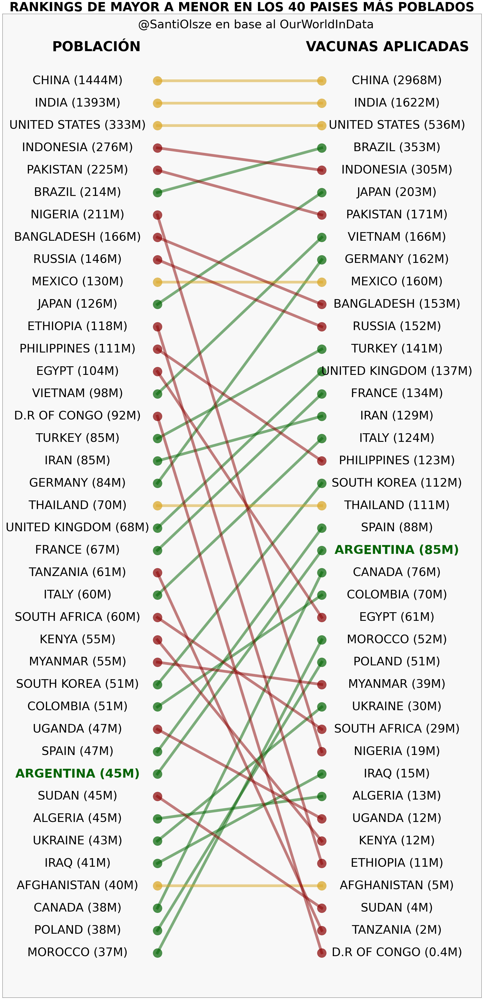

In [60]:
plt.figure(figsize = (38,lim*2))

x = subset.location
dis = dict(zip(x,subset.pop_rank))
dis_val = dict(zip(x,subset.population))
apl = dict(zip(x,subset.total_rank)) 
apl_val = dict(zip(x,subset.total_vaccinations)) 
plt.ylim(-1,lim + 3)
plt.xlim(-1.7,3.4)
for ind,i in enumerate(x):
    if i != "ARGENTINA":
        if dis_val[i] > 1000000:
            texto_dis = i + " ({:.0f}M)".format(dis_val[i]/1000000)
        else:
            texto_dis = i + " ({:.1f}M)".format(dis_val[i]/1000000)
        plt.text(x = -0.9, y = dis[i], s = texto_dis, ha = "center", va = "center", fontsize = 52)#, fontweight = "bold")
        
        if apl_val[i] > 1000000:
            texto_apl = i + " ({:.0f}M)".format(apl_val[i]/1000000)
        else:
            texto_apl = i + " ({:.1f}M)".format(apl_val[i]/1000000)
            
        plt.text(x = 2.5, y = apl[i], s = texto_apl, ha = "center", va = "center", fontsize = 52)#, fontweight = "bold")
    else:
        
        texto_dis = i + " ({}M)".format(int(dis_val[i]/1000000))
        plt.text(x = -0.9, y = dis[i], s = texto_dis, ha = "center", va = "center", fontsize = 54, fontweight = "bold", color = "darkgreen")
        texto_apl = i + " ({:.0f}M)".format(apl_val[i]/1000000)

        plt.text(x = 2.5, y = apl[i], s = texto_apl, ha = "center", va = "center", fontsize = 54, fontweight = "bold", color = "darkgreen")
    color = "goldenrod"
    if dis[i] < apl[i]:
        color = "darkgreen"
    elif dis[i] >apl[i]:
        color = "darkred"

    
    plt.plot([-0.05,1.7],[dis[i],apl[i]], color = color, linewidth = 12, alpha = 0.5)
    plt.plot([-0.05,1.7],[dis[i],apl[i]], color = color, linewidth = 0, alpha = 0.7, ms = 40, marker = "o")

plt.text(x = -0.7, y = lim+1.5 , s = "POBLACIÓN", ha = "center", va = "center", fontsize = 60, fontweight = "bold")
plt.text(x = 2.4, y =lim+1.5 , s = "VACUNAS APLICADAS", ha = "center", va = "center", fontsize = 60, fontweight = "bold")

plt.text(x = 1, y = lim + 2.5, s = "@SantiOlsze en base al OurWorldInData", ha = "center", va = "center", fontsize = 52)


#plt.axis('off')
plt.title("RANKINGS DE MAYOR A MENOR EN LOS {} PAISES MÁS POBLADOS".format(lim), fontsize = 55, fontweight = "bold")

ax = plt.gca()
ax.set_facecolor("lightgray")
ax.patch.set_alpha(0.15)
plt.yticks([], fontsize = 15, fontweight = "bold")
plt.xticks([], fontsize = 15, fontweight = "bold")


plt.savefig("ww_rankings_vacunas", bbox_inches= "tight")

In [61]:
len(vac[vac["10M"] & vac[">100%"]])

47

In [71]:
i  = "ARGENTINA"



<ipython-input-72-8f386eede6a4>:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  vac_subset =  vac_subset[vac.location != "FALKLAND ISLANDS"]


''

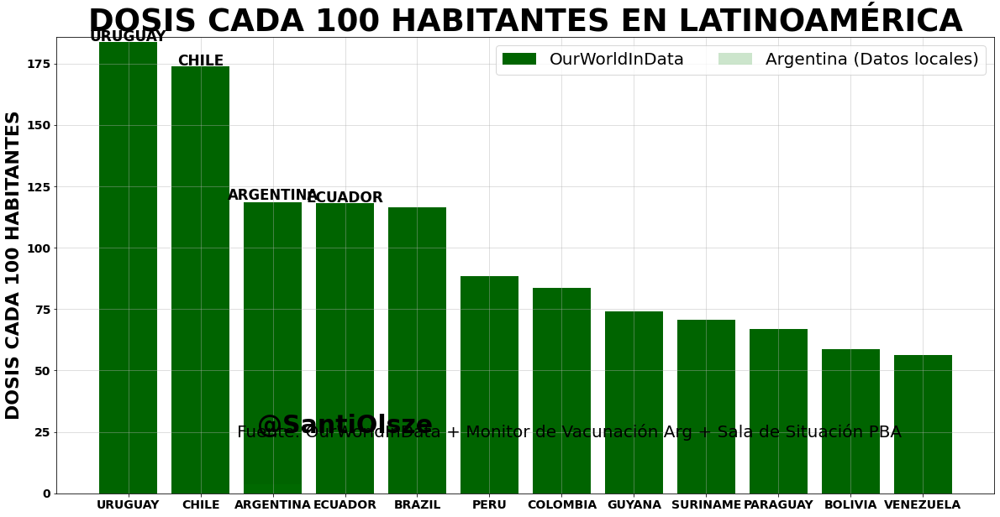

In [72]:
c1 = "darkgreen"
c2 = "g"
vac_subset = vac[vac.continent == "South America"]
vac_subset =  vac_subset[vac.location != "FALKLAND ISLANDS"]
vac_subset.sort_values("total_vaccinations_per_hundred", inplace = True, ascending = False)

plt.figure(figsize = (20,10))
plt.bar(vac_subset.location, vac_subset.total_vaccinations_per_hundred, color =  c1, label = "OurWorldInData")
plt.xticks(fontsize = 14, fontweight = "bold")
plt.grid(":", alpha = 0.5)
plt.text(3,24.45,"@SantiOlsze", fontsize = 30, fontweight = "bold", ha = "center")
plt.text(6.1,22.85,"Fuente: OurWorldInData + Monitor de Vacunación Arg + Sala de Situación PBA", fontsize = 20, ha = "center")
plt.title("DOSIS CADA 100 HABITANTES EN LATINOAMÉRICA", fontweight = "bold", fontsize = 37)
plt.bar("ARGENTINA", 1640227/45195777*100, color = c2, alpha = 0.2, label = "Argentina (Datos locales)")
plt.legend(fontsize = 20, ncol = 2)
plt.yticks(fontsize = 14, fontweight = "bold")
plt.ylabel("DOSIS CADA 100 HABITANTES", fontweight = "bold", fontsize = 22)
plt.ylim(0, max(vac_subset.total_vaccinations_per_hundred)+2)
for i,c in enumerate(vac_subset.location):
    if c == "ARGENTINA":
        plt.text(x = i, y =vac_subset.total_vaccinations_per_hundred.iloc[i]+0.9
             , s = c, ha = "center", fontsize = 16.5, fontweight = "bold")
    elif i < 4:
        plt.text(x = i, y =vac_subset.total_vaccinations_per_hundred.iloc[i]+0.3
             , s = c, ha = "center", fontsize = 17, fontweight = "bold")
;


In [ ]:
plt.figure(figsize = (10,10))
plt.plot(vac_subset.gdp_per_capita, vac_subset.total_vaccinations_per_hundred,"bo")
for i,v in enumerate(vac_subset.total_vaccinations_per_hundred):
    plt.text(x = vac_subset.gdp_per_capita[vac_subset.index[i]]
            ,y = vac_subset.total_vaccinations_per_hundred[vac_subset.index[i]] + 2
            ,s = vac_subset.location[vac_subset.index[i]], va = "center", ha = "center")

In [ ]:
norteam = vac.continent == "North America" 
sudam = vac.continent == "South America" 
vac = vac[norteam | sudam]
vac = vac.reset_index()

In [ ]:
europa = OWID[OWID.continent == "Europe"][["location","datetime","total_deaths_per_million"]].sort_values("location",ascending = False)
europa["location"] = europa["location"].str.upper()
europa = europa[europa.location != "VATICAN"]
europa = europa[europa.location != "MONACO"]
primera = europa[europa.datetime == pd.to_datetime("2020-08-01")]
primera.reset_index(inplace = True)
segunda = europa[europa.datetime == pd.to_datetime("2020-12-22")]
segunda.reset_index(inplace = True)

In [ ]:
fig, ax = plt.subplots(figsize = (10,20))
ax.barh(primera.location, [-1500 for i in range(len(primera.location))], align='center', color = "lightgray", alpha = 0.5)
ax.barh(primera.location, [1500 for i in range(len(primera.location))], align='center', color = "lightgray", alpha = 0.5)

ax.barh(primera.location, primera.total_deaths_per_million*-1, align='center'
        , color = "salmon", label = "   Primera ola\n(hasta 01/08/2020)".upper())
ax.barh(segunda.location, (segunda.total_deaths_per_million-primera.total_deaths_per_million)
        , align='center', color= "deepskyblue", label = "   Segunda ola\n(post 01/08/2020)".upper(), alpha = 0.5)

plt.grid(alpha = 0.9, ls = ":")

for pais in primera.location:
    plt.text(0, pais, s = pais, ha = "center", va = "center", fontsize = 19, fontweight = "bold", color = "k")

plt.text(-600,43.85,"@SantiOlsze", fontsize = 19, fontweight = "bold", ha = "center")
plt.text(600,43.85,"Fuente: OurWorldInData", fontsize = 17, ha = "center")
plt.ylim(-1,47)
ax.set_facecolor("white")
plt.yticks([], fontsize = 15, fontweight = "bold")
plt.xticks(np.linspace(-1500,1500,7),[int(i) for i in abs(np.linspace(-1500,1500,7))], fontsize = 15, fontweight = "bold")
plt.legend(loc = "upper center", ncol = 2 , fontsize = 15,columnspacing = 10)
plt.title("MUERTES POR MILLON DE HABITANTES", fontsize = 25, fontweight = "bold")
plt.xlim(-1200,1200)

plt.savefig("europa_olas", bbox_inches = "tight")

In [ ]:
America = OWID[OWID.continent == "South America"][["location","datetime","total_deaths_per_million"]].sort_values("location",ascending = False)
America["location"] = America["location"].str.upper()
America = America[America.location != "VATICAN"]
America = America[America.location != "MONACO"]
primera = America[America.datetime == pd.to_datetime("2020-12-31")]
primera.reset_index(inplace = True)
segunda = America[America.datetime == pd.to_datetime("2021-08-08")]
segunda.reset_index(inplace = True)

In [ ]:
fig, ax = plt.subplots(figsize = (10,15))
ax.barh(primera.location, [-2000 for i in range(len(primera.location))], align='center', color = "lightgray", alpha = 0.5)
ax.barh(primera.location, [2000 for i in range(len(primera.location))], align='center', color = "lightgray", alpha = 0.5)

ax.barh(primera.location, primera.total_deaths_per_million*-1, align='center'
        , color = "salmon", label = "2020".upper())
ax.barh(segunda.location, (segunda.total_deaths_per_million-primera.total_deaths_per_million)
        , align='center', color= "deepskyblue", label = "2021".upper(), alpha = 0.5)

plt.grid(alpha = 0.9, ls = ":")

for pais in primera.location:
    plt.text(0, pais, s = pais, ha = "center", va = "center", fontsize = 19, fontweight = "bold", color = "k")

plt.text(-600,11.6,"@SantiOlsze", fontsize = 19, fontweight = "bold", ha = "center")
plt.text(600,11.6,"Fuente: OurWorldInData", fontsize = 17, ha = "center")
plt.ylim(-1,12.7)
ax.set_facecolor("white")
plt.yticks([], fontsize = 15, fontweight = "bold")
plt.xticks(np.linspace(-1500,1500,7),[int(i) for i in abs(np.linspace(-1500,1500,7))], fontsize = 15, fontweight = "bold")
plt.legend(loc = "upper center", ncol = 2 , fontsize = 20,columnspacing = 10)
plt.title("MUERTES POR MILLON DE HABITANTES", fontsize = 25, fontweight = "bold")
plt.xlim(-2000,2000)

plt.savefig("latam_olas", bbox_inches = "tight")

In [ ]:
data = pd.read_csv("/home/santiago/Downloads/number-of-estimated-paralytic-polio-cases-by-world-region.csv")

In [ ]:
data.rename(columns = {'Estimated number of paralytic polio cases using reported number of cases after polio free certification (WHO, 2018 and Tebbens et al., 2011)':"Casos"}, inplace=True)
totales = data.groupby("Year", as_index = False).sum()
totales.tail()

In [ ]:
porc = pd.read_csv("/home/santiago/Downloads/polio-vaccine-coverage-of-one-year-olds.csv")
porcentajes = porc.groupby("Year", as_index = False).mean()

In [ ]:
porcentajes.tail()

In [ ]:
fig, ax = plt.subplots(figsize = (15,10))
c = "red"
v = "darkgreen"
ax.plot(totales.Year, totales.Casos, linewidth = 6, color = c, label = "CASOS ESTIMADOS\nDE POLIOMIELITIS" )
ax.set_title("CASOS Y VACUNAS DE POLIOMIELITIS", fontsize = 40, fontweight = "bold")

        
ax.set_ylabel("ESTIMACIÓN DE CASOS", fontsize = 22, fontweight = "bold", color = c)
ax.set_xlabel("AÑO", fontsize = 20, fontweight = "bold", color = "k")



ax.ticklabel_format(style='plain')

ax.tick_params(direction='out', length=12, width=2, colors="k",
               grid_color=c, grid_alpha=0.5)
ax.tick_params(axis='both', which='major', labelsize=15)
ax.tick_params(axis='both', which='minor', labelsize=15)


ax2 = ax.twinx()
ax2.plot(porcentajes.Year, porcentajes["Pol3 (% of one-year-olds immunized)"], linewidth = 6, color = v, label = "PORCENTAJE DE ÑIÑOS\nDE 1 AÑO VACUNADOS")
ax2.set_yticks(np.linspace(0,100,11))
ax2.ticklabel_format(style='plain')

ax2.tick_params(direction='out', length=12, width=2, colors="k",
               grid_color=v, grid_alpha=0.5)
ax2.tick_params(axis='both', which='major', labelsize=15)
ax2.tick_params(axis='both', which='minor', labelsize=15)
ax2.set_ylabel("PORCENTAJE DE NIÑOS <1 AÑO VACUNADOS", fontsize = 22, fontweight = "bold", color = v)
ax2.set_ylim(0,100)

ax.grid(alpha = 0.7, ls = ":")
ax2.grid(alpha = 0.7, ls = ":")
plt.figlegend(loc = "center", fontsize = 20, facecolor = "w", edgecolor = "k")

plt.text(1991,94,"@SantiOlsze", fontsize = 28, fontweight = "bold", ha = "center")
plt.text(2006,94,"Fuente: OurWorldInData + WHO", fontsize = 22, ha = "center")

In [ ]:
1

In [ ]:
datos = pd.read_csv("spv.csv")
datos

In [ ]:
import math

plt.figure(figsize=(20,10))
plt.bar(x = [i - 0.1 for i in range(len(datos))], height = datos.porc_plac, color = "lightgray", label = "Porcentaje de infectados\ntratados con Placebo", width = 0.3)
plt.bar(x = [i + 0.1 for i in range(len(datos))], height = datos.porc_vac, color = "g", label = "Porcentaje de infectados\ntratados con Vacuna",  width = 0.3)
plt.xticks(range(len(datos)), list(datos.Edad[:-1] +  "\nAÑOS") + ["TOTAL"], fontsize = 25, fontweight = "bold")
plt.yticks(fontsize = 15, fontweight = "bold");
for i in datos.index:
    x = i-0.1
    y = datos.iloc[i].porc_plac+0.04
    s = "EFICACIA\n" +  str(round(datos.iloc[i].Eficacia.item(),1)) + "%"
    plt.text(x,y,s, ha = "center", fontweight = "bold", fontsize = 25, color = "darkgreen")
plt.ylim(0,2.2)
plt.grid(":", alpha = 0.5)
plt.legend(loc = "upper left", fontsize = 25)

plt.text(5,2.05,"@SantiOlsze", fontsize = 25, fontweight = "bold", ha = "center")
plt.text(5,1.95,"Fuente: The Lancet", fontsize = 19, ha = "center")
plt.title("EFICACIA DE VACUNA SPUTNIK V", fontweight = "bold", fontsize = 45)

plt.axvline(4.4,ls = "--", color = "k", linewidth = 4)

In [ ]:
vacs = pd.read_csv("https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/vaccinations.csv")
vacs = vacs[pd.notnull(vacs.people_vaccinated)]

In [ ]:
countries = set(vacs.location)
first_dose = {}
full = {}
for country in countries:
    last_row = vacs[vacs.location == country].tail(1)
    first_dose[country] = last_row.people_vaccinated.item()
    full[country] = last_row.people_fully_vaccinated.item()

In [ ]:
#first_dose = {k: first_dose[k] for k in first_dose if not pd.isnull(first_dose[k])}
#full = {k: full[k] for k in full if not pd.isnull(full[k])}

In [ ]:
primera = pd.DataFrame(first_dose.items(), columns= ["country", "first_dose"])
total = pd.DataFrame(full.items(), columns= ["country", "full"])

In [ ]:
merged = pd.merge(primera, total, how = "outer", on = "country").sort_values("first_dose", ascending = False)
merged = merged[~merged.country.isin(["World","European Union", "England"])].head(10)

abreviate  = {"United States":"US", "United Kingdom": "UK", "United Arab Emirates":"UAE"}

for c in abreviate:
    merged.loc[merged["country"] == c, "country"] = abreviate[c]

In [ ]:
vacs[vacs.location == "China"]

In [ ]:
OWID["new_cases_media"] = OWID.new_cases.rolling(window = 7).mean()

latam_last_month  =OWID[(OWID.datetime >= pd.to_datetime("2021-03-23")) & (OWID.continent == "South America")]


In [ ]:
plt.figure(figsize = (10,10))
for country in ["Uruguay","Paraguay","Chile","Argentina","Brazil", "Bolivia"]:
    df_pais = latam_last_month[latam_last_month.location == country]
    df_pais = df_pais.copy()
    first = df_pais.new_cases_media[df_pais.index[0]].item()
    #if first > 100:
    df_pais["relative_change"] = df_pais.new_cases_media/ first * 100 - 100
    plt.plot(df_pais.datetime, df_pais.relative_change, label = country.replace("Brazil","Brasil"), linewidth = 4, marker = "P", ms =10)
    print(country,int(df_pais.relative_change.tail(1).item()))
plt.legend(ncol = 1, loc = "upper left", fontsize = 20)
plt.grid(alpha = 0.5)
plt.yticks(np.linspace(-20,300,17),fontsize = 15)
plt.ylabel("Porcentaje respecto al {}".upper().format(df_pais.date[df_pais.index[0]]), fontsize = 20)
plt.xticks(fontsize = 10)
plt.title("CAMBIO RELATIVO EN LOS NUEVOS CASOS",fontsize = 22, fontweight = "bold")
plt.text(x=df_pais.datetime[df_pais.index[13]], y = 277, s = "@SantiOlsze",fontsize = 23, fontweight = "bold")
plt.text(x=df_pais.datetime[df_pais.index[13]], y = 265, s = "Fuente: OurWorldInData",fontsize = 18)
plt.savefig("latam_relchange", bbox_inches = "tight");

In [ ]:

plt.figure(figsize = (12,10))
for country in ["Uruguay","Paraguay","Chile","Argentina","Brazil", "Bolivia"]:
    df_pais = latam_last_month[latam_last_month.location == country]
    #df_pais = df_pais.copy()
    #first = df_pais.new_cases_media[df_pais.index[0]].item()
    #if first > 100:
    #df_pais["relative_change"] = df_pais.new_cases_media/ first * 100 - 100
    plt.plot(df_pais.datetime, df_pais.new_deaths_per_million.rolling(window = 7).mean(), label = country.replace("Brazil","Brasil"), linewidth = 4, marker = "", ms =10)
    print(country,int(df_pais.new_deaths_per_million.tail(1).item()))
plt.legend(ncol = 1, loc = "upper left", fontsize = 20)
plt.grid(alpha = 0.5)
plt.yticks(np.linspace(0,20,21),fontsize = 15)
plt.ylabel("Muertes por millón diarias (media movil 7 días)".upper().format(df_pais.date[df_pais.index[0]]), fontsize = 20)
plt.xticks(fontsize = 10)
plt.title("Muertes por millón por día (media movil 7 días)".upper(),fontsize = 22, fontweight = "bold")
plt.text(x=df_pais.datetime[df_pais.index[15]], y = 19, s = "@SantiOlsze",fontsize = 23, fontweight = "bold")
plt.text(x=df_pais.datetime[df_pais.index[15]], y = 18.5, s = "Fuente: OurWorldInData",fontsize = 18)
plt.savefig("latam_deaths_per_million", bbox_inches = "tight");

In [ ]:
vacs = pd.read_csv("https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/vaccinations.csv")
vacs = vacs[pd.notnull(vacs.people_vaccinated)]
vacs["date"] = pd.to_datetime(vacs["date"])

In [ ]:
arg = vacs[vacs.location == "Argentina"]
arg.columns

In [ ]:
hoy = OWID[OWID.datetime == pd.to_datetime("2021-08-23")].sort_values("new_deaths",ascending = False)
hoy = hoy[pd.notnull(hoy.continent)]

In [ ]:
hoy = hoy[["location","new_deaths"]]
hoy["acum"] = hoy["new_deaths"].cumsum()
hoy = hoy[pd.notnull(hoy.acum)]

In [ ]:
hoy["share"] = hoy["new_deaths"]/max(hoy.acum)*100
hoy["share_cum"] = hoy["share"].cumsum()

In [ ]:
hoy["location"]=hoy.location.str.upper()


In [ ]:
hoy[0:10]

In [ ]:
plt.figure(figsize = (20,10))
x = hoy.location[0:10]
y = hoy.acum[0:10]
y2  = hoy.new_deaths[0:10]
#plt.plot(x,y, linewidth = 5, label = "Acumulado")
plt.bar(x, y2, linewidth = 3, label = "Muertes por país", alpha = 0.4, color = "darkgreen")
plt.xticks(fontsize = 14, fontweight = "bold")
plt.yticks(fontsize = 14, fontweight = "bold")
plt.grid(alpha = 0.5)
for i in hoy.location[0:10]:
    plt.text(x = i, y = hoy[hoy.location == i].new_deaths.item() - 100
             , s = str(round(hoy[hoy.location == i].share.item(),1)) + "%"
             , ha = "center", va = "center", fontweight = "bold", fontsize = 21, label = "Porcentaje")
plt.legend(fontsize = 20)
plt.ylabel("Muertes el 19/03/2021".upper(),fontsize = 17, fontweight = "bold")
plt.title("Muertes reportadas el 17/04/2021 y porcentaje sobre total".upper(),fontsize = 28, fontweight = "bold")

plt.text(x=1.4, y = max(y2)-100, s = "@SantiOlsze",fontsize = 31, fontweight = "bold")
plt.text(x=3.6, y = max(y2)-100, s = "Fuente: OurWorldInData",fontsize = 27)
;

In [ ]:
brazil = OWID[OWID.location == "Brazil"][["datetime","total_deaths"]]
brazil.total_deaths.fillna(0, inplace = True)
brazil = brazil[brazil.total_deaths > 0]

In [ ]:
plt.figure(figsize = (20,10))
x = brazil.datetime
y2 =brazil.total_deaths

plt.plot(x, y2, alpha = 1, color = "darkgreen", linewidth = 10)
plt.fill_between(x,0,y2, color = "green", alpha = .3)
plt.xticks(fontsize = 14, fontweight = "bold")
plt.yticks(fontsize = 14, fontweight = "bold")
plt.grid(alpha = 0.5)

plt.ylabel("Muertes acumuladas".upper(),fontsize = 17, fontweight = "bold")
plt.title("Muertes acumuladas en Brasil".upper(),fontsize = 38, fontweight = "bold")

plt.text(x=pd.to_datetime("2020-04-05"), y = max(y2)-10000, s = "@SantiOlsze",fontsize = 31, fontweight = "bold")
plt.text(x=pd.to_datetime("2020-04-05"), y = max(y2)-50000, s = "Fuente: OurWorldInData",fontsize = 27)


plt.axhline(100000, color = "k", ls = ":")
plt.axhline(200000, color = "k", ls = ":")
plt.axhline(300000, color = "k", ls = ":")
plt.axhline(400000, color = "k", ls = ":")

plt.axvline(brazil[brazil.total_deaths > 0].head(1).datetime.item(), color = "k", ls = ":")
plt.axvline(brazil[brazil.total_deaths > 100000].head(1).datetime.item(), color = "k", ls = ":")
plt.axvline(brazil[brazil.total_deaths > 200000].head(1).datetime.item(), color = "k", ls = ":")
plt.axvline(brazil[brazil.total_deaths > 300000].head(1).datetime.item(), color = "k", ls = ":")

try:
    plt.axvline(brazil[brazil.total_deaths > 400000].head(1).datetime.item(), color = "k", ls = ":")
except:
    print("4000000 not yet. Van {:.0f}".format(max(brazil.total_deaths)) )

In [ ]:
brazil

In [ ]:
print(brazil[brazil.total_deaths > 100000].head(1).datetime.item() - brazil[brazil.total_deaths > 0].head(1).datetime.item())

In [ ]:
print(brazil[brazil.total_deaths > 200000].head(1).datetime.item() - brazil[brazil.total_deaths > 100000].head(1).datetime.item())

In [ ]:
print(brazil[brazil.total_deaths > 300000].head(1).datetime.item() - brazil[brazil.total_deaths > 200000].head(1).datetime.item())

In [ ]:
try:
    print(brazil[brazil.total_deaths > 400000].head(1).datetime.item() - brazil[brazil.total_deaths > 300000].head(1).datetime.item())
except: 
    print("not reached")

In [ ]:
try:
    print(brazil[brazil.total_deaths > 498498].head(1).datetime.item() - brazil[brazil.total_deaths > 400000].head(1).datetime.item())
except: 
    print("not reached")

In [ ]:
brazil.tail(1)

In [ ]:
OWID["new_cases_media"] = OWID.new_cases.rolling(window = 7).mean()
cambio_casos = {}
latam_last_month  =OWID[(OWID.datetime >= pd.to_datetime("2021-04-16")) & (OWID.continent == "South America")]

for country in ["Uruguay","Paraguay","Chile","Argentina","Brazil", "Bolivia","Colombia","Ecuador","Peru"]:
    df_pais = latam_last_month[latam_last_month.location == country]
    df_pais = df_pais.copy()
    first = df_pais.new_cases_media[df_pais.index[0]].item()
    #if first > 100:
    df_pais["relative_change"] = df_pais.new_cases_media/ first * 100 - 100
    v = df_pais[df_pais.date == max(df_pais.date)].relative_change.item()
    cambio_casos[country.upper()] = v

In [ ]:
movilidad["transit_media"] = movilidad.transit_stations_percent_change_from_baseline.rolling(window = 7).mean()
latam_last_month_mov = movilidad[pd.isnull(movilidad.sub_region_1) & (movilidad.datetime > pd.to_datetime("2021-03-6"))
          & (movilidad.country_region.isin(["Uruguay","Paraguay","Chile","Argentina","Brazil", "Bolivia","Colombia","Ecuador","Peru"]))
                                & pd.isnull(movilidad.metro_area)]

In [ ]:
latam_last_month_mov.columns

In [ ]:
cambio_mov = {}
for country in ["Uruguay","Paraguay","Chile","Argentina","Brazil", "Bolivia","Colombia","Ecuador","Peru"]:
    df_pais = latam_last_month_mov[latam_last_month_mov.country_region == country]
    df_pais = df_pais.copy()
    first = df_pais.transit_media[df_pais.index[0]].item()
    df_pais["relative_change"] = df_pais.transit_media - first
    v = df_pais[df_pais.datetime == max(df_pais.datetime)].relative_change.item()
    cambio_mov[country.upper().replace("BRAZIL","BRASIL")] = v

In [ ]:
plt.figure(figsize = (23,11))
plt.bar([ i - 0.2 for i in range(len(cambio_casos.keys()))], cambio_casos.values(),
        color = ["red" if i > 0 else "pink"  for i in cambio_casos.values()]
        , alpha = 0.5, width = 0.4, label = "CAMBIO % EN CASOS")

#plt.xticks(range(len(cambio_casos.keys())),cambio_casos.keys());

plt.bar([i + 0.2  for i in range(len(cambio_mov.keys()))], cambio_mov.values(),
        color = ["blue" if i > 0 else "teal"  for i in cambio_mov.values()]
        , alpha = 0.5, width = 0.4, label = "CAMBIO % EN MOVILIDAD")

plt.xticks(range(len(cambio_mov.keys())),cambio_mov.keys(), fontsize = 20, fontweight = "bold")
plt.yticks(np.linspace(-50,300,11), fontsize = 20)

plt.axhline(0, color = "k", linewidth = 2)

for i in range(len(cambio_mov)):
    plt.axvline(i+0.5, color = "gray", linewidth = 3,alpha = 0.4, ls = ":")
    plt.axvline(i-0.5, color = "gray", linewidth = 3,alpha = 0.4, ls = ":")

    
plt.text(x=4, y = 250, s = "@SantiOlsze",fontsize = 32, fontweight = "bold", ha ="center")
plt.text(x=4, y = 235, s = "Fuentes: OurWorldInData + Google Mobility Reports",fontsize = 18, ha ="center")
    
plt.legend(ncol = 2, fontsize = 25, loc = "upper center")
plt.grid(alpha = 0.5, ls = ":")
plt.title("CAMBIO EN EL ÚLTIMO MES: CASOS Y MOVILIDAD EN TRABAJO",fontsize = 30, fontweight = "bold");

In [ ]:
caba = 'Buenos Aires'

In [ ]:
caba = movilidad[(movilidad.sub_region_1 == caba) & pd.isnull(movilidad.sub_region_2)]

In [ ]:
plt.figure(figsize = (20,10))
plt.plot(caba.datetime, caba.residential_percent_change_from_baseline.rolling(window = 7).mean())

In [ ]:
school = pd.read_csv("schools_unicef.csv")

In [ ]:
latam = school[school["UNICEF Region"] == "Latin America and Caribbean"].sort_values("Porcentaje abierto")
paises = ["PRY","BRA","BOL","ECU","ARG","CHL","PER","COL","VEN","MEX","URY"]
latam = latam[latam.ISO3.isin(paises)]

In [ ]:
latam

In [ ]:
import seaborn as sns

In [ ]:
caba = 3018 / 3075646 * 1000000
caba_fecha = pd.to_datetime("2021-04-18")


caba_pre = 768 /3075646 * 1000000
caba_fecha_pre = pd.to_datetime("2021-02-17")


In [ ]:
plt.figure(figsize = (20,10), dpi = 300)
plt.bar(merge.datetime, merge.new_cases_smoothed_per_million, width = 2, alpha = 0.3)
for i in merge.index:
    if merge.loc[i,"new_cases_smoothed_per_million"] > 1 and  merge.loc[i,"continent"] != "Africa" :
        plt.text(x = merge.loc[i,"datetime"],
                 y = merge.loc[i,"new_cases_smoothed_per_million"]+20, 
                 s =  merge.loc[i,"Entity"].upper().replace("UNITED KINGDOM","UK").replace("BOSNIA AND HERZEGOVINA","B&H").replace("UNITED ARAB EMIRATES","UAE"),
                 fontsize = 20,
                 fontweight= "bold", rotation = 90
                , ha = "center", va = "bottom", color = "k", alpha = 0.3)
        
#plt.bar(caba_fecha, caba, color = "red", width = 4)

#plt.text(x = caba_fecha,
#         y = caba+ 30, 
#         s =  "CABA",
 #        fontsize = 25,
  #       fontweight= "bold"
   #     , ha = "center", va = "center", color = "k")


        
#plt.bar(caba_fecha_pre, caba_pre, color = "red", width = 4)

#plt.text(x = caba_fecha_pre,
         #y = caba_pre+ 30, 
     #    s =  "CABA",
      #   fontsize = 25,
      #   fontweight= "bold"
       # , ha = "center", va = "center", color = "k")


#plt.ylim(0,2000)
plt.ylabel("Casos diarios por millón de habitantes (media movil 7 días)".upper(), fontsize = 15)
#plt.yticks(np.linspace(0,2000,21),fontsize = 15)
plt.xticks(fontsize = 15)
#plt.axvline(pd.to_datetime("2021-04-2"), linestyle = "--", color = "k", linewidth = 3, alpha = 0.5)
plt.title("CASOS POR MILLÓN DE HABITANTES A LA HORA DE CERRAR ESCUELAS", fontsize = 27, fontweight = "bold")
plt.grid(":", alpha = 0.5)
#plt.text(x = pd.to_datetime("2020-05-15"), y = 1600, ha = "center", 
#        s = "Fuente: OurWorldInData*",
#        fontsize = 20)
#plt.text(x = pd.to_datetime("2020-05-15"), y = 1700, ha = "center",
#        s = "@SantiOlsze",
#        fontsize = 25, fontweight = "bold")

#plt.text(x = pd.to_datetime("2020-05-15"), y = 1300,ha = "center", 
#        s = "Los datos de cierre de escuelas\nreflejan el pasaje de 'recommmended'\n a 'required all levels' en \nhttps://ourworldindata.org/\ncovid-school-workplace-closures",
#        fontsize = 15);

plt.savefig("escuelas_cierre", bbox_inches = "tight")

arg  = OWID[OWID.location == "Argentina"]

plt.plot(arg.datetime, arg.new_cases_smoothed_per_million, color = "teal", linewidth = 3);



In [ ]:
merge.to_csv("cierre_escuelas.csv")

In [ ]:
apertura = merged[merged.datetime_x <= merged.datetime_y]

In [ ]:

plt.figure(figsize = (34,20))
#plt.title("MUERTES/millón diarias POR CORONAVIRUS".upper(),fontsize = 70, fontweight = "bold")
ylim = 1000
plt.xticks(fontsize = 24, fontweight = "bold")
plt.yticks(fontsize = 24, fontweight = "bold")

plt.ylim(0,ylim)
#plt.ylabel("MUERTES/millon nuevAs por día".upper(),fontsize = 40, fontweight = "bold")




for pa in set(apertura.location):
        sp = apertura[apertura.location == pa]
        #sp = sp[sp.datetime > pd.to_datetime("2020-02-01")]
        #print(pa,float(sp.tail(1).new_deaths))
        #print(pa,int(sp.new_cases[sp.index[-31]]))
        ytrend = sp.new_cases_per_million.rolling(window = 7).mean()
        plt.plot(sp.datetime_x, ytrend, marker = "o",ms = 1, linewidth = 4, alpha = .2, color = "gray")
        plt.plot(sp.datetime_x[-1:], ytrend[-1:], marker = "o",ms = 20, linewidth = 1, alpha = 1, color = "darkblue")
        if sp.continent[-1:].isin(["Europe","South America","North America"]).item() and ytrend[-1:].item() < ylim:
            plt.text(x = sp.datetime_x[-1:].item(), y = ytrend[-1:].item()+20,
                color = "darkblue", s =sp.location[-1:].item().upper(), fontsize = 24, va = "center", ha = "center",
                    )

plt.grid(alpha = 0.5)
#plt.legend(loc = "upper center",fontsize = 23, ncol = 4)
#plt.text(x=sp.datetime[sp.index[-320]], y = ylim - 4.57, s = "@SantiOlsze",fontsize = 55, fontweight = "bold")
#plt.text(x=sp.datetime[sp.index[-215]], y = ylim - 4.57, s = "Fuente: OurWorldInData",fontsize = 45)

#plt.savefig("fall_todos", bbox_inches = "tight")

In [3]:
OWID = pd.read_csv("https://covid.ourworldindata.org/data/owid-covid-data.csv")
OWID["datetime"] = pd.to_datetime(OWID.date)

In [4]:
OWID["gdp_frac"]=  pd.qcut(q= 4, x = OWID.gdp_per_capita, labels = False)

In [26]:
df = OWID.groupby(["location","population", "gdp_frac"], as_index = False)["people_vaccinated_per_hundred","people_fully_vaccinated_per_hundred","total_boosters_per_hundred"].max().sort_values("people_vaccinated_per_hundred",ascending = False).dropna(how = "all")
df.head()

<ipython-input-26-7c771999a9c7>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df = OWID.groupby(["location","population", "gdp_frac"], as_index = False)["people_vaccinated_per_hundred","people_fully_vaccinated_per_hundred","total_boosters_per_hundred"].max().sort_values("people_vaccinated_per_hundred",ascending = False).dropna(how = "all")


,location,population,gdp_frac,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred
183,United Arab Emirates,9991083.0,3.0,98.99,93.84,45.19
140,Portugal,10167923.0,2.0,94.62,91.22,55.09
25,Brunei,441532.0,3.0,92.19,91.36,26.80
36,Chile,19212362.0,2.0,92.02,88.76,68.08
156,Singapore,5453600.0,3.0,90.74,88.45,60.09


In [27]:
random.seed(4)

In [28]:
df["gdp_frac_random"] = [i + random.uniform(-0.2,0.2) for i in df["gdp_frac"]]

In [29]:
df = df[df.location != "World"]

In [30]:
df.sort_values("population", ascending = False, inplace = True)

In [31]:
df

,location,population,gdp_frac,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,gdp_frac_random
37,China,1.444216e+09,2.0,87.69,85.05,31.84,2.120181
78,India,1.393409e+09,1.0,68.49,53.17,1.09,0.894967
185,United States,3.329151e+08,3.0,75.80,64.05,27.32,2.972417
79,Indonesia,2.763618e+08,1.0,67.92,48.38,2.40,0.871016
131,Pakistan,2.251999e+08,1.0,51.17,39.90,1.49,0.822108
...,...,...,...,...,...,...,...
157,Sint Maarten (Dutch part),4.342100e+04,3.0,63.55,58.73,NaN,3.186403
149,San Marino,3.401000e+04,3.0,72.24,64.03,38.67,2.965118
132,Palau,1.817400e+04,2.0,NaN,NaN,NaN,1.810557
180,Tuvalu,1.192500e+04,0.0,52.24,49.34,NaN,-0.030419


In [32]:
df = df[df.location != "World"]

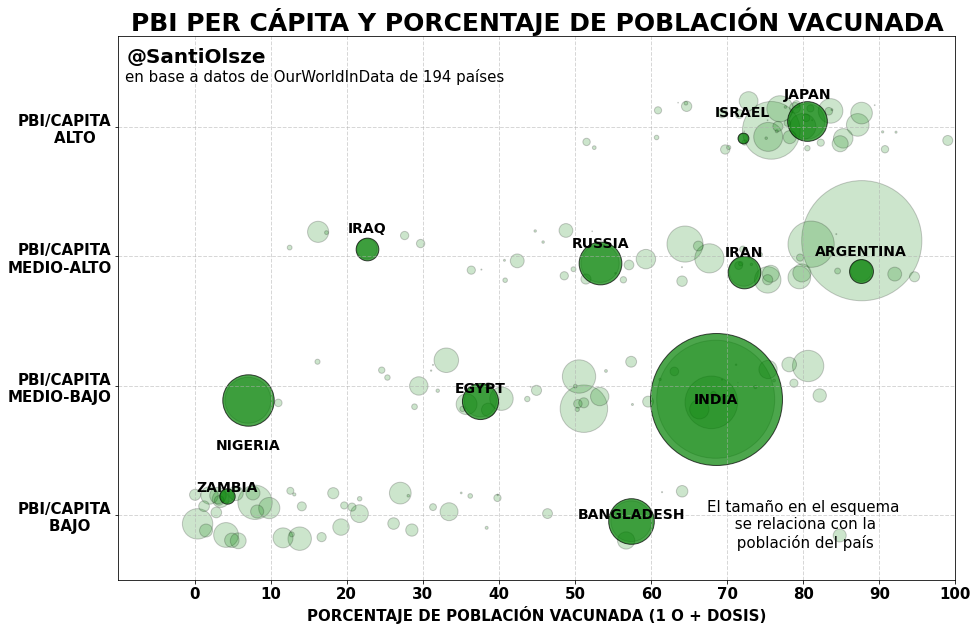

In [33]:
fig,ax = plt.subplots(figsize = (15,10))
ax.scatter(df.people_vaccinated_per_hundred, df.gdp_frac_random
            , marker = "o",facecolors='g', edgecolor = "k",  s = df.population/100000, alpha = 0.2)
plt.ylim(-0.5,3.7)
plt.xlim(-10,100)

for pa in ["Iran","Argentina","Japan", "Israel",
            "India","Russia", "Bangladesh", "Zambia", "Iraq", "Egypt","Nigeria"]:#df.location:,
        sp = df[df.location == pa]
        ax.scatter(sp.people_vaccinated_per_hundred, sp.gdp_frac_random
            , marker = "o",facecolors='g', edgecolor = "k",  s = sp.population/80000, linewidths = 1, alpha = 0.7)
        
        if sp.population.item() > 1000000000:
            plt.text(x = sp.people_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item(),
                color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "center", ha = "center",
                    )
        elif sp.population.item() > 180000000:
                    plt.text(x = sp.people_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item()-0.4,
                        color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                            )
        elif sp.population.item() < 4000000 and sp.population.item() > 30000000:
                    plt.text(x = sp.people_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item()-0.15,
                        color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                            )
        else:
            plt.text(x = sp.people_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item()*1.05,
                color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                    )
from matplotlib.ticker import ScalarFormatter
#ax.set_xscale('log')
for axis in [ax.xaxis]:
    axis.set_major_formatter(ScalarFormatter())

    
plt.text(x=0.2, y = 3.50, s = "@SantiOlsze",fontsize = 20, fontweight = "bold", ha ="center")
plt.text(x= 15.8, y = 3.35, s = "en base a datos de OurWorldInData de {} países".format(len(df)),fontsize = 15, ha ="center")

plt.text(x= 80, y = -0.25,s = "El tamaño en el esquema\n se relaciona con la\n población del país",fontsize = 15, ha ="center")

    
plt.yticks([3,2,1,0],["PBI/CAPITA\nALTO   ", "PBI/CAPITA\nMEDIO-ALTO","PBI/CAPITA\nMEDIO-BAJO","PBI/CAPITA\nBAJO    "], fontsize = 15, fontweight = "bold")
plt.xticks(np.linspace(0,100,11), fontsize = 15, fontweight = "bold")
plt.xlabel("PORCENTAJE DE POBLACIÓN VACUNADA (1 O + DOSIS)",fontsize = 15, fontweight = "bold")
plt.title("PBI PER CÁPITA Y PORCENTAJE DE POBLACIÓN VACUNADA",fontsize = 25, fontweight = "bold")
ax.grid(ls = "--", linewidth = 1, alpha = 0.5)
plt.savefig("PBI_Y_POB", bbox_inches = "tight")

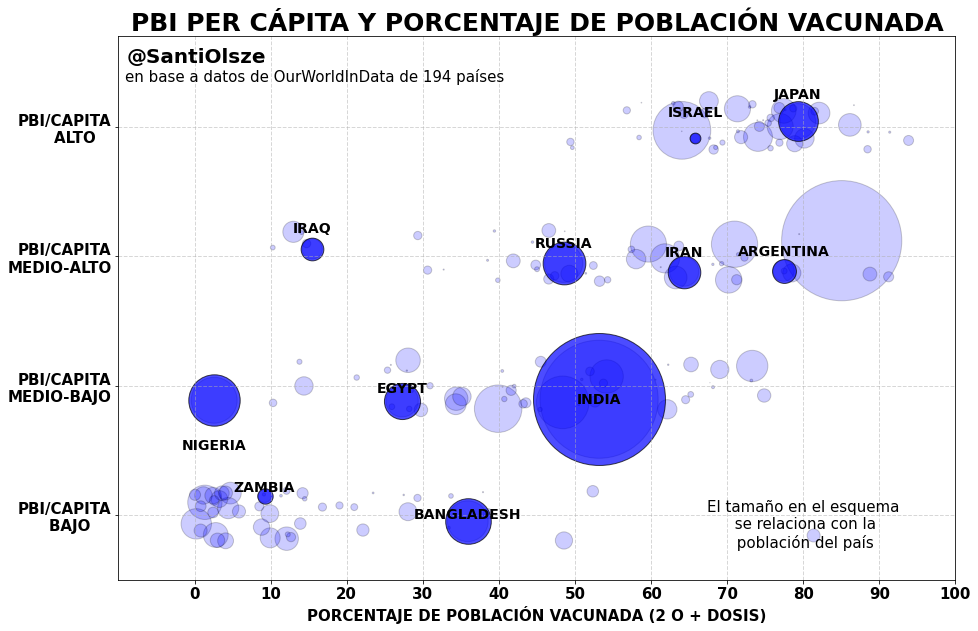

In [34]:
fig,ax = plt.subplots(figsize = (15,10))
ax.scatter(df.people_fully_vaccinated_per_hundred, df.gdp_frac_random
            , marker = "o",facecolors='b', edgecolor = "k",  s = df.population/100000, alpha = 0.2)
plt.ylim(-0.5,3.7)
plt.xlim(-10,100)

for pa in ["Iran","Argentina","Japan", "Israel",
            "India","Russia", "Bangladesh", "Zambia", "Iraq", "Egypt","Nigeria"]:#df.location:,
        sp = df[df.location == pa]
        ax.scatter(sp.people_fully_vaccinated_per_hundred, sp.gdp_frac_random
            , marker = "o",facecolors='b', edgecolor = "k",  s = sp.population/80000, linewidths = 1, alpha = 0.7)
        
        if sp.population.item() > 1000000000:
            plt.text(x = sp.people_fully_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item(),
                color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "center", ha = "center",
                    )
        elif sp.population.item() > 180000000:
                    plt.text(x = sp.people_fully_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item()-0.4,
                        color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                            )
        elif sp.population.item() < 4000000 and sp.population.item() > 30000000:
                    plt.text(x = sp.people_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item()-0.15,
                        color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                            )
        else:
            plt.text(x = sp.people_fully_vaccinated_per_hundred.item(), y = sp.gdp_frac_random.item()*1.05,
                color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                    )
from matplotlib.ticker import ScalarFormatter
#ax.set_xscale('log')
for axis in [ax.xaxis]:
    axis.set_major_formatter(ScalarFormatter())

    
plt.text(x=0.2, y = 3.50, s = "@SantiOlsze",fontsize = 20, fontweight = "bold", ha ="center")
plt.text(x= 15.8, y = 3.35, s = "en base a datos de OurWorldInData de {} países".format(len(df)),fontsize = 15, ha ="center")

plt.text(x= 80, y = -0.25,s = "El tamaño en el esquema\n se relaciona con la\n población del país",fontsize = 15, ha ="center")

    
plt.yticks([3,2,1,0],["PBI/CAPITA\nALTO   ", "PBI/CAPITA\nMEDIO-ALTO","PBI/CAPITA\nMEDIO-BAJO","PBI/CAPITA\nBAJO    "], fontsize = 15, fontweight = "bold")
plt.xticks(np.linspace(0,100,11), fontsize = 15, fontweight = "bold")
plt.xlabel("PORCENTAJE DE POBLACIÓN VACUNADA (2 O + DOSIS)",fontsize = 15, fontweight = "bold")
plt.title("PBI PER CÁPITA Y PORCENTAJE DE POBLACIÓN VACUNADA",fontsize = 25, fontweight = "bold")
ax.grid(ls = "--", linewidth = 1, alpha = 0.5)
plt.savefig("PBI_Y_POB_DOS", bbox_inches = "tight")

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


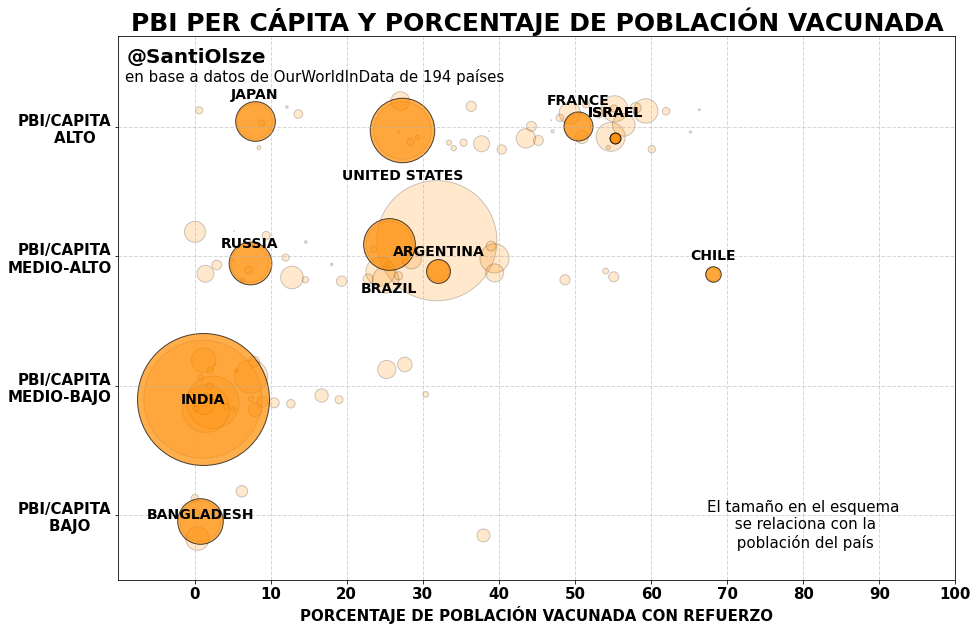

In [38]:
fig,ax = plt.subplots(figsize = (15,10))
ax.scatter(df.total_boosters_per_hundred, df.gdp_frac_random
            , marker = "o",facecolors='darkorange', edgecolor = "k",  s = df.population/100000, alpha = 0.2)
plt.ylim(-0.5,3.7)
plt.xlim(-10,100)

for pa in ["Argentina","Japan", "Israel","Chile","Israel","United States", "France", "Brazil",
            "India","Russia", "Bangladesh", "Zambia", "Iraq", "Egypt","Nigeria"]:#df.location:,
        sp = df[df.location == pa]
        ax.scatter(sp.total_boosters_per_hundred, sp.gdp_frac_random
            , marker = "o",facecolors='darkorange', edgecolor = "k",  s = sp.population/80000, linewidths = 1, alpha = 0.7)
        
        if sp.population.item() > 1000000000:
            plt.text(x = sp.total_boosters_per_hundred.item(), y = sp.gdp_frac_random.item(),
                color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "center", ha = "center",
                    )
        elif sp.population.item() > 180000000:
                    plt.text(x = sp.total_boosters_per_hundred.item(), y = sp.gdp_frac_random.item()-0.4,
                        color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                            )
        elif sp.population.item() < 4000000 and sp.population.item() > 30000000:
                    plt.text(x = sp.total_boosters_per_hundred.item(), y = sp.gdp_frac_random.item()-0.15,
                        color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                            )
        else:
            plt.text(x = sp.total_boosters_per_hundred.item(), y = sp.gdp_frac_random.item()*1.05,
                color = "k", s =pa.upper(), fontsize = 14, fontweight = "bold", va = "bottom", ha = "center",
                    )
from matplotlib.ticker import ScalarFormatter
#ax.set_xscale('log')
for axis in [ax.xaxis]:
    axis.set_major_formatter(ScalarFormatter())

    
plt.text(x=0.2, y = 3.50, s = "@SantiOlsze",fontsize = 20, fontweight = "bold", ha ="center")
plt.text(x= 15.8, y = 3.35, s = "en base a datos de OurWorldInData de {} países".format(len(df)),fontsize = 15, ha ="center")

plt.text(x= 80, y = -0.25,s = "El tamaño en el esquema\n se relaciona con la\n población del país",fontsize = 15, ha ="center")

    
plt.yticks([3,2,1,0],["PBI/CAPITA\nALTO   ", "PBI/CAPITA\nMEDIO-ALTO","PBI/CAPITA\nMEDIO-BAJO","PBI/CAPITA\nBAJO    "], fontsize = 15, fontweight = "bold")
plt.xticks(np.linspace(0,100,11), fontsize = 15, fontweight = "bold")
plt.xlabel("PORCENTAJE DE POBLACIÓN VACUNADA CON REFUERZO",fontsize = 15, fontweight = "bold")
plt.title("PBI PER CÁPITA Y PORCENTAJE DE POBLACIÓN VACUNADA",fontsize = 25, fontweight = "bold")
ax.grid(ls = "--", linewidth = 1, alpha = 0.5)
plt.savefig("PBI_Y_POB_BOOST", bbox_inches = "tight")

In [45]:
OWID[OWID.location == 'Low income'].max().tail(50)

hosp_patients                                                 NaN
hosp_patients_per_million                                     NaN
weekly_icu_admissions                                         NaN
weekly_icu_admissions_per_million                             NaN
weekly_hosp_admissions                                        NaN
weekly_hosp_admissions_per_million                            NaN
new_tests                                                     NaN
total_tests                                                   NaN
total_tests_per_thousand                                      NaN
new_tests_per_thousand                                        NaN
new_tests_smoothed                                            NaN
new_tests_smoothed_per_thousand                               NaN
positive_rate                                                 NaN
tests_per_case                                                NaN
tests_units                                                   NaN
total_vacc

In [25]:
84426210.0 / 9788986851.0 * 100

0.8624611646237463

In [12]:
a = df[(df.gdp_frac == 0)].shape[0]

b = df[(df.gdp_frac == 0) & (df.people_vaccinated_per_hundred > 20)].shape[0]

b/a * 100



21.27659574468085

In [ ]:
arg = OWID[OWID.location == "Argentina"][["datetime","new_deaths"]].dropna(how="any")
#arg.loc[arg.new_deaths > 3000,"new_deaths"] = 600
arg["mes"] = arg.datetime.dt.month
arg["año"] = arg.datetime.dt.year
arg["año_mes"] = arg["año"].astype(str) + "_" + arg["mes"].astype(str)
df = arg.groupby("año_mes", as_index = False).mean().sort_values(["año","mes"]).rename(columns = 
                                                                                      {"año_mes":"Name",
                                                                                      "new_deaths":"Value"})

#df = df[:-1]

In [ ]:
arg = OWID[OWID.location == "Argentina"][["datetime","new_deaths"]].dropna(how="any")


In [ ]:
# Build a dataset
# Reorder the dataframe
#df = df.sort_values(by=['Name_Order'])
# with plt.xkcd():

# initialize the figure
plt.figure(figsize=(10,10), dpi = 300)
ax = plt.subplot(111, polar=True)
plt.axis('off')

# Constants = parameters controling the plot layout:
upperLimit = 100
lowerLimit = 30
labelPadding = 10

# Compute max and min in the dataset
max = df['Value'].max()

# Let's compute heights: they are a conversion of each item value in those new coordinates
# In our example, 0 in the dataset will be converted to the lowerLimit (10)
# The maximum will be converted to the upperLimit (100)
slope = (max - lowerLimit) / max
heights = slope * df.Value + lowerLimit

# Compute the width of each bar. In total we have 2*Pi = 360°
width = 2*np.pi / len(df.index)

# Compute the angle each bar is centered on:
indexes = list(range(1, len(df.index)+1))
angles = [element * width for element in indexes]
angles

# Draw bars
bars = ax.bar(
    x=angles, 
    height=heights, 
    width=width, 
    bottom=lowerLimit,
    linewidth=2, 
    edgecolor="k",
    color="darkred", alpha = 0.4
)

# Add labels
for bar, angle, height, label in zip(bars,angles, heights, df["Name"]):

    # Labels are rotated. Rotation must be specified in degrees :(
    rotation = np.rad2deg(angle)

    # Flip some labels upside down
    alignment = ""
    if angle >= np.pi/2 and angle < 3*np.pi/2:
        alignment = "right"
        rotation = rotation + 180
    else: 
        alignment = "left"

    # Finally add the labels
    ax.text(
        x=angle, 
        y=(8+ bar.get_height()/2), 
        s=label, fontsize = 4 + bar.get_height()/43, fontweight = "bold", 
        ha=alignment, 
        va='center', 
        rotation=rotation, 
        rotation_mode="anchor")
plt.savefig("caracol_fallecidos_argentina_reporte", bbox_inches = "tight")

In [ ]:
df

In [ ]:
a = OWID[["location","total_vaccinations"]].groupby("location").max()
b = OWID[["location","total_vaccinations_per_hundred"]].groupby("location").max()
m = pd.merge(a,b,left_index = True, right_index = True)

In [ ]:
a = OWID[OWID.population > 10000000]
a = a[~a.continent.isnull()]
a = a[["location","continent","new_vaccinations_smoothed_per_million"]].groupby(["continent","location"]).max()
a.sort_values("new_vaccinations_smoothed_per_million", ascending = False).to_csv("máximo_vacunas_por_millon.csv")

In [ ]:
OWID = pd.read_csv("https://covid.ourworldindata.org/data/owid-covid-data.csv")
OWID["datetime"] = pd.to_datetime(OWID.date)

In [ ]:
w = 7
iso_code = "GBR"
corte1 = pd.to_datetime("2020-10-16")  - datetime.timedelta(days = 60)
corte2 = pd.to_datetime("2020-10-16")

corte3 = datetime.datetime.today() - datetime.timedelta(days = 60)
corte4 = datetime.datetime.today()

df = OWID[OWID.iso_code == iso_code]

df_a = df[(df.datetime > corte1) & (df.datetime <= corte2)]
df_b = df[(df.datetime > corte3) & (df.datetime <= corte4)]





fig, axs = plt.subplots(3,2, dpi = 300, figsize = (12,8))

fig.suptitle("REINO UNIDO Y COVID: 2020-2021", fontsize = 25, fontweight = "bold")

fig.subplots_adjust(wspace = 0.3, hspace = 0.5, bottom = 0, top = .87)


for ij in [(0,0), (0,1), (1,0), (1,1),(2,0),(2,1)]:
    axs[ij].grid(alpha = 0.5, ls = "--")

################ CASOS ##########################

axs[0,0].set_title("CASOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 17)
axs[0,1].set_title("CASOS (May-Jul 2021)", fontweight = "bold", fontsize = 17)

axs[0,0].plot(df_a.datetime, df_a.new_cases.rolling(window = w).mean(), linewidth = 4, color = "darkgreen")
axs[0,1].plot(df_b.datetime, df_b.new_cases.rolling(window = w).mean(), linewidth = 4, color = "darkgreen")

axs[0,0].set_ylim(0,50000)
axs[0,1].set_ylim(0,50000)



axs[0,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[0,1].set_xticks([i for i in df_b.datetime if i.day == 1])



################ HOSPITALIZADOS ##########################

axs[1,0].set_title("HOSPITALIZADOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 15)
axs[1,1].set_title("HOSPITALIZADOS (May-Jul 2021)", fontweight = "bold", fontsize = 15)
axs[1,0].plot(df_a.datetime, df_a.hosp_patients.rolling(window = w).mean(), linewidth = 4, color = "indigo")
axs[1,1].plot(df_b.datetime, df_b.hosp_patients.rolling(window = w).mean(), linewidth = 4, color = "indigo")

axs[1,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[1,1].set_xticks([i for i in df_b.datetime if i.day == 1])

axs[1,0].set_ylim(0,6000)
axs[1,1].set_ylim(0,6000)



################ FALLECIMIENTOS ##########################
axs[2,0].set_title("FALLECIMIENTOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 15)
axs[2,1].set_title("FALLECIMIENTOS (May-Jul 2021)", fontweight = "bold", fontsize = 15)
axs[2,0].plot(df_a.datetime, df_a.new_deaths.rolling(window = w).mean(), linewidth = 4, color = "red")
axs[2,1].plot(df_b.datetime, df_b.new_deaths.rolling(window = w).mean(), linewidth = 4, color = "red")

axs[2,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[2,1].set_xticks([i for i in df_b.datetime if i.day == 1])

axs[2,0].set_ylim(0,120)
axs[2,1].set_ylim(0,120)


plt.text(x=datetime.datetime.today()-  datetime.timedelta(days = 131), y = -70, fontsize = 10,
         s = "Medias móviles a 7 días de casos, pacientes hospitalizados y fallecimientos según datos de Our World In Data\n(link: https://covid.ourworldindata.org/data/owid-covid-data.csv). Elaboración: Santiago Olszevicki (Tw: @SantiOlsze)")


plt.savefig("uk_comparativa2021_{}".format(w), bbox_inches = "tight");

In [ ]:
w = 7
iso_code = "GBR"
corte2 = pd.to_datetime("2021-1-15")
corte1 = corte2  - datetime.timedelta(days = 60)

corte3 = datetime.datetime.today() - datetime.timedelta(days = 60)
corte4 = datetime.datetime.today()

df = OWID[OWID.iso_code == iso_code]

df_a = df[(df.datetime > corte1) & (df.datetime <= corte2)]
df_b = df[(df.datetime > corte3) & (df.datetime <= corte4)]





fig, axs = plt.subplots(4,2, dpi = 300, figsize = (12,8))

fig.suptitle("REINO UNIDO Y COVID-19: OLAS", fontsize = 25, fontweight = "bold")

fig.subplots_adjust(wspace = 0.3, hspace = 0.5, bottom = 0, top = .87)


for ij in [(0,0), (0,1), (1,0), (1,1),(2,0),(2,1),(3,0),(3,1)]:
    axs[ij].grid(alpha = 0.5, ls = "--")

################ CASOS ##########################

axs[0,0].set_title("CASOS (Dic-Ene 2021)", fontweight = "bold", fontsize = 17)
axs[0,1].set_title("CASOS (Jul-Ago 2021)", fontweight = "bold", fontsize = 17)

axs[0,0].plot(df_a.datetime, df_a.new_cases.rolling(window = w).mean(), linewidth = 4, color = "darkgreen")
axs[0,1].plot(df_b.datetime, df_b.new_cases.rolling(window = w).mean(), linewidth = 4, color = "darkgreen")

axs[0,0].set_ylim(0,70000)
axs[0,1].set_ylim(0,70000)



axs[0,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[0,1].set_xticks([i for i in df_b.datetime if i.day == 1])



################ HOSPITALIZADOS ##########################

axs[1,0].set_title("HOSPITALIZADOS (Dic-Ene 2021)", fontweight = "bold", fontsize = 15)
axs[1,1].set_title("HOSPITALIZADOS (Jul-Ago 2021)", fontweight = "bold", fontsize = 15)
axs[1,0].plot(df_a.datetime, df_a.hosp_patients.rolling(window = w).mean(), linewidth = 4, color = "indigo")
axs[1,1].plot(df_b.datetime, df_b.hosp_patients.rolling(window = w).mean(), linewidth = 4, color = "indigo")

axs[1,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[1,1].set_xticks([i for i in df_b.datetime if i.day == 1])

axs[1,0].set_ylim(0,50000)
axs[1,1].set_ylim(0,50000)



################ FALLECIMIENTOS ##########################
axs[2,0].set_title("FALLECIMIENTOS (Dic-Ene 2021)", fontweight = "bold", fontsize = 15)
axs[2,1].set_title("FALLECIMIENTOS (Jul-Ago 2021)", fontweight = "bold", fontsize = 15)
axs[2,0].plot(df_a.datetime, df_a.new_deaths.rolling(window = w).mean(), linewidth = 4, color = "red")
axs[2,1].plot(df_b.datetime, df_b.new_deaths.rolling(window = w).mean(), linewidth = 4, color = "red")

axs[2,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[2,1].set_xticks([i for i in df_b.datetime if i.day == 1])

axs[2,0].set_ylim(0,1220)
axs[2,1].set_ylim(0,1220)

################ FALLECIMIENTOS ##########################
axs[3,0].set_title("VACUNADOS (%) (Dic-Ene 2021)", fontweight = "bold", fontsize = 15)
axs[3,1].set_title("VACUNADOS (%) (Jul-Ago 2021)", fontweight = "bold", fontsize = 15)

axs[3,0].plot(df_a.datetime, df_a.people_vaccinated_per_hundred.fillna(df_a.people_vaccinated_per_hundred.min()), linewidth = 4, color = "purple", label = "Al menos una dosis")
axs[3,0].plot(df_a.datetime, df_a.people_fully_vaccinated_per_hundred.fillna(df_a.people_fully_vaccinated_per_hundred.min()), linewidth = 4, color = "violet", label = "Dos dosis")


axs[3,1].plot(df_b.datetime, df_b.people_vaccinated_per_hundred, linewidth = 4, color = "purple", label = "Al menos una dosis")
axs[3,1].plot(df_b.datetime, df_b.people_fully_vaccinated_per_hundred, linewidth = 4, color = "violet", label = "Dos dosis")


axs[3,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[3,1].set_xticks([i for i in df_b.datetime if i.day == 1])

axs[3,0].set_ylim(0,80)
axs[3,1].set_ylim(0,80)

axs[3,1].legend(loc = "lower right")
axs[3,0].legend(loc = "upper left")

plt.text(x=datetime.datetime.today()-  datetime.timedelta(days = 145), y = -50, fontsize = 10,
         s = "Medias móviles a 7 días de casos, pacientes hospitalizados y fallecimientos según datos de Our World In Data\n(link: https://covid.ourworldindata.org/data/owid-covid-data.csv). Elaboración: Santiago Olszevicki (Tw: @SantiOlsze)")


plt.savefig("uk_comparativa_enero2021_{}".format(w), bbox_inches = "tight");

In [ ]:

df = OWID[OWID.iso_code == iso_code]

df_a = df[(df.datetime > corte1) & (df.datetime <= corte2)]
df_b = df[(df.datetime > corte3) & (df.datetime <= corte4)]





fig, axs = plt.subplots(4,2, dpi = 300, figsize = (12,8))

fig.suptitle("REINO UNIDO Y COVID: 2020-2021 \n @SantiOlsze en base a OurWorldInData.org", fontsize = 25, fontweight = "bold")

fig.subplots_adjust(wspace = 0.3, hspace = 0.5, bottom = 0, top = .82)


for ij in [(0,0), (0,1), (1,0), (1,1),(2,0),(2,1),(3,0),(3,1)]:
    axs[ij].grid(alpha = 0.5, ls = "--")

################ CASOS ##########################

axs[0,0].set_title("CASOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 17)
axs[0,1].set_title("CASOS (May-Jul 2021)", fontweight = "bold", fontsize = 17)

axs[0,0].plot(df_a.datetime, df_a.new_cases, linewidth = 3, color = "darkblue")
axs[0,1].plot(df_b.datetime, df_b.new_cases, linewidth = 3, color = "darkblue")

axs[0,0].set_ylim(0,30000)
axs[0,1].set_ylim(0,30000)



axs[0,0].set_xticks([i for i in df_a.datetime if i.day == 15])
axs[0,1].set_xticks([i for i in df_b.datetime if i.day == 15])


################ POSITIVIDAD ##########################
axs[1,0].set_title("POSITIVIDAD (Ago-Oct 2020)", fontweight = "bold", fontsize = 15)
axs[1,1].set_title("POSITIVIDAD (May-Jul 2021)", fontweight = "bold", fontsize = 15)
axs[1,0].plot(df_a.datetime, (df_a.new_cases / df_a.new_tests) * 100, linewidth = 3, color = "goldenrod")
axs[1,1].plot(df_b.datetime, (df_b.new_deaths/ df_b.new_tests) * 100, linewidth = 3, color = "goldenrod")

axs[1,0].set_xticks([i for i in df_a.datetime if i.day == 15])
axs[1,1].set_xticks([i for i in df_b.datetime if i.day == 15])

axs[1,0].set_ylim(0,20)
axs[1,1].set_ylim(0,20)




################ HOSPITALIZADOS ##########################

axs[2,0].set_title("HOSPITALIZADOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 15)
axs[2,1].set_title("HOSPITALIZADOS (May-Jul 2021)", fontweight = "bold", fontsize = 15)
axs[2,0].plot(df_a.datetime, df_a.hosp_patients, linewidth = 3, color = "indigo")
axs[2,1].plot(df_b.datetime, df_b.hosp_patients, linewidth = 3, color = "indigo")

axs[2,0].set_xticks([i for i in df_a.datetime if i.day == 15])
axs[2,1].set_xticks([i for i in df_b.datetime if i.day == 15])

axs[2,0].set_ylim(0,8000)
axs[2,1].set_ylim(0,8000)



################ FALLECIMIENTOS ##########################
axs[3,0].set_title("FALLECIMIENTOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 15)
axs[3,1].set_title("FALLECIMIENTOS (May-Jul 2021)", fontweight = "bold", fontsize = 15)
axs[3,0].plot(df_a.datetime, df_a.new_deaths, linewidth = 3, color = "red")
axs[3,1].plot(df_b.datetime, df_b.new_deaths, linewidth = 3, color = "red")

axs[3,0].set_xticks([i for i in df_a.datetime if i.day == 15])
axs[3,1].set_xticks([i for i in df_b.datetime if i.day == 15])

axs[3,0].set_ylim(0,150)
axs[3,1].set_ylim(0,150)






plt.savefig("uk_comparativa2021_POS", bbox_inches = "tight");

In [ ]:
w = 7
iso_code = "ISR"
corte1 = pd.to_datetime("2020-7-19")  - datetime.timedelta(days = 60)
corte2 = pd.to_datetime("2020-7-19")

corte3 = datetime.datetime.today() - datetime.timedelta(days = 60)
corte4 = datetime.datetime.today()

df = OWID[OWID.iso_code == iso_code]

df_a = df[(df.datetime > corte1) & (df.datetime <= corte2)]
df_b = df[(df.datetime > corte3) & (df.datetime <= corte4)]





fig, axs = plt.subplots(3,2, dpi = 300, figsize = (12,8))

fig.suptitle("ISRAEL Y COVID: 2020-2021", fontsize = 25, fontweight = "bold")

fig.subplots_adjust(wspace = 0.3, hspace = 0.5, bottom = 0, top = .87)


for ij in [(0,0), (0,1), (1,0), (1,1),(2,0),(2,1)]:
    axs[ij].grid(alpha = 0.5, ls = "--")

################ CASOS ##########################

axs[0,0].set_title("CASOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 17)
axs[0,1].set_title("CASOS (May-Jul 2021)", fontweight = "bold", fontsize = 17)

axs[0,0].plot(df_a.datetime, df_a.new_cases.rolling(window = w).mean(), linewidth = 3, color = "darkblue")
axs[0,1].plot(df_b.datetime, df_b.new_cases.rolling(window = w).mean(), linewidth = 3, color = "darkblue")

axs[0,0].set_ylim(0,2000)
axs[0,1].set_ylim(0,2000)



axs[0,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[0,1].set_xticks([i for i in df_b.datetime if i.day == 1])



################ HOSPITALIZADOS ##########################

axs[1,0].set_title("HOSPITALIZADOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 15)
axs[1,1].set_title("HOSPITALIZADOS (May-Jul 2021)", fontweight = "bold", fontsize = 15)
axs[1,0].plot(df_a.datetime, df_a.hosp_patients.rolling(window = w).mean(), linewidth = 3, color = "indigo")
axs[1,1].plot(df_b.datetime, df_b.hosp_patients.rolling(window = w).mean(), linewidth = 3, color = "indigo")

axs[1,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[1,1].set_xticks([i for i in df_b.datetime if i.day == 1])

axs[1,0].set_ylim(0,800)
axs[1,1].set_ylim(0,800)



################ FALLECIMIENTOS ##########################
axs[2,0].set_title("FALLECIMIENTOS (Ago-Oct 2020)", fontweight = "bold", fontsize = 15)
axs[2,1].set_title("FALLECIMIENTOS (May-Jul 2021)", fontweight = "bold", fontsize = 15)
axs[2,0].plot(df_a.datetime, df_a.new_deaths.rolling(window = w).mean(), linewidth = 3, color = "red")
axs[2,1].plot(df_b.datetime, df_b.new_deaths.rolling(window = w).mean(), linewidth = 3, color = "red")

axs[2,0].set_xticks([i for i in df_a.datetime if i.day == 1])
axs[2,1].set_xticks([i for i in df_b.datetime if i.day == 1])

axs[2,0].set_ylim(-1,10)
axs[2,1].set_ylim(-1,10)


plt.text(x=datetime.datetime.today()-  datetime.timedelta(days = 131), y = -7, 
         s = "Medias móviles a 7 días de casos, pacientes hospitalizados y fallecimientos según datos de Our World In Data\n(link: https://covid.ourworldindata.org/data/owid-covid-data.csv). Elaboración: Santiago Olszevicki (Tw: @SantiOlsze)")


plt.savefig("israel_comparativa2021_{}".format(w), bbox_inches = "tight");

In [ ]:
movilidad = pd.read_csv("https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv", sep = ",")
movilidad["datetime"] = pd.to_datetime(movilidad['date'])

In [ ]:
pba_amba = ["Almirante Brown", 
 "Avellaneda", 
 "Berazategui",
 "Berisso",
 "Brandsen",
 "Campana",
 "Cañuelas",
 "Ensenada",
 "Escobar",
"Esteban Echeverría",
"Exaltación de la Cruz",
 "Ezeiza",
 "Florencio Varela",
 "General Las Heras",
 "General Rodríguez",
 "General San Martín",
 "Hurlingham",
 "Ituzaingó",
 "José C. Paz",
 "La Matanza",
 "Lanús",
 "La Plata",
 "Lomas de Zamora",
 "Luján",
 "Malvinas Argentinas",
 "Marcos Paz",
 "Merlo",
 "Moreno",
 "Morón",
 "Pilar",
 "Presidente Perón",
 "Quilmes",
 "San Fernando",
 "San Isidro",
 "San Miguel",
 "San Vicente",
 "Tigre",
 "Tres de Febrero",
 "Vicente López",
 "Zárate"]

In [ ]:
movilidad

In [ ]:
movarg = movilidad[movilidad.country_region == "Argentina"]

In [ ]:
mov_pba = movarg[movarg.sub_region_1 == "Buenos Aires Province"]

In [ ]:
mov_pba["sub_region_2"] = mov_pba.sub_region_2.str.replace(" Partido","")

In [ ]:
mov_pba_amba = mov_pba[mov_pba.sub_region_2.isin(pba_amba)]

In [ ]:
cuidar = pd.read_csv("/home/santiago/Downloads/gba_data.csv")
cuidar["date"] = pd.to_datetime(cuidar.date)
cuidar["cordon-1"] = cuidar["cordon-1"].astype(float)

In [ ]:
fig, ax = plt.subplots(figsize = (4,3), dpi = 200)

d = mov_pba_amba.groupby("datetime", as_index = False).mean()



ax.plot(d.datetime[440:], 
         d.transit_stations_percent_change_from_baseline[440:].rolling(window = 7, center = False).mean(),
        label = "Promedio 7 días AMBA", color = "g")

plt.plot(d.datetime[420:], 
         d.transit_stations_percent_change_from_baseline.rolling(window = 1, center = True).mean()[420:],
        label = "AMBA", linewidth = 0.1, marker = "o", ms = 1, alpha = .8, color = "g")

ax.set_ylabel("% de reducción vs. Feb2020", fontsize = 7)
ax.set_yticks(np.linspace(-80,0,9))
plt.xticks([pd.to_datetime("2021-"+i) for i in ["05-04","05-11","05-18","05-25","06-01","06-08","06-15","06-22","06-29"]],rotation = 45, fontsize = 7)
ax.set_xlim(pd.to_datetime("2021-04-25"),)
ax.set_title("Movilidad Google: Estaciones de transporte", fontsize = 10)
ax.legend(loc = "upper right", fontsize = 5, ncol = 1)
ax.axvline(pd.to_datetime("2021-05-21"), linewidth = 1)

ax2.plot(cuidar.date, cuidar["cordon-1"], label = "CuidAr GBA 1er cordon")

ax2 = ax.twinx()
ax2.plot(cuidar.date, cuidar["cordon-1"].rolling(window = 7).mean(), label = "CuidAr GBA 1er cordon", color = "darkblue", alpha = 1)
ax2.plot(cuidar.date, cuidar["cordon-2"].rolling(window = 7).mean(), label = "CuidAr GBA 1er cordon", color = "r", alpha = 1)

ax2.legend(loc = "lower left", fontsize = 5, ncol = 1)


ax2.plot(cuidar.date, cuidar["cordon-1"].rolling(window = 1).mean(), marker = "o",linewidth = 0.1, ms = 0.5, color = "darkblue", alpha = 1)
ax2.plot(cuidar.date, cuidar["cordon-2"].rolling(window = 1).mean(), marker = "o",linewidth = 0.1, ms = 0.5, color = "r", alpha = 1)



ax2.set_ylabel("Indicador CuidAR/100k hab", fontsize = 7)

;

In [ ]:
plt.figure(figsize = (4,3), dpi = 200)

d = mov_pba_amba.groupby("datetime", as_index = False).mean()



plt.plot(d.datetime[440:], 
         d.workplaces_percent_change_from_baseline[440:].rolling(window = 7, center = False).mean(),
        label = "Promedio 7 días AMBA", color = "g")

plt.plot(d.datetime[420:], 
         d.workplaces_percent_change_from_baseline.rolling(window = 1, center = True).mean()[420:],
        label = "AMBA", linewidth = 0.1, marker = "o", ms = 1, alpha = .8, color = "g")

plt.ylabel("% de reducción vs. Feb2020", fontsize = 7)
plt.yticks(np.linspace(-50,20,8), fontsize = 5)
plt.xticks([pd.to_datetime("2021-"+i) for i in ["05-04","05-11","05-18","05-25","06-01","06-08","06-15","06-22","06-29"]],rotation = 45, fontsize = 7)
plt.xlim(pd.to_datetime("2021-04-25"),)
plt.title("Movilidad Google: Lugares de trabajo", fontsize = 10)
plt.legend(loc = "upper right", fontsize = 5, ncol = 1)
plt.axvline(pd.to_datetime("2021-05-21"), linewidth = 1);

In [ ]:
plt.figure(figsize = (4,3), dpi = 200)

d = mov_pba_amba.groupby("datetime", as_index = False).mean()



plt.plot(d.datetime[440:], 
         d.residential_percent_change_from_baseline[440:].rolling(window = 7, center = False).mean(),
        label = "Promedio 7 días AMBA", color = "g")

plt.plot(d.datetime[420:], 
         d.residential_percent_change_from_baseline.rolling(window = 1, center = True).mean()[420:],
        label = "AMBA", linewidth = 0.1, marker = "o", ms = 1, alpha = .8, color = "g")

plt.ylabel("% de reducción vs. Feb2020", fontsize = 7)
plt.yticks(np.linspace(0,30,7), fontsize = 5)
plt.xticks([pd.to_datetime("2021-"+i) for i in ["05-04","05-11","05-18","05-25","06-01","06-08","06-15","06-22","06-29"]],rotation = 45, fontsize = 7)
plt.xlim(pd.to_datetime("2021-04-25"),)
plt.title("Movilidad Google: residencial", fontsize = 10)
plt.legend(loc = "upper right", fontsize = 5, ncol = 1)
plt.axvline(pd.to_datetime("2021-05-21"), linewidth = 1);

In [ ]:
d.columns

In [ ]:
OWID.columns

In [ ]:
OWID.columns

In [ ]:
country = "United Kingdom"
del max

In [3]:
country = "Netherlands"

def plot_mirror(country):
    df = OWID[OWID.location == country][["datetime","new_cases_smoothed","new_deaths_smoothed","people_vaccinated_per_hundred"]].fillna(0)

    fig, axs = plt.subplots(2,1, figsize = (3,2), dpi = 200, sharex = True)
    fig.subplots_adjust(wspace = 0, hspace = 0, bottom = 0, top = 0.90)

    for i,z in df.iterrows():
        axs[0].bar(z.datetime, z.new_cases_smoothed,
                   #alpha = z.people_vaccinated_per_hundred/100 + 0.25,
                   alpha = .5,
                   color = "darkblue",width = .5)
        axs[1].bar(z.datetime, z.new_deaths_smoothed*-1, color = "crimson",width = .5)

    for ax in axs:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.grid(alpha = 1)
        ax.set_xlim(pd.to_datetime("2020-01-01"))
        axs[0].set_ylim(0)
        axs[0].legend(["CASES"],loc = "upper left", fontsize = 5)
        axs[1].legend(["DEATHS"],loc = "lower left", fontsize = 5)
        axs[1].set_ylim(-max(df.new_deaths_smoothed)*1.3,0)
        fig.suptitle(" {} ({:.2f}% partially or fully vaccinated)".format(country.upper(),max(df.people_vaccinated_per_hundred)), fontsize = 6)
        axs[0].text(x = pd.to_datetime("2020-01-15"), y = max(df.new_cases_smoothed)*0.5,
                s ="".format(max(df.people_vaccinated_per_hundred)),
               fontsize = 3.5);
    plt.savefig("mirror_{}".format(country), bbox_inches = "tight")

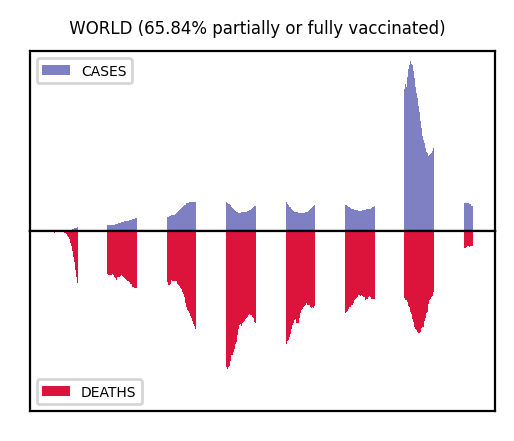

In [4]:
plot_mirror("World");


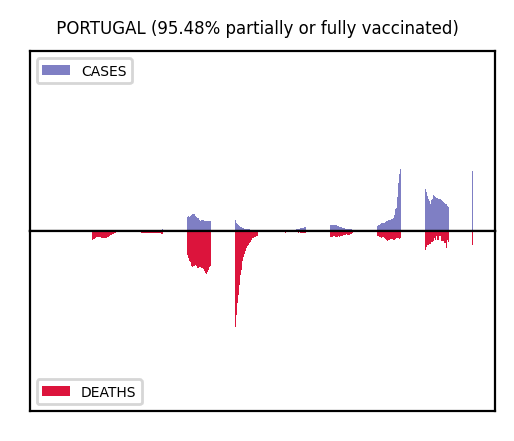

In [5]:
plot_mirror("Portugal");


''

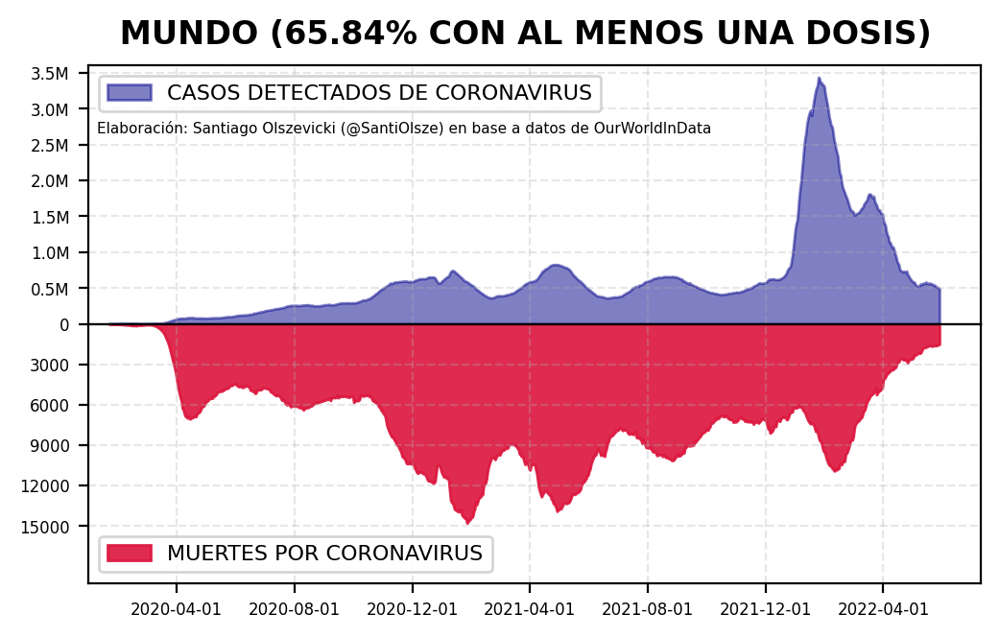

In [7]:
country = "World"
df = OWID[OWID.location == country][["datetime","new_cases_smoothed","new_deaths_smoothed","people_vaccinated_per_hundred"]].fillna(0)

fig, axs = plt.subplots(2,1, figsize = (6,3), dpi = 200, sharex = True)
fig.subplots_adjust(wspace = 0, hspace = 0, bottom = 0, top = 0.90)

axs[0].fill_between(df.datetime, df.new_cases_smoothed,
           alpha = .5,
           color = "darkblue")

axs[0].set_yticks([i*500000 for i in [1,2,3,4,5,6,7]])
axs[0].tick_params(axis='both', which='major', labelsize=6)
axs[0].tick_params(axis='both', which='minor', labelsize=6)

axs[1].fill_between(df.datetime, df.new_deaths_smoothed*-1, color = "crimson", alpha = .9)



for ax in axs:
    
    ax.grid(alpha = .3, ls = "--")
    ax.set_xlim(pd.to_datetime("2020-01-01"))
    axs[0].set_ylim(0)
    axs[0].legend(["CASOS DETECTADOS DE CORONAVIRUS"],loc = "upper left", fontsize = 8)
    axs[1].legend(["MUERTES POR CORONAVIRUS"],loc = "lower left", fontsize = 8)
    axs[1].set_ylim(-max(df.new_deaths_smoothed)*1.3,0)
    fig.suptitle(" {} ({:.2f}% CON AL MENOS UNA DOSIS)".format("MUNDO",max(df.people_vaccinated_per_hundred)), fontsize = 12, fontweight = "bold")
    axs[0].text(x = pd.to_datetime("2020-01-15"), y = max(df.new_cases_smoothed)*0.5,
            s ="".format(max(df.people_vaccinated_per_hundred)),
           fontsize = 3.5);
    
axs[1].set_xticks([i for i in df.datetime if i.day == 1 and i.month % 2 == 0 and i.month % 4 == 0])
axs[1].tick_params(axis='both', which='major', labelsize=6)
axs[1].tick_params(axis='both', which='minor', labelsize=6)

plt.yticks(np.linspace(-15000,0,6), [abs(int(i)) for i in np.linspace(-15000,0,6)])


from matplotlib.ticker import FuncFormatter

def millions_formatter(x, pos):
    return f'{int(x) / 1000000}M'

axs[0].yaxis.set_major_formatter(FuncFormatter(millions_formatter))

plt.text(pd.to_datetime("2020-01-10"), 14200,
             "Elaboración: Santiago Olszevicki (@SantiOlsze) en base a datos de OurWorldInData", fontsize = 5.5)
;

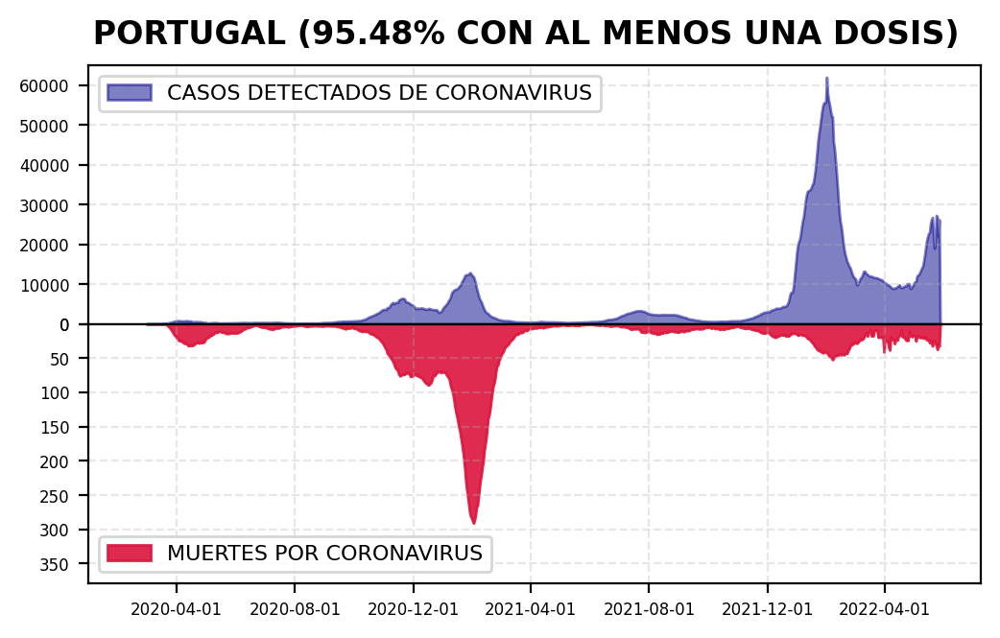

In [16]:
country = "Portugal"
df = OWID[OWID.location == country][["datetime","new_cases_smoothed","new_deaths_smoothed","people_vaccinated_per_hundred"]].fillna(0)

fig, axs = plt.subplots(2,1, figsize = (6,3), dpi = 200, sharex = True)
fig.subplots_adjust(wspace = 0, hspace = 0, bottom = 0, top = 0.90)

axs[0].fill_between(df.datetime, df.new_cases_smoothed,
           alpha = .5,
           color = "darkblue")

# axs[0].set_yticks([i*500000 for i in [1,2,3,4,5,6,7]])
axs[0].tick_params(axis='both', which='major', labelsize=6)
axs[0].tick_params(axis='both', which='minor', labelsize=6)

axs[1].fill_between(df.datetime, df.new_deaths_smoothed*-1, color = "crimson", alpha = .9)



for ax in axs:
    
    ax.grid(alpha = .3, ls = "--")
    ax.set_xlim(pd.to_datetime("2020-01-01"))
    axs[0].set_ylim(0)
    axs[0].legend(["CASOS DETECTADOS DE CORONAVIRUS"],loc = "upper left", fontsize = 8)
    axs[1].legend(["MUERTES POR CORONAVIRUS"],loc = "lower left", fontsize = 8)
    axs[1].set_ylim(-max(df.new_deaths_smoothed)*1.3,0)
    fig.suptitle(" {} ({:.2f}% CON AL MENOS UNA DOSIS)".format(country.upper(),max(df.people_vaccinated_per_hundred)), fontsize = 12, fontweight = "bold")
    axs[0].text(x = pd.to_datetime("2020-01-15"), y = max(df.new_cases_smoothed)*0.5,
            s ="".format(max(df.people_vaccinated_per_hundred)),
           fontsize = 3.5);
    
axs[1].set_xticks([i for i in df.datetime if i.day == 1 and i.month % 2 == 0 and i.month % 4 == 0])
axs[1].tick_params(axis='both', which='major', labelsize=6)
axs[1].tick_params(axis='both', which='minor', labelsize=6)

plt.yticks(np.linspace(-350,0,8), [abs(int(i)) for i in np.linspace(-350,0,8)])


from matplotlib.ticker import FuncFormatter

def millions_formatter(x, pos):
    return f'{int(x) / 1000000}M'

# axs[0].yaxis.set_major_formatter(FuncFormatter(millions_formatter))

# plt.text(pd.to_datetime("2020-01-10"), 14200,
#              "Elaboración: Santiago Olszevicki (@SantiOlsze) en base a datos de OurWorldInData", fontsize = 5.5)
# ;

In [47]:
#for country in set(OWID[OWID.continent.isin(["Asia"])].location): plot_mirror(country), plt.close()

In [48]:
OWID[OWID.location == "Ukraine"][["datetime","people_vaccinated_per_hundred"]]

,datetime,people_vaccinated_per_hundred
148860,2020-03-03,NaN
148861,2020-03-04,NaN
148862,2020-03-05,NaN
148863,2020-03-06,NaN
148864,2020-03-07,NaN
...,...,...
149560,2022-02-01,35.39
149561,2022-02-02,35.45
149562,2022-02-03,35.50
149563,2022-02-04,35.55


In [ ]:
OWID["mes_año"] = [i[:7] for i in OWID.date]

In [ ]:
a = OWID[["location","continent","mes_año","people_vaccinated_per_hundred","population"]].groupby(["location","continent","mes_año"],as_index = True).max()

In [ ]:
subOWID = OWID[["location","continent","mes_año","new_deaths_per_million"]]
b = subOWID.groupby(["location","continent","mes_año"], as_index = True).sum()

In [ ]:
c = b.merge(a, left_index = True, right_index = True).fillna(0)

In [ ]:
c.to_csv("test_plotting.csv")

In [ ]:
c

In [ ]:
OWID[
    
    (OWID.datetime > pd.to_datetime("2021-08-01"))
    &
    (OWID.people_vaccinated_per_hundred > 40)
    &
    (OWID.people_fully_vaccinated_per_hundred < 25)
]

In [5]:
d = pd.read_csv("/home/santiago/Downloads/excess-mortality-raw-death-count.csv")
d["datetime"] = pd.to_datetime(d.Day)
df = d[d.datetime.dt.year == 2020].groupby("Entity", as_index = False).sum()
df["excess"] = (df["deaths_2020_all_ages"] / df["average_deaths_2015_2019_all_ages"]-1) * 100
df[["Entity","excess"]].sort_values("excess")
sudacas  = list(set(OWID[OWID.continent == "South America"]["location"]))
df["Entity"] = df["Entity"].str.replace("Brazil","Brasil")
sudacas.append("Brasil")
fig, ax = plt.subplots(figsize = (3,5), dpi = 300)
sns.barplot(data = df[df.Entity.isin(sudacas)].sort_values("excess"), y = "Entity", x = "excess", palette = "Reds")
plt.xticks(np.linspace(0,130,14),rotation = 90, fontsize = 6)
plt.yticks(fontsize = 6)
plt.ylabel("")
plt.grid(ls = "--",alpha = 1, linewidth = .1)
plt.xlabel("Exceso de mortalidad 2020 vs. 2015-2019(%)", fontsize = 6)
plt.axvline(0, color = "k", linewidth = .4)

for p in ax.patches:
    
    width = p.get_width()# get bar length
    ax.text(width + 4.5,       # set the text at 1 unit right of the bar
            p.get_y() + p.get_height() / 2, # get Y coordinate + X coordinate / 2
            '{:1.2f}%'.format(width), # set variable to display, 2 decimals
            ha = 'left',   # horizontal alignment
            va = 'center', fontsize = 7, fontweight = "bold")
    
plt.title("EXCESO DE MORTALIDAD: 2020", fontsize = 9, fontweight  = "bold")

plt.text(x=85, y = -0.25, s = "Santiago Olszevicki (@SantiOlsze)",fontsize = 5, fontweight = "bold", ha ="center")
plt.text(x=85, y = .1, s = "Fuentes: OurWorldInData\n(https://ourworldindata.org/excess-mortality-covid)",fontsize = 4, ha ="center")
plt.savefig("exceso_de_mortalidad", bbox_inches = "tight")

KeyError: 'average_deaths_2015_2019_all_ages'

In [ ]:
fig, ax = plt.subplots(figsize = (5,3), dpi = 300)
sns.barplot(data = df[df.Entity.isin(sudacas)].sort_values("excess"), y = "Entity", x = "excess", palette = "Reds")
plt.xticks(np.linspace(0,130,14),rotation = 90, fontsize = 6)
plt.yticks(fontsize = 6)
plt.ylabel("")
plt.grid(ls = "--",alpha = 1, linewidth = .1)
plt.xlabel("Exceso de mortalidad 2020 vs. 2015-2019(%)", fontsize = 6)
plt.axvline(0, color = "k", linewidth = .4)

for p in ax.patches:
    
    width = p.get_width()# get bar length
    ax.text(width + 4.5,       # set the text at 1 unit right of the bar
            p.get_y() + p.get_height() / 2, # get Y coordinate + X coordinate / 2
            '{:1.2f}%'.format(width), # set variable to display, 2 decimals
            ha = 'left',   # horizontal alignment
            va = 'center', fontsize = 7, fontweight = "bold")
    
plt.title("EXCESO DE MORTALIDAD: 2020", fontsize = 9, fontweight  = "bold")

plt.text(x=85, y = .5, s = "Santiago Olszevicki (@SantiOlsze)",fontsize = 6, fontweight = "bold", ha ="center")
plt.text(x=85, y = 1.2, s = "Fuentes: OurWorldInData\n(https://ourworldindata.org/excess-mortality-covid)",fontsize = 5, ha ="center")
plt.savefig("exceso_de_mortalidad_h", bbox_inches = "tight")

In [ ]:
mmm = OWID[OWID.datetime == pd.to_datetime("2020-12-31")]

In [ ]:
mmm = mmm[mmm.continent == "South America"]

In [ ]:
mmm  = mmm[["location","total_deaths_per_million"]].sort_values("total_deaths_per_million")

In [ ]:
fig, ax = plt.subplots(figsize = (3,5), dpi = 300)
sns.barplot(data = mmm, y = "location", x = "total_deaths_per_million", palette = "Reds")
plt.xticks(np.linspace(0,3500,8),rotation = 90, fontsize = 8)
plt.yticks(fontsize = 6)
plt.ylabel("")
plt.grid(ls = "--",alpha = 1, linewidth = .1)
plt.xlabel("Muertes por millón (2020)", fontsize = 6)
plt.axvline(0, color = "k", linewidth = .4)

for p in ax.patches:
    
    width = p.get_width()# get bar length
    ax.text(width + 40.5,       # set the text at 1 unit right of the bar
            p.get_y() + p.get_height() / 2, # get Y coordinate + X coordinate / 2
            '{:1.0f}'.format(width), # set variable to display, 2 decimals
            ha = 'left',   # horizontal alignment
            va = 'center', fontsize = 7, fontweight = "bold")
    
plt.title("Muertes por millón de habitantes: 2020".upper(), fontsize = 6.5, fontweight  = "bold")

plt.text(x=2085, y = -.1, s = "Santiago Olszevicki (@SantiOlsze)",fontsize = 6, fontweight = "bold", ha ="center")
plt.text(x=2085, y = .2, s = "Fuentes: OurWorldInData",fontsize = 5, ha ="center")
plt.savefig("muertes_por_millón", bbox_inches = "tight")

In [ ]:
df_sud = df[["Entity","excess"]]
df_sud["Entity"] = df_sud["Entity"].str.replace("Brasil","Brazil")
df_sud = mmm.merge(df_sud, left_on = "location", right_on = "Entity", how = "inner")

df_sud["location"] = df_sud["location"].str.replace("Brazil","Brasil")

In [ ]:
df_sud.drop("Entity", axis = 1, inplace = True)

In [ ]:
df_sud.columns = ["país","muertes por millón (2020)", "exceso de muertes 2020 (%)"]

In [ ]:
df_sud.to_csv("test_ranking.csv", index = None)

In [ ]:
df_sud

In [ ]:
df = OWID[["location","continent", "new_deaths_smoothed_per_million","population","datetime"]]

In [ ]:
df = df[df.population > 1000000]
df = df[pd.notnull(df.continent)]
df.drop("population", axis = 1, inplace = True)
df.fillna(0,inplace = True)

In [ ]:
df = df.pivot(["location","continent"],["datetime"]).fillna(0)

df.to_csv("chart_race.csv")
df = pd.read_csv("chart_race.csv")

In [ ]:
df.columns = ["location","continent"] + list(df.iloc[0])[2:]

In [ ]:
df = df.drop([0,1])

In [ ]:
flags = pd.read_csv("../../Downloads/flags.csv")
flags.head(1)

In [ ]:
d = flags.merge(df, left_on = "Country Name", right_on = "location", how = "right")
df = d.drop("Country Name", axis = 1)

In [ ]:
df.columns = [i.replace(" 00:00:00","") for i in df.columns]

In [ ]:
maps = {'Africa':'África', 'Asia':'Asia', 'Europe':"Europa", 'North America':"América del Norte",
 'Oceania':"Oceania", 'South America':"América del Sur"}

In [ ]:
df["continent"] = df["continent"].map(maps)
df.to_csv("chart_race.csv", index = None)

In [ ]:
OWID.columns

In [ ]:
d = OWID[OWID.date == "2021-08-08"].groupby(["datetime", "continent"]).sum()[["total_vaccinations","population"]]

In [ ]:
d["r"] = d.total_vaccinations / d.population * 100
d

In [ ]:
j = OWID[OWID.location == "United Kingdom"][["datetime","new_deaths"]]
j = j[(j.datetime > pd.to_datetime("2021-05-08")) & (j.datetime < pd.to_datetime("2021-08-09"))]

In [ ]:
j["week"] = j.datetime.dt.week

In [ ]:
j.groupby("week").sum()

In [ ]:
t = OWID[["continent","location", "datetime",
                                    "people_vaccinated_per_hundred",
                                    "people_fully_vaccinated_per_hundred","population"]]

In [ ]:
set(t[ (t.population > 3000000) &
    (t.people_vaccinated_per_hundred > 50)
    &
    (t.people_fully_vaccinated_per_hundred < 25)
].sort_values("datetime").location)

# Delta

In [3]:
variantes = pd.read_csv("/home/santiago/Downloads/covid-variants-area.csv")

n = 50
#variantes = variantes[~(variantes.Entity == "Argentina")]
var_n = variantes[variantes.Delta > n][["Entity","Day"]].groupby("Entity", as_index = False).min()

In [4]:
variantes["total"] = variantes.sum(axis = 1)

var_cos = ["Alpha","Beta","Delta","Epsilon","Eta","Gamma","Iota","Kappa","Lambda","Mu","Omicron","non_who"]

for v in var_cos:
    variantes[v] = variantes[v] / variantes["total"] * 100

In [5]:
variantes[(variantes.Entity == "Argentina") & (variantes.Omicron > 50)].Day.min()

'2021-12-27'

[Timestamp('2020-11-09 00:00:00'), Timestamp('2021-06-28 00:00:00'), Timestamp('2021-11-29 00:00:00')]


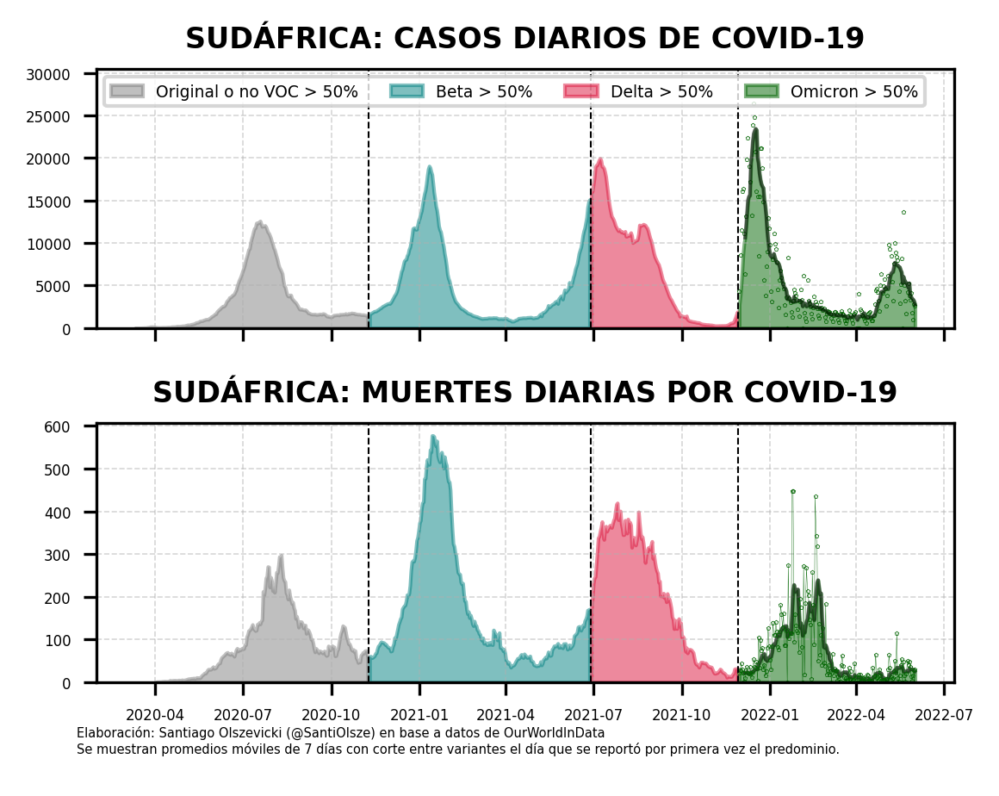

In [6]:
def beta_delta_omicron(pais, country, author = False, author_pos = 400, hosp = False, hoy = False):
    c1 = "gray"
    c2 = "teal"
    c3 =  "crimson"
    c4 = "darkgreen"
    n = 7

    df = OWID[(OWID.location == country)][["datetime","new_deaths", "new_cases","people_vaccinated_per_hundred", "people_fully_vaccinated_per_hundred","hosp_patients"]].ffill()

    beta_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Beta > 50)].head(1).Day.item())
    delta_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Delta > 50)].head(1).Day.item())
    omicron_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Omicron > 50)].head(1).Day.item())
    
    print([beta_50, delta_50,omicron_50])
    
    if not hosp: fig, axs = plt.subplots(2,1, figsize = (4,3), dpi = 300, sharex = True)
    if hosp:fig, axs = plt.subplots(3,1, figsize = (4,3), dpi = 300, sharex = True)

    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime < beta_50, color =c1, alpha = 0.5, label = "Original o no VOC > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > beta_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Beta > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[0].fill_between(df.datetime,df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = 1).mean() 
                    , color = c4, alpha = 1, linewidth = 0, marker = "p", ms = .1)

    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = n).mean(), 
                   color = "k", alpha = 0.5, linewidth = 1)

    axs[0].xaxis.set_tick_params(labelsize=4)
    axs[0].yaxis.set_tick_params(labelsize=4)
    props = dict(boxstyle='round', facecolor='w', alpha=1, edgecolor = "k", linewidth = .5)
    u = df[df.datetime <= omicron_50].people_vaccinated_per_hundred.max().item()
    d = df[df.datetime <= omicron_50].people_fully_vaccinated_per_hundred.max().item()
    s = f"{u:.2f}% con una dosis\n{d:.2f}% con dos dosis"
    #axs[0].text(x = omicron_50, y = df.new_cases.rolling(window = n).mean().max()/1.2
    #            , s = s, fontsize = 3.5,va = "center", ha = "center", bbox = props)

    if country == "South Africa": axs[0].set_ylim(0, df.new_cases.rolling(window = n).mean().max() * 1.3
                                                 )

    axs[0].legend(fontsize = 4.5, loc = "upper left", ncol = 4);

    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = df.datetime < beta_50, color = c1, alpha = 0.5, label = "Original o no VOC o ninguna > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = (df.datetime > beta_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Beta > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = n).mean(), 
                   color = "k", alpha = 0.5, linewidth = 1)
    
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = 1).mean()
                    , color = c4, alpha = 1, linewidth = 0.1, marker = "p", ms = .1)

    axs[1].xaxis.set_tick_params(labelsize=4)
    axs[1].yaxis.set_tick_params(labelsize=4)


    for ax in axs: ax.grid(alpha = 0.5, ls = "--", linewidth = .4); ax.set_ylim(0,)

    axs[0].set_title(f"{pais}: CASOS DIARIOS DE COVID-19",fontsize = 8, fontweight = "bold")
    axs[1].set_title(f"{pais}: MUERTES DIARIAS POR COVID-19",fontsize = 8, fontweight = "bold")
    
    u1 = df.people_vaccinated_per_hundred.fillna(0).max()
    d1 = df.people_fully_vaccinated_per_hundred.fillna(0).max()
    s1 = f"{u1:.2f}% con una dosis\n{d1:.2f}% con dos dosis"
    #axs[0].text(x = datetime.datetime.today(), y = df.new_cases.rolling(window = n).mean().max()/3
    #            , s = s1, fontsize = 4,va = "center", ha = "center", bbox = props)
    
    #axs[0].axvline(datetime.datetime.today(), color = "k", linewidth = 1, ls = "--");
    
    
    if hosp:
        axs[2].fill_between(df.datetime, df.hosp_patients.fillna(0), 
                     where = df.datetime < beta_50, color = c1, alpha = 0.5, label = "Original o no VOC o ninguna > 50%")
        axs[2].fill_between(df.datetime, df.hosp_patients.fillna(0), 
                         where = (df.datetime > beta_50) & (df.datetime < delta_50), color = c2,
                            alpha = 0.5, label = "beta > 50%")
        axs[2].fill_between(df.datetime, df.hosp_patients.fillna(0), 
                         where = df.datetime > delta_50, color = c3, alpha = 0.5, label = "Delta > 50%")

        axs[2].xaxis.set_tick_params(labelsize=4)
        axs[2].yaxis.set_tick_params(labelsize=4)


        axs[2].axvline(beta_50, color = "k", linewidth = 1, ls = "--")
        axs[2].axvline(delta_50, color = "k", linewidth = 1, ls = "--")
        axs[2].set_title(f"{pais}: HOSPITALIZADOS POR COVID-19",fontsize = 8, fontweight = "bold")
        axs[2].set_ylim(0,df.hosp_patients.max()*1.1)
        
    for ax in axs:    
        ax.axvline(beta_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(delta_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(omicron_50, color = "k", linewidth = .5, ls = "--")

    
    fig.tight_layout()
    if author: plt.text(pd.to_datetime("2020-01-10"), -author_pos,
             "Elaboración: Santiago Olszevicki (@SantiOlsze) en base a datos de OurWorldInData\nSe muestran promedios móviles de 7 días con corte entre variantes el día que se reportó por primera vez el predominio.\n", fontsize = 3.5)
    plt.savefig(f"{pais}_variantes", bbox_inches = "tight")
    
beta_delta_omicron("SUDÁFRICA", "South Africa", author = True, author_pos = 200, hosp = False, hoy = False)

In [7]:
OWID[OWID.location == "South Africa"][["datetime","new_cases","new_cases_smoothed","new_deaths","new_deaths_smoothed"]].tail(10)

,datetime,new_cases,new_cases_smoothed,new_deaths,new_deaths_smoothed
158811,2022-05-23,1662.0,5255.571,19.0,25.857
158812,2022-05-24,4227.0,5131.429,50.0,27.143
158813,2022-05-25,5284.0,4717.857,41.0,25.143
158814,2022-05-26,3800.0,5260.714,49.0,32.143
158815,2022-05-27,3274.0,3783.714,36.0,30.286
158816,2022-05-28,4074.0,3648.714,14.0,30.143
158817,2022-05-29,1774.0,3442.143,4.0,30.429
158818,2022-05-30,1004.0,3348.143,16.0,30.000
158819,2022-05-31,2806.0,3145.143,28.0,26.857
158820,2022-06-01,2647.0,2768.429,29.0,25.143


In [8]:
def alpha_delta_omicron(pais, country, author = False, author_pos = 400, hosp = False, hoy = False):
    c1 = "gray"
    c2 = "teal"
    c3 =  "crimson"
    c4 = "darkgreen"
    n = 7

    df = OWID[(OWID.location == country)][["datetime","new_deaths", "new_cases","people_vaccinated_per_hundred", "people_fully_vaccinated_per_hundred","hosp_patients"]].ffill()

    alpha_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Alpha > 50)].head(1).Day.item())
    delta_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Delta > 50)].head(1).Day.item())
    omicron_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Omicron > 50)].head(1).Day.item())
    
    print([alpha_50, delta_50,omicron_50])
    
    if not hosp: fig, axs = plt.subplots(2,1, figsize = (4,3), dpi = 300, sharex = True)
    if hosp:fig, axs = plt.subplots(3,1, figsize = (4,3), dpi = 300, sharex = True)

    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime < alpha_50, color =c1, alpha = 0.5, label = "Original o no VOC > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > alpha_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Alpha > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[0].fill_between(df.datetime,df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = 1).mean() 
                    , color = c4, alpha = 1, linewidth = 0, marker = "p", ms = .1)
    
    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = 1).mean(), 
                   color = c4, alpha = 0.5, linewidth = .1)

    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = n).mean(), 
                   color = "k", alpha = 0.5, linewidth = 1)

    axs[0].xaxis.set_tick_params(labelsize=4)
    axs[0].yaxis.set_tick_params(labelsize=4)
    props = dict(boxstyle='round', facecolor='w', alpha=1, edgecolor = "k", linewidth = .5)
    u = df[df.datetime <= omicron_50].people_vaccinated_per_hundred.max().item()
    d = df[df.datetime <= omicron_50].people_fully_vaccinated_per_hundred.max().item()
    s = f"{u:.2f}% con una dosis\n{d:.2f}% con dos dosis"
    #axs[0].text(x = omicron_50, y = df.new_cases.rolling(window = n).mean().max()/1.2
    #            , s = s, fontsize = 3.5,va = "center", ha = "center", bbox = props)

    if country == "South Africa": axs[0].set_ylim(0, df.new_cases.rolling(window = n).mean().max() * 1.3
                                                 )

    axs[0].legend(fontsize = 4.5, loc = "upper left", ncol = 4);
    if hosp: axs[0].legend(fontsize = 4.5, loc = "upper left", ncol = 1);

    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = df.datetime < alpha_50, color = c1, alpha = 0.5, label = "Original o no VOC o ninguna > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = (df.datetime > alpha_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Alpha > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = n).mean(), 
                   color = "k", alpha = 0.5, linewidth = 1)
    
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = 1).mean()
                    , color = c4, alpha = 1, linewidth = 0, marker = "p", ms = .1)
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = 1).mean()
                    , color = c4, alpha = 1, linewidth = 0.1, marker = "p", ms = .1)

    axs[1].xaxis.set_tick_params(labelsize=4)
    axs[1].yaxis.set_tick_params(labelsize=4)


    for ax in axs: ax.grid(alpha = 0.5, ls = "--", linewidth = .4); ax.set_ylim(0,)

    axs[0].set_title(f"{pais}: CASOS DIARIOS DE COVID-19",fontsize = 8, fontweight = "bold")
    axs[1].set_title(f"{pais}: MUERTES DIARIAS CON COVID-19",fontsize = 8, fontweight = "bold")
    
    u1 = df.people_vaccinated_per_hundred.fillna(0).max()
    d1 = df.people_fully_vaccinated_per_hundred.fillna(0).max()
    s1 = f"{u1:.2f}% con una dosis\n{d1:.2f}% con dos dosis"
    #axs[0].text(x = datetime.datetime.today(), y = df.new_cases.rolling(window = n).mean().max()/3
    #            , s = s1, fontsize = 4,va = "center", ha = "center", bbox = props)
    
    #axs[0].axvline(datetime.datetime.today(), color = "k", linewidth = 1, ls = "--");
    
    
    if hosp:
        axs[2].fill_between(df.datetime, df.hosp_patients.fillna(0), 
                     where = df.datetime < alpha_50, color = c1, alpha = 0.5, label = "Original o no VOC o ninguna > 50%")
        axs[2].fill_between(df.datetime, df.hosp_patients.fillna(0), 
                         where = (df.datetime > alpha_50) & (df.datetime < delta_50), color = c2,
                            alpha = 0.5, label = "beta > 50%")
        axs[2].fill_between(df.datetime, df.hosp_patients.fillna(0), 
                         where =(df.datetime > delta_50) & (df.datetime < omicron_50), color = c3, alpha = 0.5, label = "Delta > 50%")

        axs[2].fill_between(df.datetime, df.hosp_patients.fillna(0), 
                         where =(df.datetime > omicron_50), color = c4, alpha = 0.5, label = "Omicron > 50%")

        
        axs[2].xaxis.set_tick_params(labelsize=4)
        axs[2].yaxis.set_tick_params(labelsize=4)


        axs[2].axvline(alpha_50, color = "k", linewidth = 1, ls = "--")
        axs[2].axvline(delta_50, color = "k", linewidth = 1, ls = "--")
        axs[2].set_title(f"{pais}: HOSPITALIZADOS CON COVID-19",fontsize = 8, fontweight = "bold")
        axs[2].set_ylim(0,df.hosp_patients.max()*1.1)
        axs[2].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].hosp_patients.fillna(0).rolling(window = 1).mean()
                    , color = c4, alpha = 1, linewidth = 0.1, marker = "p", ms = .1)
        
    for ax in axs:    
        ax.axvline(alpha_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(delta_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(omicron_50, color = "k", linewidth = .5, ls = "--")

    
    fig.tight_layout()
    if author: plt.text(pd.to_datetime("2020-01-10"), -author_pos,
             "Elaboración: Santiago Olszevicki (@SantiOlsze) en base a datos de OurWorldInData\nSe muestran promedios móviles de 7 días con corte entre variantes el día que se reportó por primera vez el predominio.\nLas hospitalizaciones pueden reflejar pacientes con COVID pero tratados primariamente por otra condición" , fontsize = 3.5)
    plt.savefig(f"{pais}_variantes", bbox_inches = "tight")
    

[Timestamp('2021-01-04 00:00:00'), Timestamp('2021-05-31 00:00:00'), Timestamp('2021-12-27 00:00:00')]


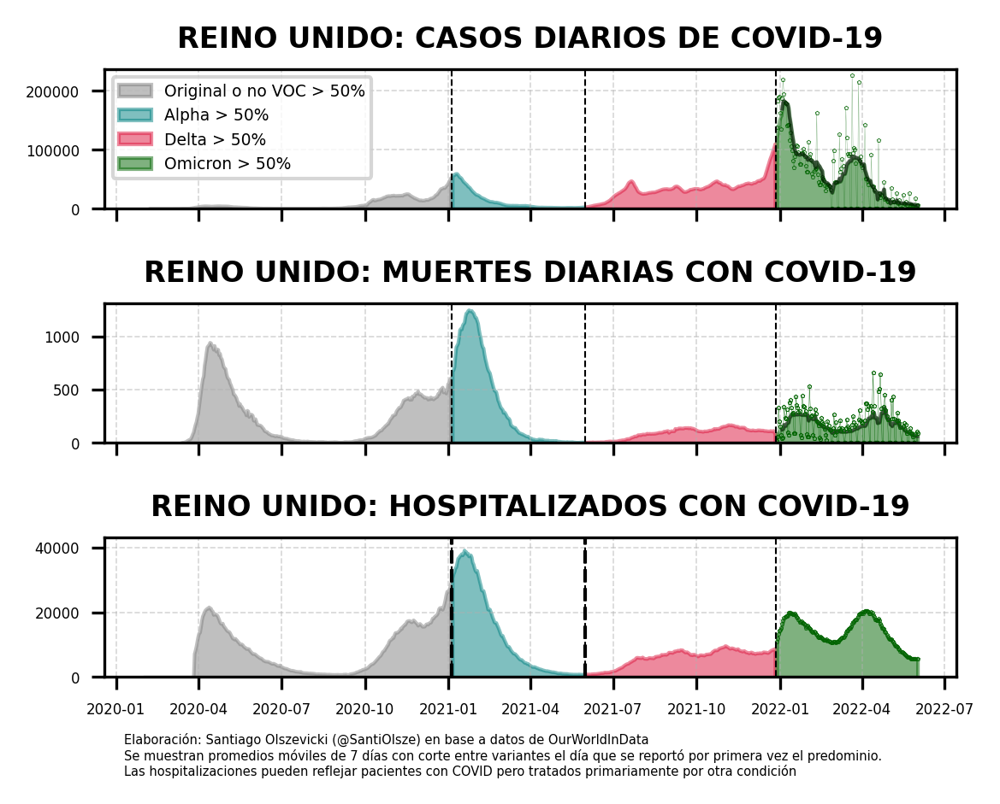

In [9]:
alpha_delta_omicron("REINO UNIDO", "United Kingdom", author = True, author_pos = 30500, hosp = True, hoy = False)

In [10]:
OWID[OWID.location == "United Kingdom"][["datetime","new_cases","new_cases_smoothed","new_deaths","new_deaths_smoothed","hosp_patients"]].tail(15)

,datetime,new_cases,new_cases_smoothed,new_deaths,new_deaths_smoothed,hosp_patients
179848,2022-05-18,8041.0,8834.857,127.0,115.286,6903.0
179849,2022-05-19,12199.0,8463.286,169.0,112.857,6748.0
179850,2022-05-20,6542.0,8456.857,89.0,104.000,6534.0
179851,2022-05-21,0.0,8456.857,0.0,104.000,6312.0
179852,2022-05-22,0.0,8456.857,0.0,104.000,6262.0
179853,2022-05-23,25967.0,8763.571,108.0,96.857,6248.0
179854,2022-05-24,6442.0,8455.857,136.0,89.857,5871.0
179855,2022-05-25,6104.0,8179.143,92.0,84.857,5722.0
179856,2022-05-26,NaN,NaN,91.0,73.714,5584.0
179857,2022-05-27,4828.0,6191.571,61.0,69.714,NaN


In [11]:
106511.714/181702.857

0.5861862370166255

[Timestamp('2021-01-11 00:00:00'), Timestamp('2021-06-14 00:00:00'), Timestamp('2021-12-27 00:00:00')]


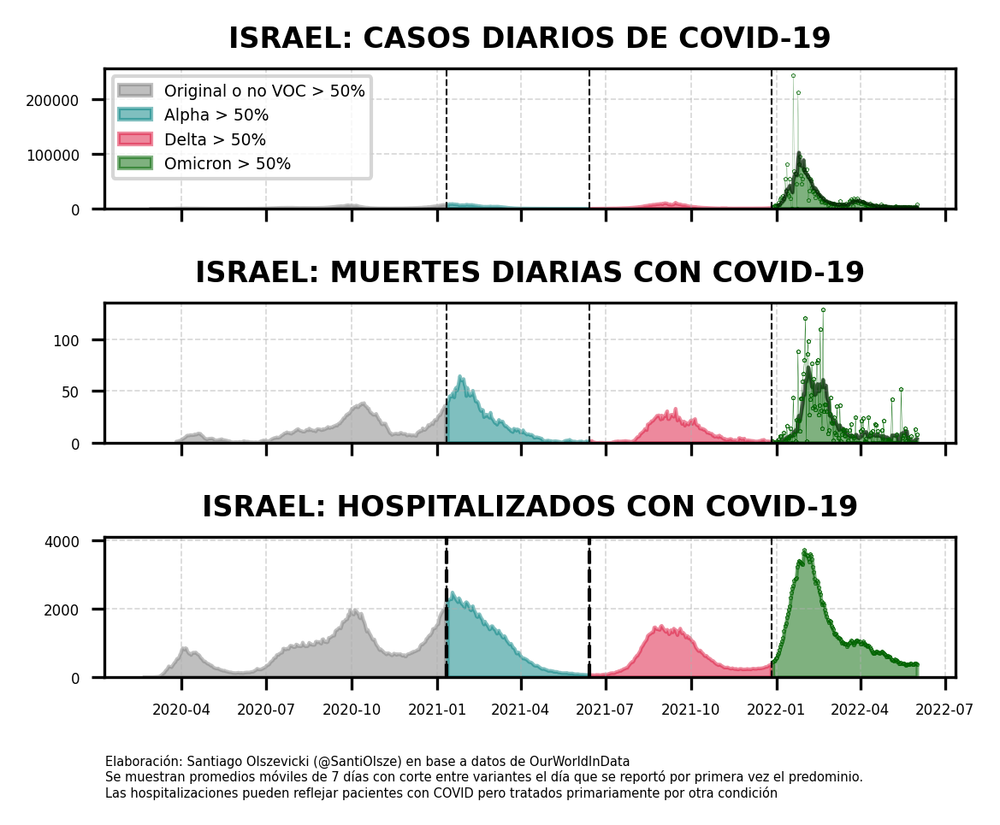

In [12]:
alpha_delta_omicron("ISRAEL", "Israel", author = True, author_pos = 3500, hosp = True, hoy = False)

In [13]:

OWID[OWID.location == "Israel"][["datetime","new_cases","new_cases_smoothed","new_deaths","new_deaths_smoothed","hosp_patients"]].tail(15)

,datetime,new_cases,new_cases_smoothed,new_deaths,new_deaths_smoothed,hosp_patients
85562,2022-05-18,2128.0,2123.857,0.0,9.143,386.0
85563,2022-05-19,2112.0,2149.571,14.0,11.143,364.0
85564,2022-05-20,1904.0,2099.571,1.0,11.286,353.0
85565,2022-05-21,1639.0,2179.000,0.0,11.286,362.0
85566,2022-05-22,1698.0,1988.429,5.0,4.571,372.0
85567,2022-05-23,2727.0,2063.857,1.0,4.000,370.0
85568,2022-05-24,1979.0,2026.714,0.0,3.000,382.0
85569,2022-05-25,975.0,1862.000,0.0,3.000,398.0
85570,2022-05-26,2878.0,1971.429,6.0,1.857,388.0
85571,2022-05-27,0.0,1699.429,0.0,1.714,361.0


[Timestamp('2021-01-11 00:00:00'), Timestamp('2021-06-14 00:00:00'), Timestamp('2021-12-27 00:00:00')]


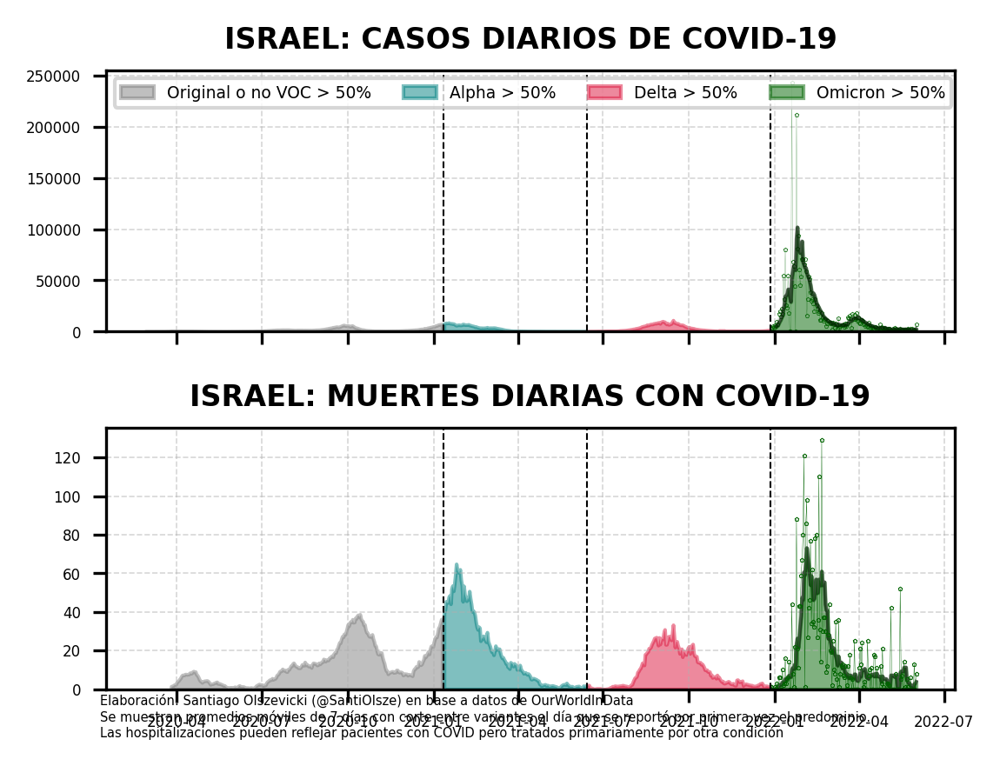

In [14]:
alpha_delta_omicron("ISRAEL", "Israel", author = True, author_pos = 25, hosp = False, hoy = False)

In [15]:
def gamma_delta_omicron(pais, country, author = False, author_pos = 300, hosp = False, hoy = False):
    c1 = "gray"
    c2 = "teal"
    c3 =  "crimson"
    c4 = "darkgreen"
    n = 7

    df = OWID[(OWID.location == country)][["datetime","new_deaths", "new_cases","people_vaccinated_per_hundred", "people_fully_vaccinated_per_hundred","hosp_patients"]].ffill()

    gamma_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Gamma > 50)].head(1).Day.item())
    delta_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Delta > 50)].head(1).Day.item())
    omicron_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Omicron > 50)].head(1).Day.item())
    
    print([gamma_50, delta_50,omicron_50])
    
    if not hosp: fig, axs = plt.subplots(2,1, figsize = (4,3), dpi = 300, sharex = True)
    if hosp:fig, axs = plt.subplots(3,1, figsize = (4,3), dpi = 300, sharex = True)

    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime < gamma_50, color =c1, alpha = 0.5, label = "Original o no VOC > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > gamma_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Gamma > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[0].fill_between(df.datetime,df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = 1).mean() 
                    , color = c4, alpha = 1, linewidth = 0, marker = "p", ms = .1)

    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = n).mean(), 
                   color = "k", alpha = 0.5, linewidth = 1)

    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = 1).mean()
                    , color = c4, alpha = 1, linewidth = 0.1, marker = "p", ms = .1)
    
    axs[0].xaxis.set_tick_params(labelsize=4)
    axs[0].yaxis.set_tick_params(labelsize=4)
    props = dict(boxstyle='round', facecolor='w', gamma=1, edgecolor = "k", linewidth = .5)
    u = df[df.datetime <= omicron_50].people_vaccinated_per_hundred.max().item()
    d = df[df.datetime <= omicron_50].people_fully_vaccinated_per_hundred.max().item()
    s = f"{u:.2f}% con una dosis\n{d:.2f}% con dos dosis"
    #axs[0].text(x = omicron_50, y = df.new_cases.rolling(window = n).mean().max()/1.2
    #            , s = s, fontsize = 3.5,va = "center", ha = "center", bbox = props)

    if country == "South Africa": axs[0].set_ylim(0, df.new_cases.rolling(window = n).mean().max() * 1.3
                                                 )

    axs[0].legend(fontsize = 4.3, loc = "upper left", ncol = 4);

    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = df.datetime < gamma_50, color = c1, alpha = 0.5, label = "Original o no VOC o ninguna > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = (df.datetime > gamma_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Gamma > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean(), 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = n).mean(), 
                   color = "k", alpha = 0.5, linewidth = 1)
    
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = 1).mean()
                    , color = c4, alpha = 1, linewidth = 0.1, marker = "p", ms = .1)

    axs[1].xaxis.set_tick_params(labelsize=4)
    axs[1].yaxis.set_tick_params(labelsize=4)


    for ax in axs: ax.grid(alpha = 0.5, ls = "--", linewidth = .4); ax.set_ylim(0,)

    axs[0].set_title(f"{pais}: CASOS DIARIOS DE COVID-19",fontsize = 8, fontweight = "bold")
    axs[1].set_title(f"{pais}: MUERTES DIARIAS POR COVID-19",fontsize = 8, fontweight = "bold")
    
    u1 = df.people_vaccinated_per_hundred.fillna(0).max()
    d1 = df.people_fully_vaccinated_per_hundred.fillna(0).max()
    s1 = f"{u1:.2f}% con una dosis\n{d1:.2f}% con dos dosis"
    #axs[0].text(x = datetime.datetime.today(), y = df.new_cases.rolling(window = n).mean().max()/3
    #            , s = s1, fontsize = 4,va = "center", ha = "center", bbox = props)
    
    #axs[0].axvline(datetime.datetime.today(), color = "k", linewidth = 1, ls = "--");
    
    

    for ax in axs:    
        ax.axvline(gamma_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(delta_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(omicron_50, color = "k", linewidth = .5, ls = "--")

    
    fig.tight_layout()
    if author: plt.text(pd.to_datetime("2020-01-10"), -author_pos,
             "Elaboración: Santiago Olszevicki (@SantiOlsze) en base a datos de OurWorldInData\nSe muestran promedios móviles de 7 días con corte entre variantes el día que se reportó por primera vez el predominio.\n", fontsize = 3.5)
    plt.savefig(f"{pais}_variantes", bbox_inches = "tight")
    

In [16]:
def abs_formatter(x, pos):
    return abs(int(x))

[Timestamp('2021-05-17 00:00:00'), Timestamp('2021-11-01 00:00:00'), Timestamp('2021-12-27 00:00:00')]


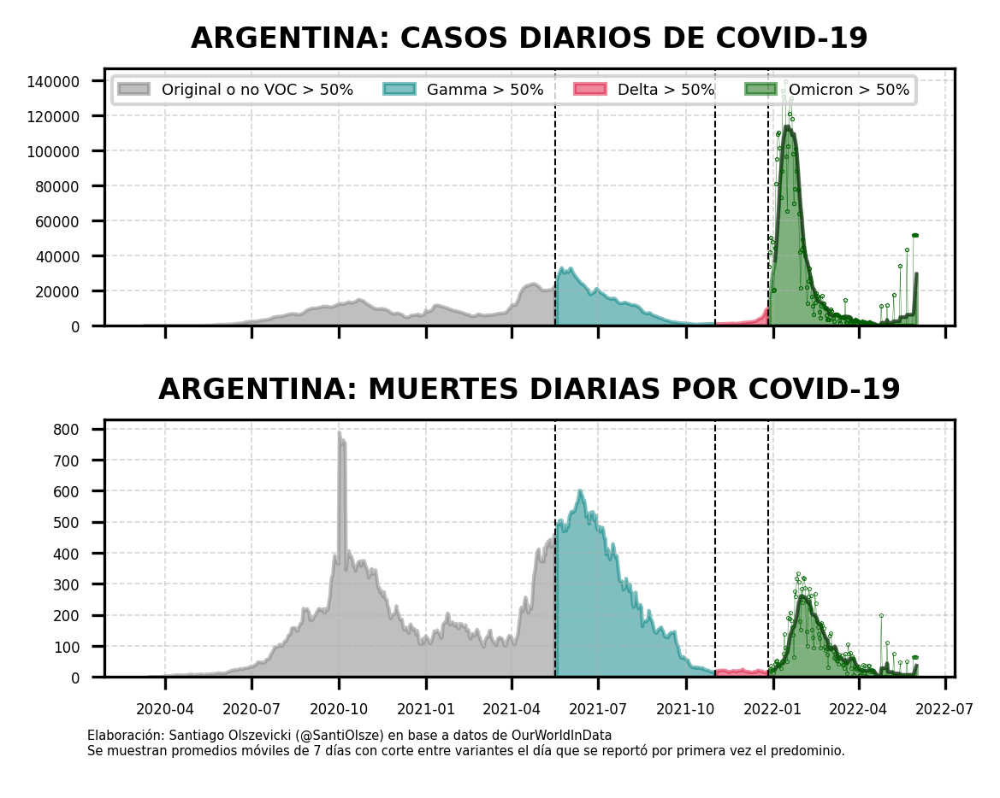

In [17]:
gamma_delta_omicron("ARGENTINA","Argentina", True)

In [18]:
#new_row = {"location":"Argentina",
#"datetime" : pd.to_datetime("2022-02-13"),
#"new_cases": 6289,
#"new_deaths" : 94}
#OWID = OWID.append(new_row,ignore_index=True)

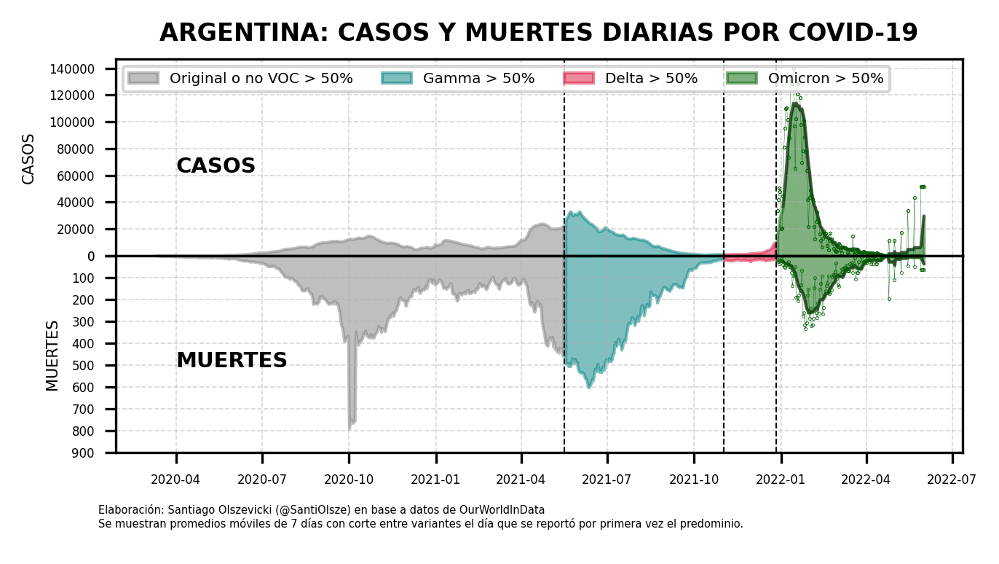

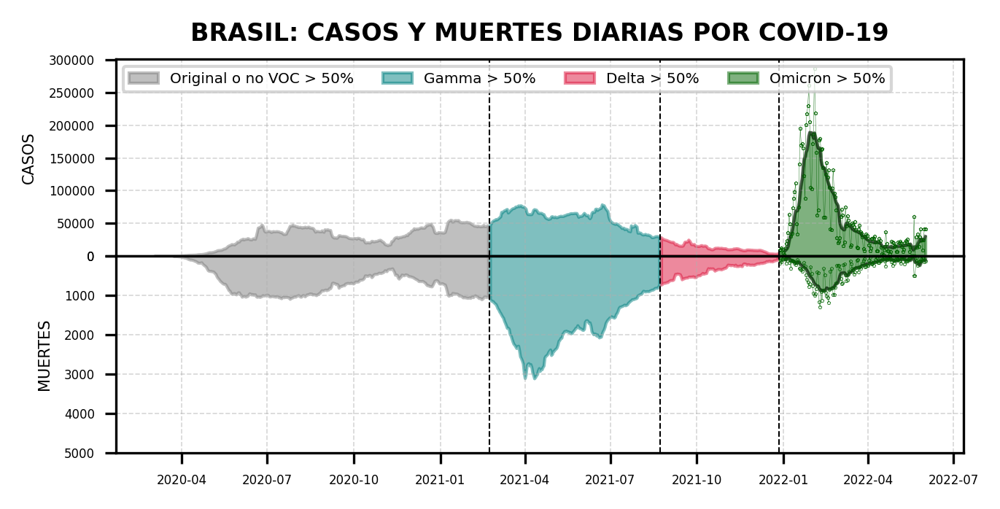

In [19]:
def gamma_delta_omicron_mirror(pais, country, author = False, author_pos = 300, hosp = False, hoy = False):
    c1 = "gray"
    c2 = "teal"
    c3 =  "crimson"
    c4 = "darkgreen"
    n = 7

    df = OWID[(OWID.location == country)][["datetime","new_deaths", "new_cases","people_vaccinated_per_hundred", "people_fully_vaccinated_per_hundred","hosp_patients"]].ffill()

    gamma_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Gamma > 50)].head(1).Day.item())
    delta_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Delta > 50)].head(1).Day.item())
    omicron_50 = pd.to_datetime(variantes[(variantes.Entity == country) & (variantes.Omicron > 50)].head(1).Day.item())
    
    #print([gamma_50, delta_50,omicron_50])
    
    if not hosp: fig, axs = plt.subplots(2,1, figsize = (5,2), dpi = 300, sharex = True)
    if hosp:fig, axs = plt.subplots(3,1, figsize = (5,3), dpi = 300, sharex = True)

    fig.subplots_adjust(wspace = 0, hspace = 0, bottom = 0, top = 0.90)

    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime < gamma_50, color =c1, alpha = 0.5, label = "Original o no VOC > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > gamma_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Gamma > 50%")
    axs[0].fill_between(df.datetime, df.new_cases.rolling(window = n).mean(), 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[0].fill_between(df.datetime,df.new_cases.rolling(window = n).mean(), 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = 1).mean() 
                    , color = c4, alpha = 1, linewidth = 0, marker = "p", ms = .1)

    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = n).mean(), 
                   color = "k", alpha = 0.5, linewidth = 1)

    axs[0].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_cases.rolling(window = 1).mean()
                    , color = c4, alpha = 1, linewidth = 0.1, marker = "p", ms = .1)
    
    axs[0].xaxis.set_tick_params(labelsize=4)
    axs[0].yaxis.set_tick_params(labelsize=4)
    props = dict(boxstyle='round', facecolor='w', gamma=1, edgecolor = "k", linewidth = .5)
    u = df[df.datetime <= omicron_50].people_vaccinated_per_hundred.max().item()
    d = df[df.datetime <= omicron_50].people_fully_vaccinated_per_hundred.max().item()
    s = f"{u:.2f}% con una dosis\n{d:.2f}% con dos dosis"
    #axs[0].text(x = omicron_50, y = df.new_cases.rolling(window = n).mean().max()/1.2
    #            , s = s, fontsize = 3.5,va = "center", ha = "center", bbox = props)

    if country == "South Africa": axs[0].set_ylim(0, df.new_cases.rolling(window = n).mean().max() * 1.3
                                                 )

    axs[0].legend(fontsize = 4.8, loc = "upper left", ncol = 4);

    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean()*-1, 
                     where = df.datetime < gamma_50, color = c1, alpha = 0.5, label = "Original o no VOC o ninguna > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean()*-1, 
                     where = (df.datetime > gamma_50) & (df.datetime < delta_50), color = c2,
                        alpha = 0.5, label = "Gamma > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean()*-1, 
                     where = (df.datetime > delta_50) & (df.datetime < omicron_50), color = c3,
                        alpha = 0.5, label = "Delta > 50%")
    axs[1].fill_between(df.datetime, df.new_deaths.rolling(window = n).mean()*-1, 
                     where = df.datetime > omicron_50, color = c4, alpha = 0.5, label = "Omicron > 50%")
    
    axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = n).mean()*-1, 
                   color = "k", alpha = 0.5, linewidth = 1)
    
    #axs[1].plot(df[df.datetime > omicron_50].datetime, df[df.datetime > omicron_50].new_deaths.rolling(window = 1).mean()*-1
    #                , color = c4, alpha = 1, linewidth = 0.1, marker = "p", ms = .1)

    axs[1].xaxis.set_tick_params(labelsize=4)
    axs[1].yaxis.set_tick_params(labelsize=4)


    for ax in axs: ax.grid(alpha = 0.5, ls = "--", linewidth = .4); #
    
    axs[0].set_ylim(0,)


    axs[0].set_title(f"{pais}: CASOS Y MUERTES DIARIAS POR COVID-19",fontsize = 8, fontweight = "bold")
    #axs[1].set_title(f"{pais}: MUERTES DIARIAS POR COVID-19",fontsize = 8, fontweight = "bold")
    
    u1 = df.people_vaccinated_per_hundred.fillna(0).max()
    d1 = df.people_fully_vaccinated_per_hundred.fillna(0).max()
    s1 = f"{u1:.2f}% con una dosis\n{d1:.2f}% con dos dosis"
    #axs[0].text(x = datetime.datetime.today(), y = df.new_cases.rolling(window = n).mean().max()/3
    #            , s = s1, fontsize = 4,va = "center", ha = "center", bbox = props)
    
    #axs[0].axvline(datetime.datetime.today(), color = "k", linewidth = 1, ls = "--");
    

    axs[0].set_ylabel("CASOS", fontsize = 5)
    axs[1].set_ylabel("MUERTES", fontsize = 5)
    for ax in axs:    
        ax.axvline(gamma_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(delta_50, color = "k", linewidth = .5, ls = "--")
        ax.axvline(omicron_50, color = "k", linewidth = .5, ls = "--")

    
    #fig.tight_layout()
    if author: plt.text(pd.to_datetime("2020-01-10"), -author_pos,
             "Elaboración: Santiago Olszevicki (@SantiOlsze) en base a datos de OurWorldInData\nSe muestran promedios móviles de 7 días con corte entre variantes el día que se reportó por primera vez el predominio.\n", fontsize = 3.5)
    plt.savefig(f"{pais}_variantes", bbox_inches = "tight")
    
    if country == "Argentina":
        axs[0].text(x = pd.to_datetime("2020-04-01"), y = 62000, s = "CASOS", fontweight = "bold", fontsize = 7)
        axs[1].text(x = pd.to_datetime("2020-04-01"), y = -510, s = "MUERTES", fontweight = "bold", fontsize = 7)
        plt.yticks(np.linspace(-900,0,10), [abs(int(i)) for i in np.linspace(-900,0,10)])
        axs[1].set_ylim(-900,0);

    else:
        axs[1].set_ylim(-5000,0)
        axs[1].yaxis.set_major_formatter(FuncFormatter(abs_formatter))
        
    plt.savefig(f"{pais}_variantes", bbox_inches = "tight")


gamma_delta_omicron_mirror("ARGENTINA","Argentina", True, 1300);
gamma_delta_omicron_mirror("BRASIL","Brazil", False, 1300);

In [19]:
OWID[(OWID.location == "Argentina")
    & (OWID.datetime <= pd.to_datetime("2020-12-01"))]["new_cases"].sum()

1432570.0

In [20]:
OWID[(OWID.location == "Argentina")
      & (OWID.datetime > pd.to_datetime("2020-12-01"))
    & (OWID.datetime < pd.to_datetime("2021-04-01"))]["new_cases"].sum()

916251.0

In [21]:
OWID[(OWID.location == "Argentina")
      & (OWID.datetime >= pd.to_datetime("2021-04-01"))
    & (OWID.datetime < pd.to_datetime("2021-11-01"))]["new_cases"].sum()



2939986.0

In [22]:
OWID[(OWID.location == "Argentina")
    & (OWID.datetime >= pd.to_datetime("2021-11-01"))]["new_cases"].sum()



3517340.0

In [23]:
261.286 / 602.429

0.43372082021283836

In [24]:
6734.0 / 60092.0

0.11206150569127338

In [28]:
OWID[OWID.location == "Argentina"][["datetime","new_cases","new_cases_smoothed","new_deaths","new_deaths_smoothed","total_cases"]].tail(20).new_deaths.sum()

2357.0

In [29]:
1640.0/ 118809 * 100

1.3803668072284085

In [30]:
p.sort_values(["Entity","date"], inplace = True)
p = p[p.date >= pd.to_datetime("2021-01-01")]

NameError: name 'p' is not defined

In [31]:
p = p[p.population > 5000000]
#p = p.fillna(method='bfill')
p = p.append(OWID[OWID.location == "Argentina"][["location","continent","date","people_vaccinated_per_hundred","people_fully_vaccinated_per_hundred","population"]].rename(columns = {"location":"Entity"}))



NameError: name 'p' is not defined

In [32]:
# import pickle
# paises_dict = {i:translate(i)[0] for i in set(p.Entity)}
# a_file = open("paises_dict.pkl", "wb")
# pickle.dump(paises_dict, a_file)
# a_file.close()
import pickle

a_file = open("paises_dict.pkl", "rb")
paises_dict = pickle.load(a_file)

p["Entity"] = p["Entity"].map(paises_dict)

NameError: name 'p' is not defined

In [33]:
p["date"] = pd.to_datetime(p["date"])
p = p[p.date >= pd.to_datetime("2021-01-01")]
p = p[p.Entity != "China"]
p["continent"] = p.continent.map({'Europe': 'Europa',
     'South America': 'Sudamérica',
     'North America': 'Norteamérica',
     'Africa': 'Africa',
     'Oceania': 'Oceanía',
     'Asia': 'Asia'})

NameError: name 'p' is not defined

In [23]:
p = p.rename(columns = {'Entity':"País", 'continent':"continente", 'date':"fecha", 'people_vaccinated_per_hundred':"Porcentaje con al menos una dosis",
       'people_fully_vaccinated_per_hundred':"Porcentaje con esquema completo","population":'Población'})
#p["fecha"] = [i.strftime('%d/%m/%Y') for i in p.fecha]
p = p[p.fecha != '01/01/2021']
exclude_india = True
if exclude_india: p = p[p.País != "India"]
p.to_csv("hans.csv", index = None)

In [39]:
p_fixed = pd.DataFrame()
for P in tqdm(list(set(p.País))):
    t = p[p.País == P].fillna(method = "ffill").fillna(0)
    for i,r in t.iterrows(): p_fixed = p_fixed.append(r) 
p_fixed[["País","continente","fecha","Porcentaje con al menos una dosis","Porcentaje con esquema completo",'Población']].to_csv("hans.csv", index = None)

In [41]:
hans_total = OWID[OWID.datetime > pd.to_datetime("2021-01-01")][["location","continent","date","people_vaccinated_per_hundred","people_fully_vaccinated_per_hundred","population"]].rename(columns = {"location":"Entity"})

hans_total = hans_total[pd.notnull(hans_total.continent)]
#hans_total= hans_total[pd.notnull(hans_total)]
hans_total = hans_total[hans_total.population > 5000000]
hans_total = hans_total[hans_total.population < 1000000000].rename(columns = {'Entity':"País", 'continent':"continente", 'date':"fecha", 'people_vaccinated_per_hundred':"Porcentaje con al menos una dosis",       'people_fully_vaccinated_per_hundred':"Porcentaje con esquema completo","population":'Población'})
hans_total["continente"] = hans_total.continente.map({'Europe': 'Europa',
     'South America': 'Sudamérica',
     'North America': 'Norteamérica',
     'Africa': 'Africa',
     'Oceania': 'Oceanía',
     'Asia': 'Asia'})

import pickle

a_file = open("paises_dict.pkl", "rb")
paises_dict = pickle.load(a_file)

hans_total["País"] = [paises_dict[i] if i in paises_dict else i for i in hans_total["País"]]

hans_total.to_csv("hans_todos.csv", index = None)

In [43]:
h_fixed = pd.DataFrame()
for P in tqdm(list(set(hans_total.País))):
    t = hans_total[hans_total.País == P].fillna(method = "ffill").fillna(0)
    for i,r in t.iterrows(): h_fixed = h_fixed.append(r) 
h_fixed[["País","continente","fecha","Porcentaje con al menos una dosis","Porcentaje con esquema completo",'Población']].to_csv("hans_total.csv", index = None)

  0%|          | 0/120 [00:00<?, ?it/s]

In [9]:
v = OWID[["location","people_vaccinated_per_hundred"]].groupby("location", as_index = False).max()[["location","people_vaccinated_per_hundred"]]

In [10]:
v

,location,people_vaccinated_per_hundred
0,Afghanistan,6.06
1,Africa,8.74
2,Albania,35.19
3,Algeria,14.24
4,Andorra,70.21
...,...,...
228,Wallis and Futuna,53.15
229,World,49.41
230,Yemen,1.05
231,Zambia,1.64


In [15]:
m = OWID[(OWID.date == "2021-10-30")
    &
    (OWID.continent == "Europe")][["location","new_deaths_smoothed_per_million","population"]]

In [17]:
v.merge(m, on = "location").to_csv("muert_vac_europa.csv")

In [57]:
b = OWID[OWID.continent.notnull()][["location","population","continent","people_vaccinated","total_boosters"]].groupby(["location","continent"], as_index = False).max()[["location","continent","population","people_vaccinated","total_boosters"]].fillna(0)
#b = b[b.population > 3000000]

In [58]:
b

,location,continent,population,people_vaccinated,total_boosters
0,Afghanistan,Asia,39835428.0,3398410.0,0.0
1,Albania,Europe,2872934.0,1025180.0,2799.0
2,Algeria,Africa,44616626.0,6381144.0,0.0
3,Andorra,Europe,77354.0,54383.0,0.0
4,Angola,Africa,33933611.0,4846094.0,0.0
...,...,...,...,...,...
219,Vietnam,Asia,98168829.0,58807646.0,0.0
220,Wallis and Futuna,Oceania,11094.0,5938.0,0.0
221,Yemen,Asia,30490639.0,331778.0,0.0
222,Zambia,Africa,18920657.0,311049.0,0.0


In [61]:
bc = b.groupby("continent").sum()

In [65]:
bc["at_least_one_dose"] = bc.people_vaccinated / bc.population * 100
bc["boostered"] = bc.total_boosters / bc.population * 100
bc[bc.columns[-2:]].to_csv("booster.csv")

In [66]:
bc

,population,people_vaccinated,total_boosters,at_least_one_dose,boostered
continent,,,,,
Africa,1.371693e+09,1.259197e+08,153756.0,9.179875,0.011209
Asia,4.652558e+09,2.678932e+09,25322226.0,57.579758,0.544265
Europe,7.508322e+08,4.489087e+08,25366944.0,59.788155,3.378510
North America,5.928291e+08,3.676277e+08,23799160.0,62.012438,4.014506
Oceania,4.293680e+07,2.456186e+07,114673.0,57.204675,0.267074
South America,4.339537e+08,2.929703e+08,15794089.0,67.511888,3.639579


In [40]:
m = OWID[["location","total_boosters","population"]].groupby("location", as_index=  False).max()[["location","total_boosters","population"]]

In [41]:
c = OWID[OWID.continent.isnull()][["location","total_vaccinations","population"]].groupby("location", as_index=  False).max()[["location","total_vaccinations","population"]]

In [42]:
3.865800e+07

38658000.0

In [43]:
m.sort_values("total_boosters", ascending = False)

,location,total_boosters,population
233,World,135097365.0,7.874966e+09
225,Upper middle income,68856317.0,2.597321e+09
91,High income,63550798.0,1.219581e+09
11,Asia,63507556.0,4.678445e+09
43,China,37973000.0,1.444216e+09
...,...,...,...
231,Vietnam,NaN,9.816883e+07
232,Wallis and Futuna,NaN,1.109400e+04
234,Yemen,NaN,3.049064e+07
235,Zambia,NaN,1.892066e+07


In [54]:
m[m.location.isin(["Europe","United States"])].sum()

location          EuropeUnited States
total_boosters             5.0312e+07
population                1.08188e+09
dtype: object

In [56]:
5.0312e+07

50312000.0

In [4]:
OWID[OWID.continent.isnull()][["location","total_boosters"]].groupby("location").max()

,total_boosters
location,
Africa,233093.0
Asia,66070627.0
Europe,35062581.0
European Union,19199663.0
High income,78223858.0
International,NaN
Low income,NaN
Lower middle income,3547343.0
North America,31156208.0


<AxesSubplot:xlabel='median_age', ylabel='people_vaccinated_per_hundred'>

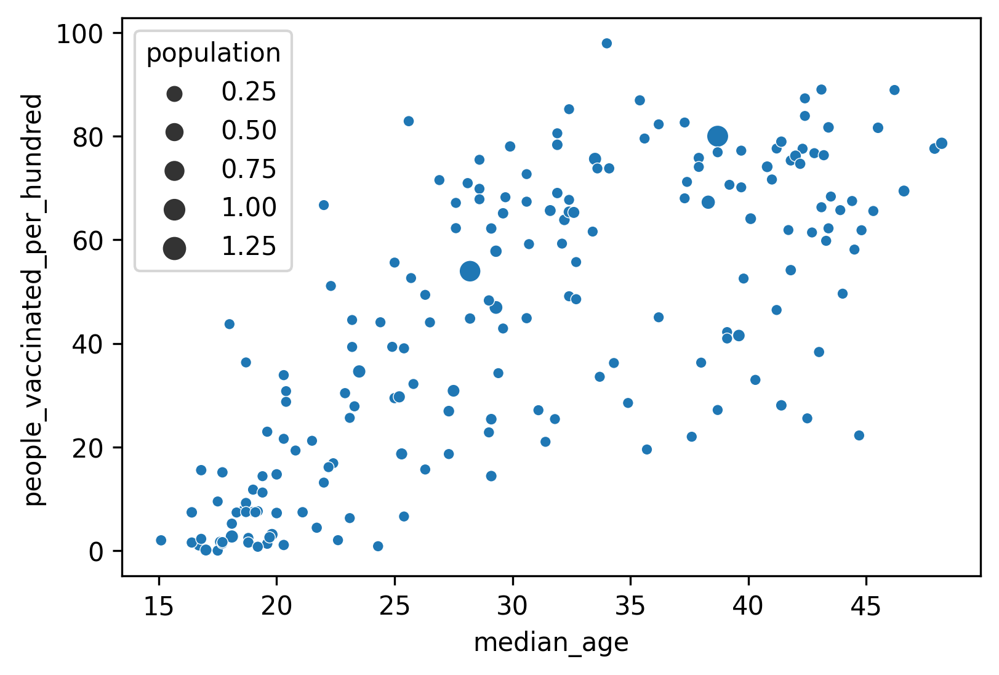

In [15]:
plt.figure(dpi = 300)
sns.scatterplot(data = d, x = "median_age", y = "people_vaccinated_per_hundred", size = "population")

In [22]:
d = OWID[OWID.continent.notnull()][["location","people_vaccinated_per_hundred","median_age","aged_65_older","population","continent"]].groupby("location").max()[["people_vaccinated_per_hundred","median_age","aged_65_older","population","continent"]]
#d.index = [translate(i) for i in d.index]
d[(d.aged_65_older > 0) &(d.median_age > 0) & (d.population > 1000000)].to_csv("data_edad_vac.csv")
d.groupby("continent").mean()

,people_vaccinated_per_hundred,median_age,aged_65_older,population
continent,,,,
Africa,23.980370,21.077778,3.669278,2.493988e+07
Asia,61.487000,30.575510,6.603979,9.495135e+07
Europe,68.253200,42.070000,17.719625,1.471906e+07
North America,59.631176,32.513043,9.341565,1.693814e+07
Oceania,63.106111,27.291667,7.218250,2.057260e+06
South America,72.127692,30.216667,8.277250,3.338105e+07


In [23]:

variantes[variantes.Omicron > 50]

,Entity,Code,Day,Beta,Epsilon,Gamma,Kappa,Iota,Eta,Delta,Alpha,non_who,Lambda,Mu,Omicron,total
56,Argentina,ARG,2021-12-27,0.000000,0.0,0.0,0.0,0.0,0.0,12.765957,0.000000,2.127660,0.000000,0.000000,85.106383,94
120,Australia,AUS,2021-12-27,0.000000,0.0,0.0,0.0,0.0,0.0,23.522596,0.000000,0.057937,0.000000,0.000000,76.419467,1726
249,Belgium,BEL,2022-01-05,0.000000,0.0,0.0,0.0,0.0,0.0,49.152542,0.000000,0.000000,0.000000,0.000000,50.847458,59
283,Botswana,BWA,2021-12-13,0.000000,0.0,0.0,0.0,0.0,0.0,15.808824,0.000000,8.088235,0.000000,0.000000,76.102941,272
284,Botswana,BWA,2021-12-27,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.699301,0.000000,0.000000,99.300699,143
328,Brazil,BRA,2021-12-27,0.000000,0.0,0.0,0.0,0.0,0.0,41.666667,0.000000,0.000000,0.000000,0.000000,58.333333,252
463,Chile,CHL,2021-12-27,0.000000,0.0,0.0,0.0,0.0,0.0,47.817460,0.000000,0.198413,0.198413,0.198413,51.587302,504
786,France,FRA,2022-01-05,0.000000,0.0,0.0,0.0,0.0,0.0,19.658120,0.000000,0.000000,0.000000,0.000000,80.341880,117
870,Ghana,GHA,2021-11-29,0.000000,0.0,0.0,0.0,0.0,0.0,28.947368,0.000000,2.631579,0.000000,0.000000,68.421053,76
871,Ghana,GHA,2021-12-13,0.000000,0.0,0.0,0.0,0.0,0.0,16.666667,0.000000,5.555556,0.000000,0.000000,77.777778,36


In [24]:
za = OWID[OWID.location == "South Africa"].tail(20)

In [25]:
za

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million,datetime
133809,ZAF,Africa,South Africa,2022-01-20,3572860.0,8282.0,3721.714,93846.0,275.0,122.429,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-20
133810,ZAF,Africa,South Africa,2022-01-21,3576379.0,3519.0,3476.571,93949.0,103.0,118.857,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-21
133811,ZAF,Africa,South Africa,2022-01-22,3579428.0,3049.0,3256.429,94063.0,114.0,112.143,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-22
133812,ZAF,Africa,South Africa,2022-01-23,3581359.0,1931.0,3152.429,94177.0,114.0,116.143,...,33.2,43.993,2.32,64.13,0.709,251318.0,23.27,12.83,4185.703620,2022-01-23
133813,ZAF,Africa,South Africa,2022-01-24,3582691.0,1332.0,3110.000,94625.0,448.0,167.714,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-24
133814,ZAF,Africa,South Africa,2022-01-25,3585888.0,3197.0,3044.286,94397.0,-228.0,118.000,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-25
133815,ZAF,Africa,South Africa,2022-01-26,3590399.0,4511.0,3688.714,94491.0,94.0,131.429,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-26
133816,ZAF,Africa,South Africa,2022-01-27,3594499.0,4100.0,3091.286,94651.0,160.0,115.000,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-27
133817,ZAF,Africa,South Africa,2022-01-28,3598288.0,3789.0,3129.857,94784.0,133.0,119.286,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-28
133818,ZAF,Africa,South Africa,2022-01-29,3601630.0,3342.0,3171.714,94905.0,121.0,120.286,...,33.2,43.993,2.32,64.13,0.709,NaN,NaN,NaN,NaN,2022-01-29


In [26]:
reg_df = OWID[(OWID.location == "Argentina") & (OWID.date.between("2021-03-01","2021-05-01"))][["new_cases_smoothed","new_deaths_smoothed"]]

x = list(reg_df["new_cases_smoothed"])
y = list(reg_df["new_deaths_smoothed"])

In [27]:
from sklearn.metrics import r2_score
from scipy.stats import linregress

In [28]:
def plot_data(lag,x,y):
    fig, ax = plt.subplots()
    ax.plot(x)
    ax2 = ax.twinx()
    ax2.plot(y, color = "r")
    plt.title(lag)

In [94]:
lags = np.linspace(1,30,30)

results = {}
for lag in lags:

    lag = int(lag)
    x_mod = x[:-lag]
    y_mod = y[lag:]
    slope, intercept, r_value, p_value, std_err = linregress(x_mod, y_mod)
    print(f"lag {lag} r_value {r_value}")
    results[lag] = r_value
    #plot_data(lag,x_mod,y_mod)

lag 1 r_value 0.855584038254523
lag 2 r_value 0.8688653531136455
lag 3 r_value 0.8794588908079591
lag 4 r_value 0.8893163473646767
lag 5 r_value 0.8978185923095952
lag 6 r_value 0.9058755732031563
lag 7 r_value 0.9145913106032828
lag 8 r_value 0.9244045037646844
lag 9 r_value 0.9357693442424769
lag 10 r_value 0.9454892166177249
lag 11 r_value 0.9534674714832944
lag 12 r_value 0.9612145506016385
lag 13 r_value 0.9680465082099668
lag 14 r_value 0.9701699165037908
lag 15 r_value 0.9665576081600972
lag 16 r_value 0.9587617461669548
lag 17 r_value 0.9462700063724327
lag 18 r_value 0.932138297985344
lag 19 r_value 0.9173591797504215
lag 20 r_value 0.9025033365882573
lag 21 r_value 0.8936704932008773
lag 22 r_value 0.90024253598001
lag 23 r_value 0.9164828836418961
lag 24 r_value 0.928598455677289
lag 25 r_value 0.9431306053392761
lag 26 r_value 0.9537941667554588
lag 27 r_value 0.9460733920272022
lag 28 r_value 0.9302027661564356
lag 29 r_value 0.8973557765206305
lag 30 r_value 0.86281684287

In [20]:
plt.figure(dpi = 100)
plt.bar(results.keys(),results.values())
plt.ylim(0.8,0.98)
plt.xticks([int(i) for i in np.linspace(1,30,31)], rotation = 90)
plt.xlabel("offset")
plt.ylabel("r2 casos vs fall por reporte");

NameError: name 'results' is not defined

<Figure size 600x400 with 0 Axes>

In [28]:
import pickle

a_file = open("paises_dict.pkl", "rb")
paises_dict = pickle.load(a_file)


In [29]:
d = OWID[OWID.population > 1000000][["continent","location","people_vaccinated_per_hundred","population","date"]].groupby("location").max().sort_values("people_vaccinated_per_hundred", ascending = True).tail(11).dropna()

In [30]:
d["colors"] = d.continent.map({"Asia":"k","Europe":"darkblue","South America":"darkgreen", "North America":"darkgreen"})

In [31]:
d["population"] = [str(i/1000000) for i in pd.Series(d.population.values, dtype = int)]


In [32]:
d.index = [paises_dict[i] if i in paises_dict else i for i in d.index]

In [33]:
len(OWID[OWID.population > 1000000][["continent","location","people_vaccinated_per_hundred","population","date"]].groupby("location").max().sort_values("people_vaccinated_per_hundred", ascending = True).dropna())

157

In [34]:
19.212362 + 11.317498 + 10.167923 + 9.991083

50.688866000000004

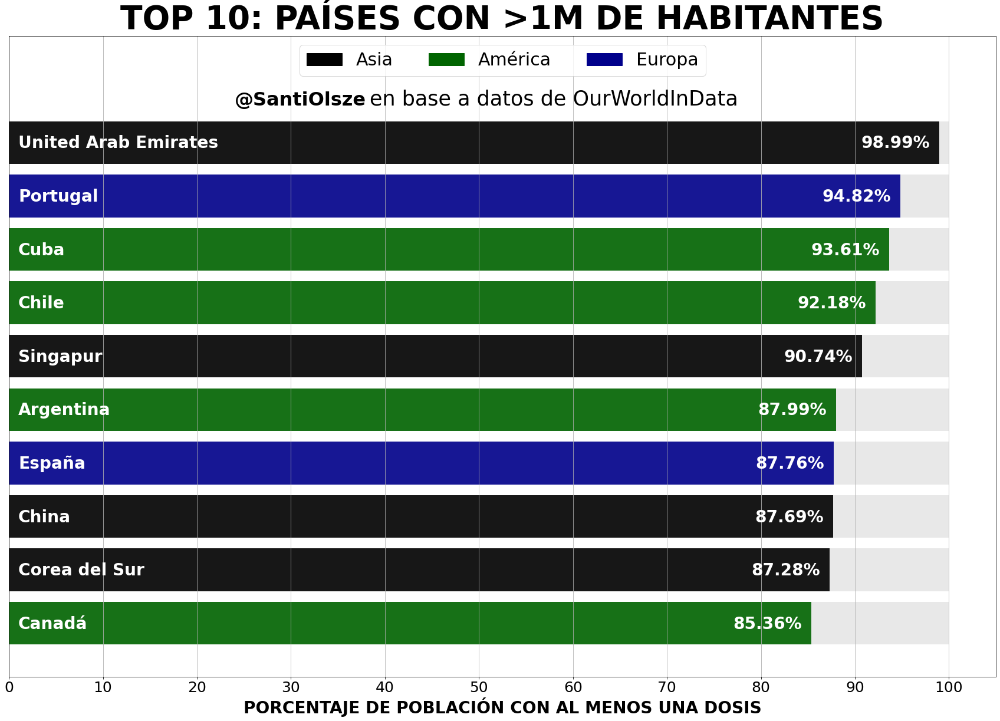

In [35]:
fig, ax = plt.subplots(figsize=(30,20))

y_pos = np.arange(len(d.index))
ax.barh(y_pos, [100 for i in d.index], align='center', color = "lightgrey", alpha = 0.5)
ax.barh(y_pos, d.people_vaccinated_per_hundred, align='center', color = d.colors,alpha = .9)
#ax.set_yticks(y_pos)
ax.set_yticks([])
#ax.set_yticklabels(people, fontweight = "bold", fontsize = 28)
for v,i in enumerate(d.index):
    ax.text(x = 1, y = v-0.1, s = i, fontsize = 28, fontweight = "bold", color = "w")
    
for v,i in enumerate(d.people_vaccinated_per_hundred):
    ax.text(x = i-1, y = v-0.1, s = str(i)+"%", fontsize = 28, fontweight = "bold", color = "w", ha = "right")
    
ax.set_xlabel('PORCENTAJE DE POBLACIÓN CON AL MENOS UNA DOSIS'.upper(), fontweight = "bold", fontsize = 28)
ax.set_title("TOP 10: PAÍSES CON >1M DE HABITANTES".upper(), fontweight = "bold", fontsize = 55)
ax.set_xticks(np.linspace(0,100,11))
ax.tick_params(axis='both', labelsize= 25)

x = [100 for i in d.index]

plt.text(31,len(x)-.3, "@SantiOlsze",fontsize = 32,fontweight='bold', ha ="center")
fuente = "en base a datos de OurWorldInData" #\n
plt.annotate(fuente,(58,len(x)+-.3),fontsize = 35, ha = "center")
ax.set_ylim(-1,len(x)+1)
plt.grid(":")
plt.savefig("TOP10VAC", bbox_inches = "tight")


import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

patch1 = mpatches.Patch(color='k', label='Asia')
patch2 = mpatches.Patch(color='darkgreen', label='América')
patch3 = mpatches.Patch(color='darkblue', label='Europa')

ax.legend(handles=[patch1,patch2,patch3], loc = "upper center", fontsize = 30, ncol = 3)



In [34]:
arg = OWID[(OWID.location == "Argentina") & (OWID.datetime > pd.to_datetime("2020-03-01"))][["datetime","new_cases_smoothed"]]
var_arg = variantes[variantes.Entity == "Argentina"].copy()
var_arg["datetime"] = pd.to_datetime(var_arg["Day"])

var_arg.loc[var_arg.datetime < pd.to_datetime("2021-07-01"),"Delta"] = 0
var_arg.loc[var_arg.datetime < pd.to_datetime("2021-07-01"),"Omicron"] = 0


In [35]:
for v,row in arg.iterrows():
    f =  row.datetime
    if len(var_arg[var_arg.datetime <= f].tail(1)) > 0:
        data = var_arg[var_arg.datetime <= f].tail(1)
    else:
        data = var_arg.head(1)
    
    arg.loc[arg.datetime == f, "non_who"] = data.non_who.item() / 100
    arg.loc[arg.datetime == f, "gamma"] = data.Gamma.item()  / 100
    arg.loc[arg.datetime == f, "lambda"] = data.Lambda.item() / 100
    arg.loc[arg.datetime == f, "alpha"] = data.Alpha.item() / 100
    arg.loc[arg.datetime == f, "omicron"] = data.Omicron.item() / 100
    arg.loc[arg.datetime == f, "beta"] = data.Beta.item() / 100
    arg.loc[arg.datetime == f, "delta"] = data.Delta.item() / 100

In [36]:
for col in arg.columns[2:]:
    arg[col + "_estimado"] = arg[col] * arg.new_cases_smoothed
    arg[col + "_estimado"] = arg[col + "_estimado"].rolling(window = 7).mean()

In [37]:
arg_export = arg.fillna(0)[["datetime"] + list(arg.columns[-7:])].transpose() #
arg_export.columns = arg_export.head(1).values[0]

In [38]:
arg_export[1:].to_csv("gif_variantes.csv")

In [167]:
arg_export

,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,...,2022-01-11,2022-01-12,2022-01-13,2022-01-14,2022-01-15,2022-01-16,2022-01-17,2022-01-18,2022-01-19,2022-01-20
datetime,2020-03-02 00:00:00,2020-03-03 00:00:00,2020-03-04 00:00:00,2020-03-05 00:00:00,2020-03-06 00:00:00,2020-03-07 00:00:00,2020-03-08 00:00:00,2020-03-09 00:00:00,2020-03-10 00:00:00,2020-03-11 00:00:00,...,2022-01-11 00:00:00,2022-01-12 00:00:00,2022-01-13 00:00:00,2022-01-14 00:00:00,2022-01-15 00:00:00,2022-01-16 00:00:00,2022-01-17 00:00:00,2022-01-18 00:00:00,2022-01-19 00:00:00,2022-01-20 00:00:00
non_who_estimado,0,0,0,0,0,0,1.714,1.714,2.286,2.571,...,2167.47,2276.66,2333.79,2422.91,2407.6,2383.04,2425.92,2385.02,2376.62,2380.6
gamma_estimado,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
lambda_estimado,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
alpha_estimado,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
omicron_estimado,0,0,0,0,0,0,0,0,0,0,...,86699,91066.5,93351.5,96916.2,96303.8,95321.7,97036.7,95400.6,95064.9,95223.8
beta_estimado,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
delta_estimado,0,0,0,0,0,0,0,0,0,0,...,13004.8,13660,14002.7,14537.4,14445.6,14298.3,14555.5,14310.1,14259.7,14283.6


In [1]:
data = pd.read_excel("../SaludBAP/informes2022/mortalidad_enero.xlsx")
data = data[data.columns[0:6]]

NameError: name 'pd' is not defined

In [127]:
data = data.head(12)
data[["mort_100_k_a","mort_100_k_b"]] = data[["Mortalidad upper","Mortalidad"]]  * 100000

/home/santiago/.local/lib/python3.8/site-packages/pandas/core/frame.py:3069: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [128]:
data["mort_center"] = data[["mort_100_k_a","mort_100_k_b"]].mean(axis = 1)

<ipython-input-128-b3940963bfd6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["mort_center"] = data[["mort_100_k_a","mort_100_k_b"]].mean(axis = 1)


In [129]:
data["error"] = abs(data["mort_center"] - data["mort_100_k_b"])

<ipython-input-129-385a76f67777>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["error"] = abs(data["mort_center"] - data["mort_100_k_b"])


In [130]:
data["mort_min"] = data["mort_center"]  - data["error"]
data["mort_max"] = data["mort_center"]  + data["error"]

<ipython-input-130-63e00a06b2f2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["mort_min"] = data["mort_center"]  - data["error"]
<ipython-input-130-63e00a06b2f2>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["mort_max"] = data["mort_center"]  + data["error"]


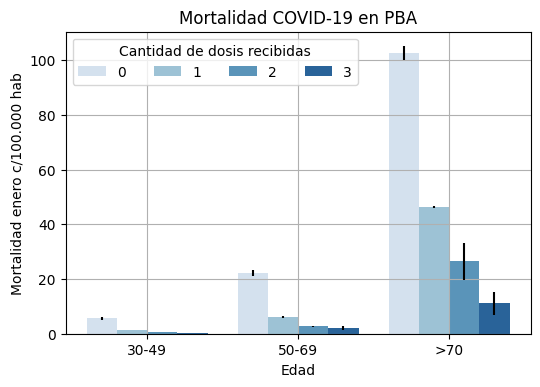

In [132]:
# plt.figure(dpi = 100)
# sns.barplot(data = data, x = "Edad", y = "N", hue = "Dosis recibidas", palette = "Reds")
# plt.ylabel("mortalidad Enero 2022 (absolutos)")
# 

# plot the figure
fig, ax = plt.subplots(dpi = 100)
sns.barplot(data = data, x = "Edad", y = "mort_center", hue = "Status", ax = ax, palette = "Blues")


error = dict(data[["mort_center","error"]].values)

plt.ylabel("Mortalidad enero c/100.000 hab")
plt.title("Mortalidad COVID-19 en PBA")
plt.legend(ncol = 4, title="Cantidad de dosis recibidas")
plt.grid()

for p in ax.patches:
    x = p.get_x()  # get the bottom left x corner of the bar
    w = p.get_width()  # get width of bar
    h = p.get_height()  # get height of bar
    min_y = h - error[h]  # use h to get min from dict z
    max_y = h + error[h]  # use h to get max from dict z
    plt.vlines(x+w/2, min_y, max_y, color='k')  # draw a vertical line

In [32]:
dic = {"United States":3,
"Italy":0,
"United Kingdom":12,
"South Africa":30, 
"Brazil":-13,
"Spain":0

}

cols = {i:"lightgray" for i in dic}

cols

dic["Argentina"] = 0
cols["Argentina"] = "darkblue"

cols["United Kingdom"] = "k"
cols["South Africa"] = "green"


In [33]:
def perc_formatter(x, pos):
    return f'{int(x)}%'

def mmyyy_formatter(x, pos):
    return f'{x[2:4]}/{x[4:]}'



Solarize_Light2
_classic_test_patch
bmh
bright
cjk-jp-font
cjk-kr-font
cjk-sc-font
cjk-tc-font
classic
dark_background
fast
fivethirtyeight
ggplot
grayscale
grid
high-contrast
high-vis
ieee
light
muted
no-latex


<ipython-input-34-1eb5134b1f1c>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(dpi = 200)


notebook
pgf
retro
scatter
science
seaborn
seaborn-bright
seaborn-colorblind
seaborn-dark
seaborn-dark-palette
seaborn-darkgrid
seaborn-deep
seaborn-muted
seaborn-notebook
seaborn-paper
seaborn-pastel
seaborn-poster
seaborn-talk
seaborn-ticks
seaborn-white
seaborn-whitegrid
std-colors
tableau-colorblind10
vibrant


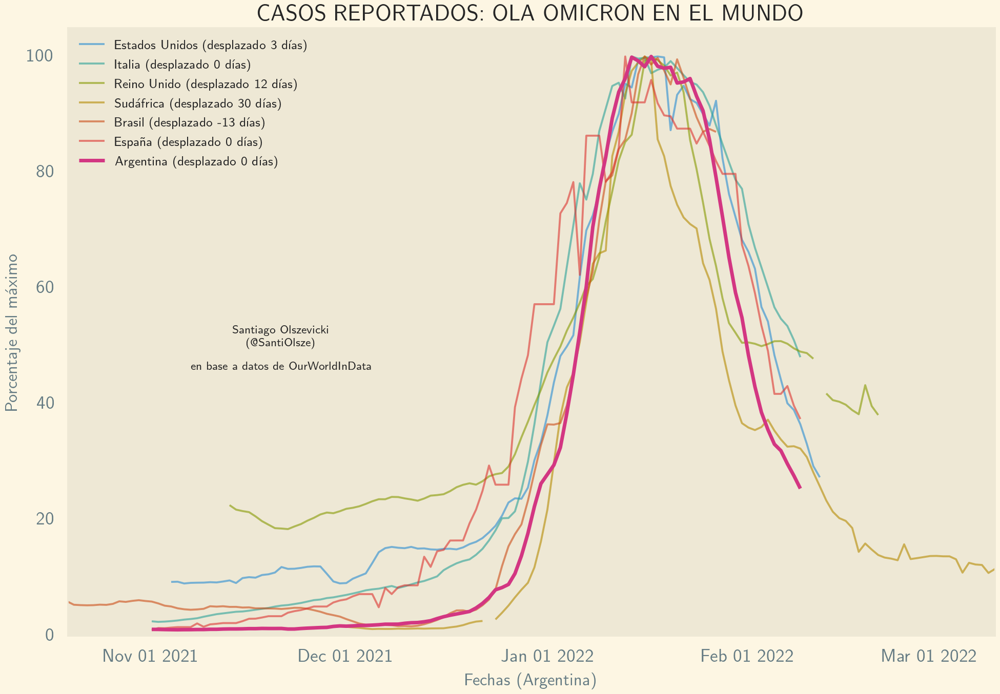

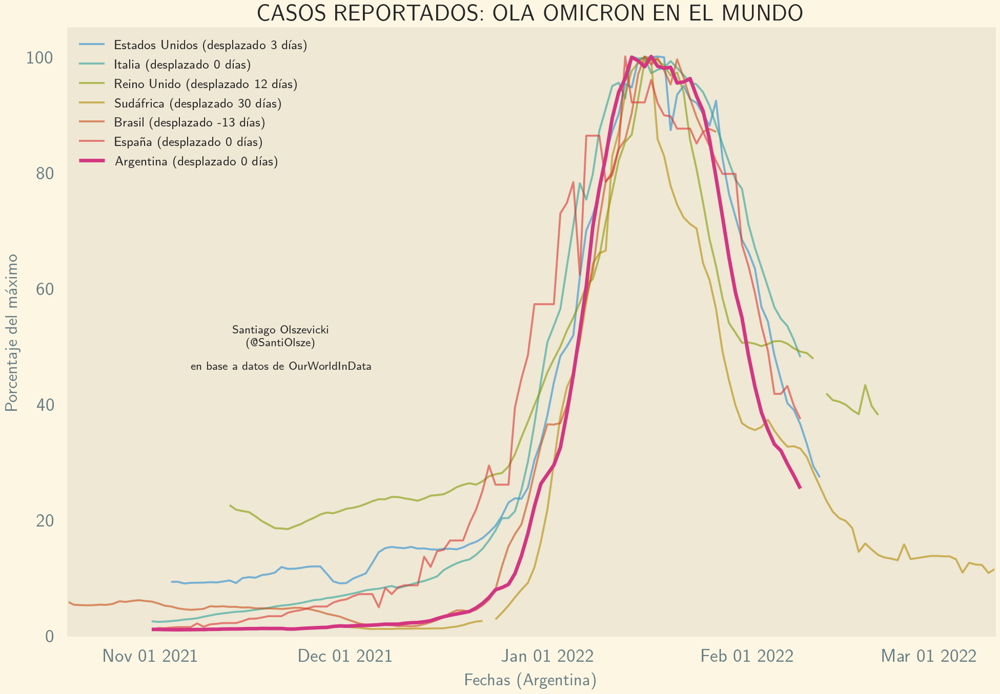

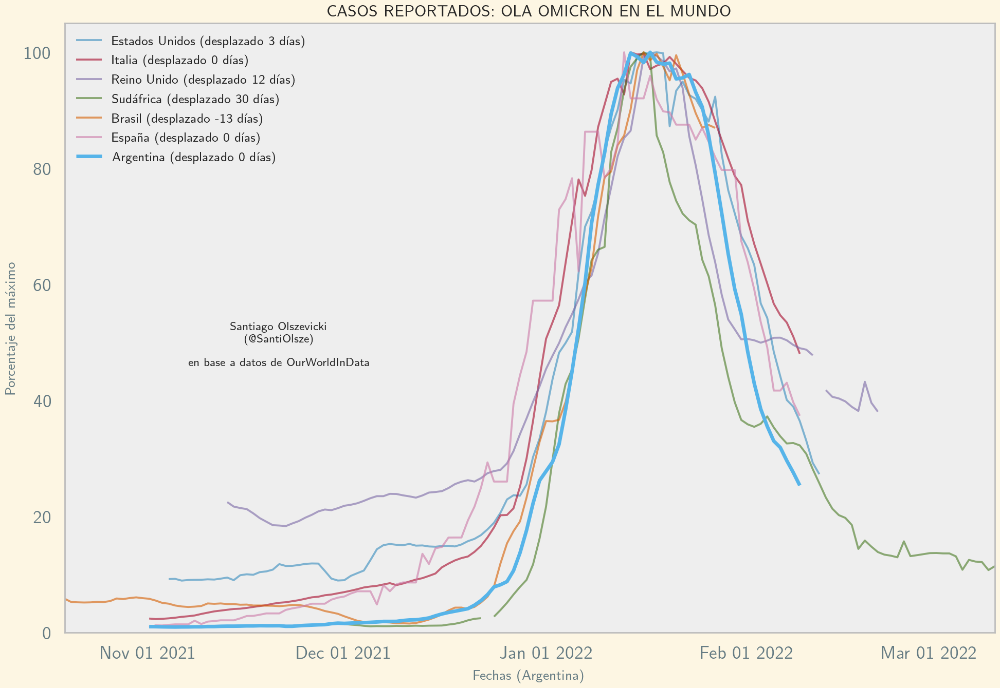

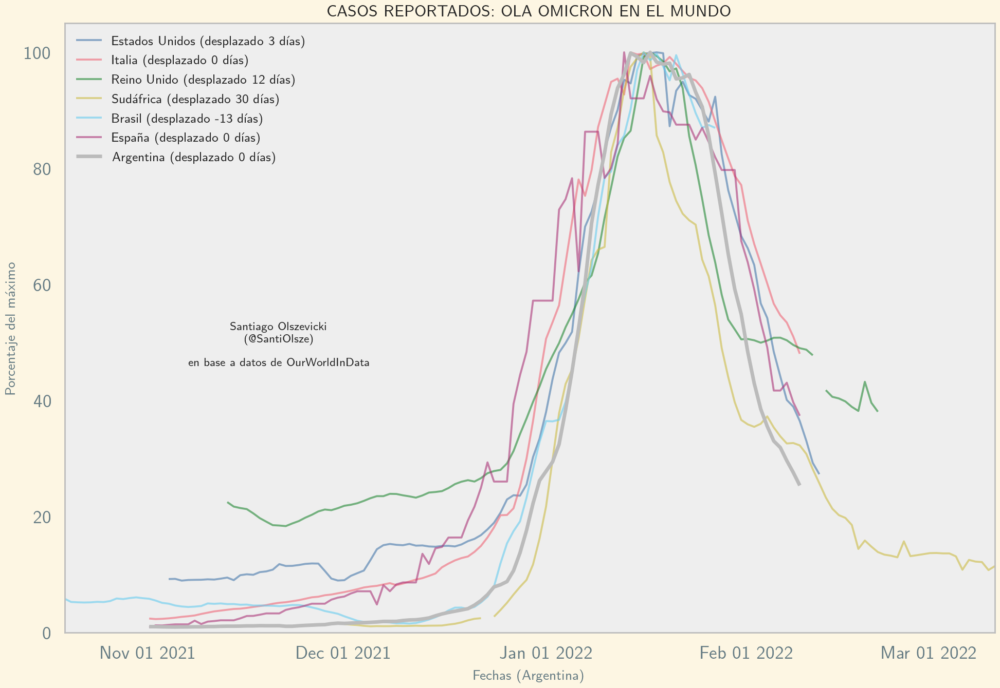

findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


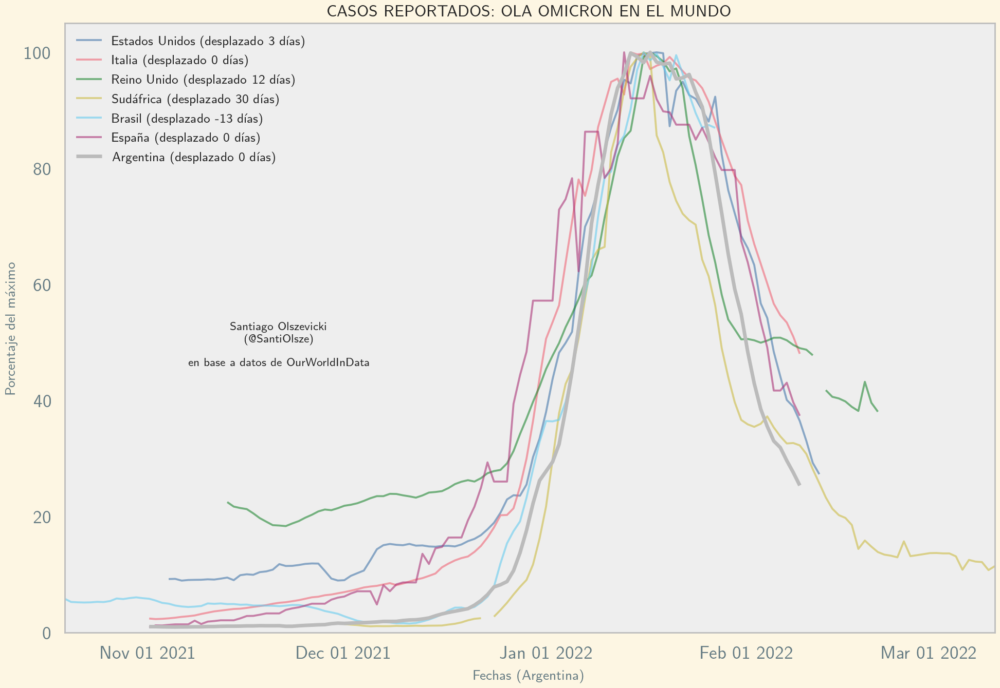

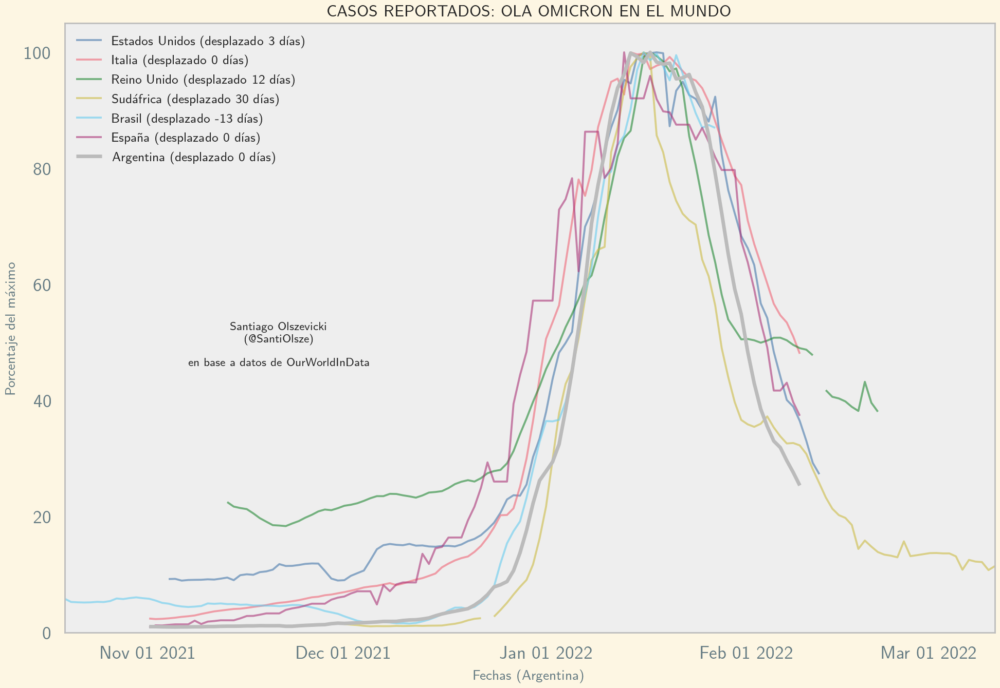

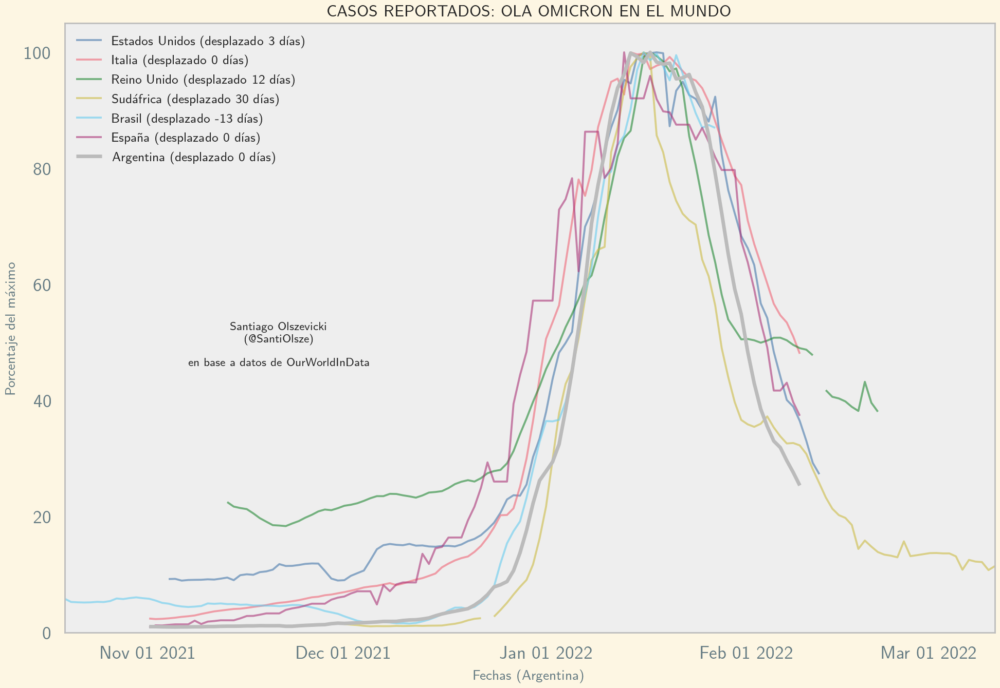

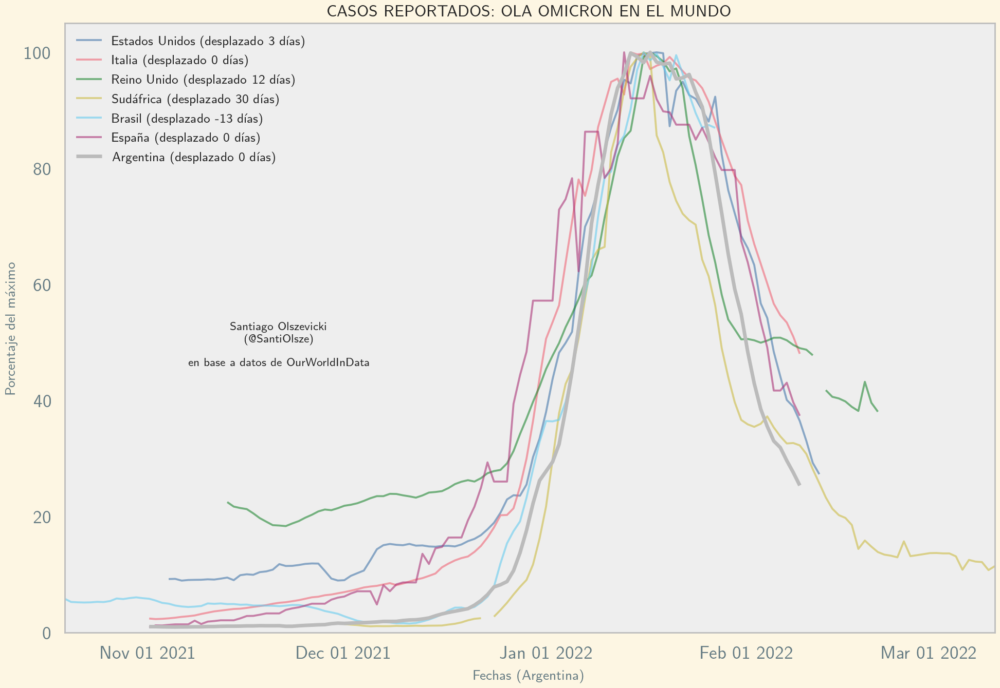

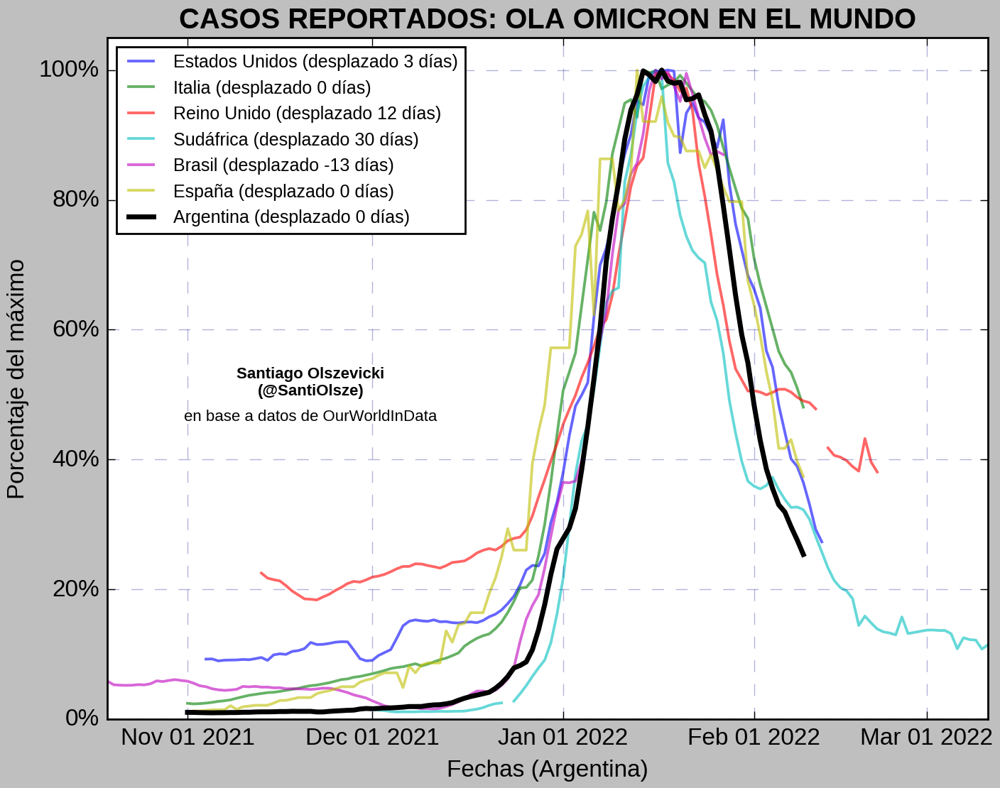

...

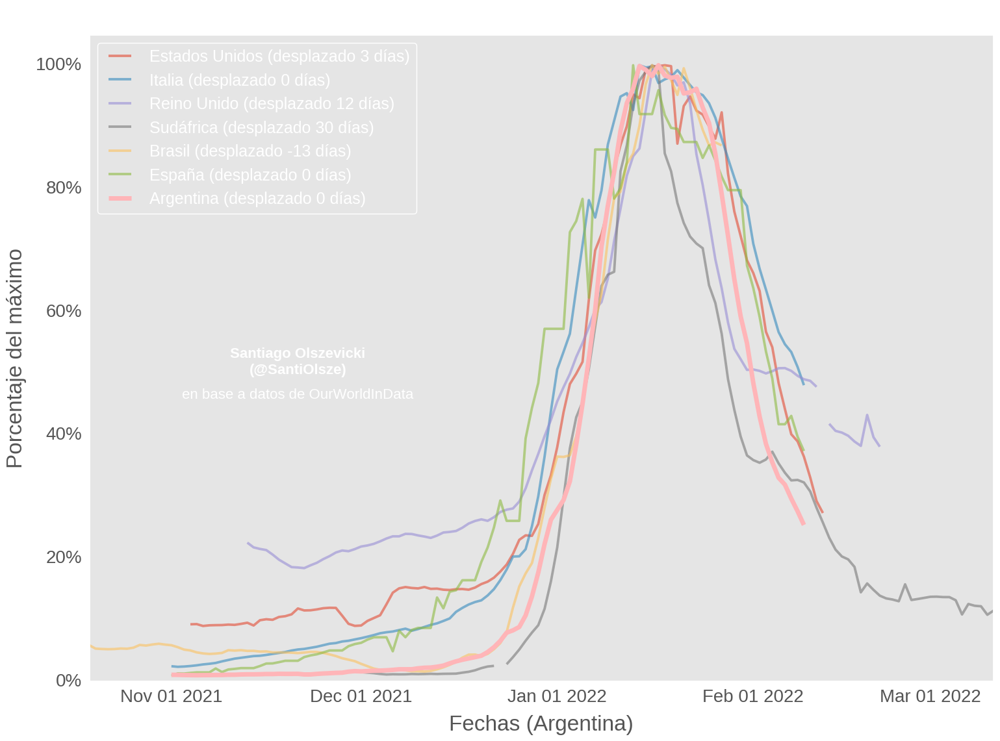

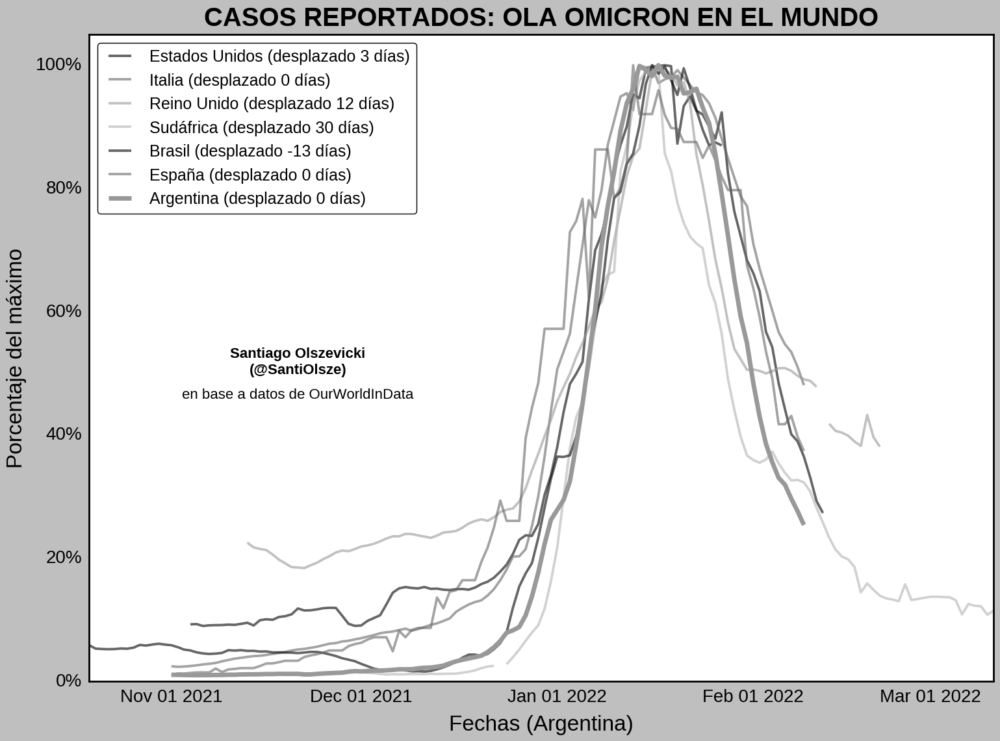

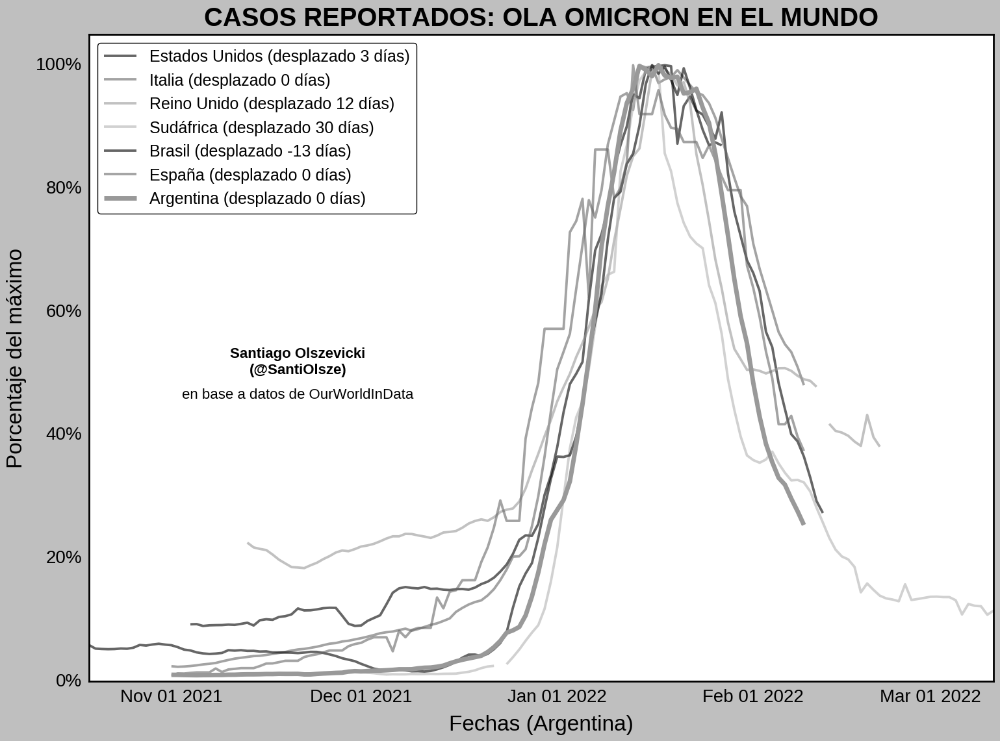

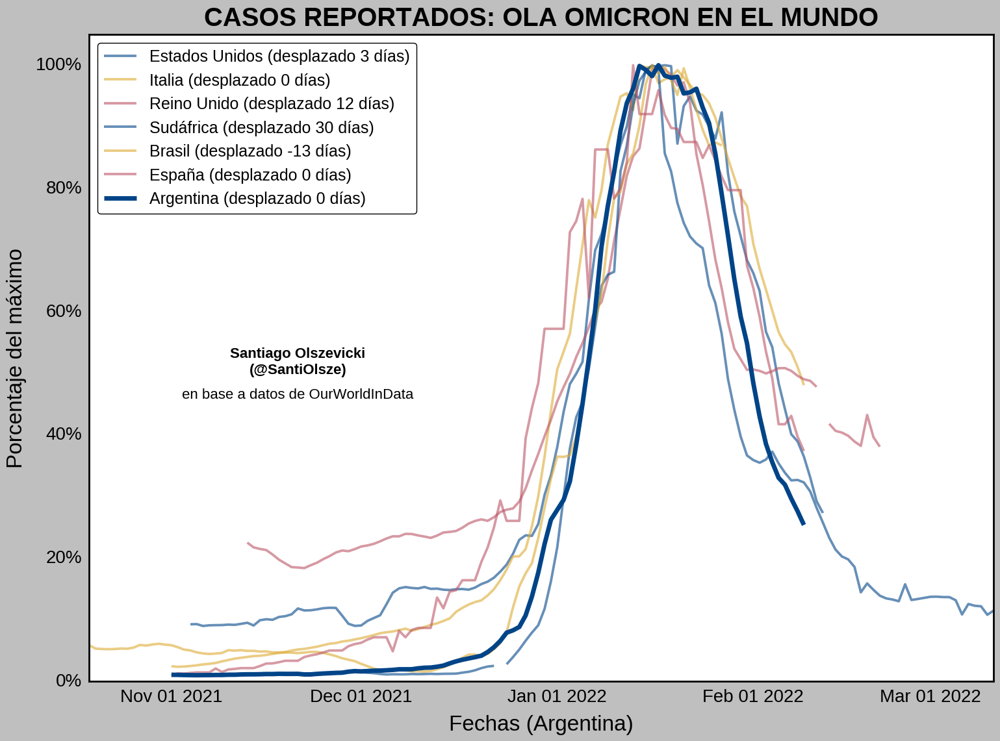

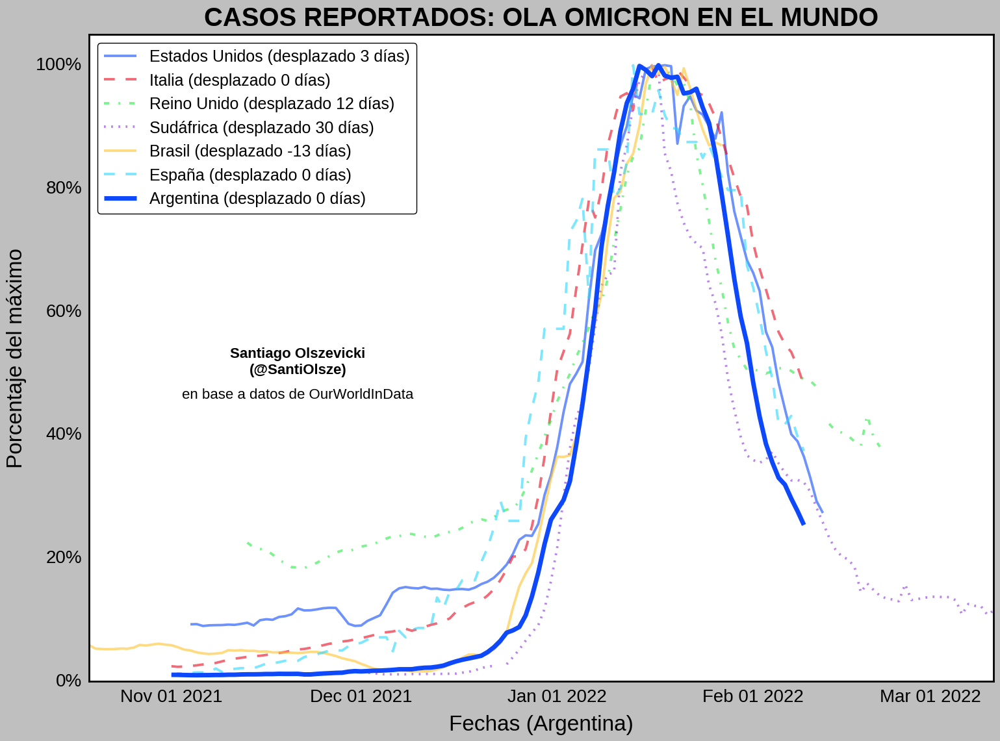

findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


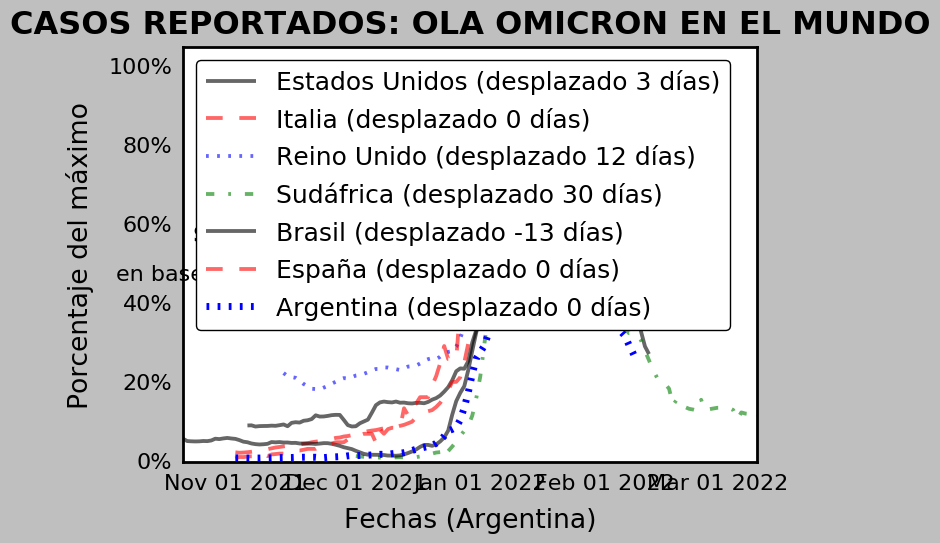

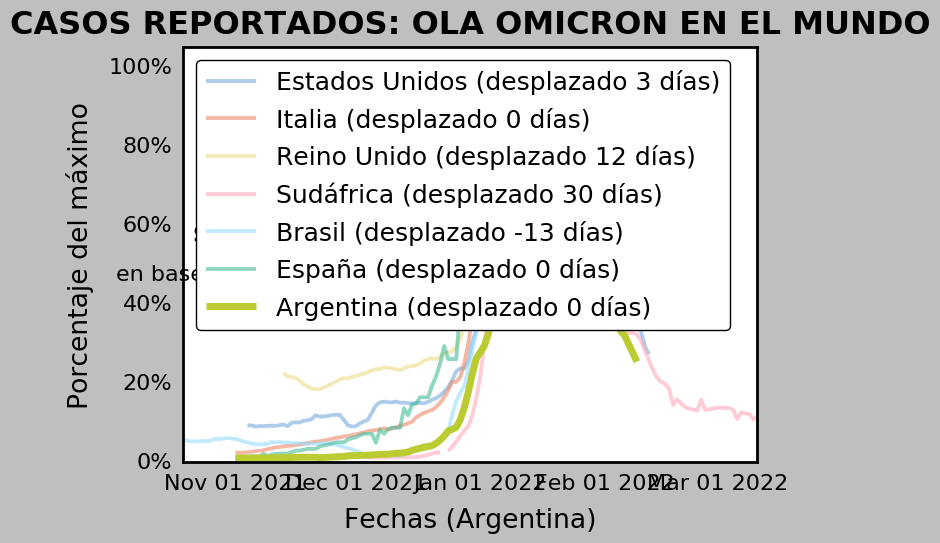

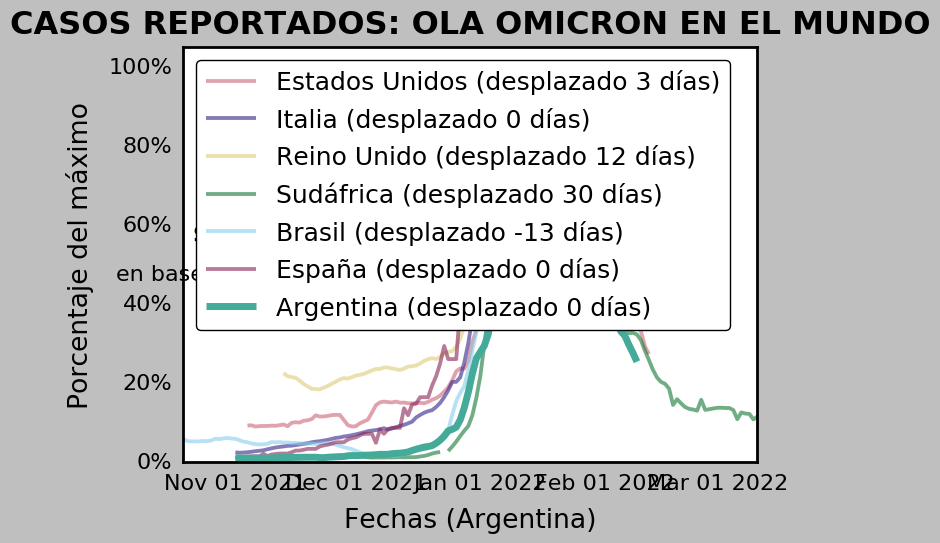

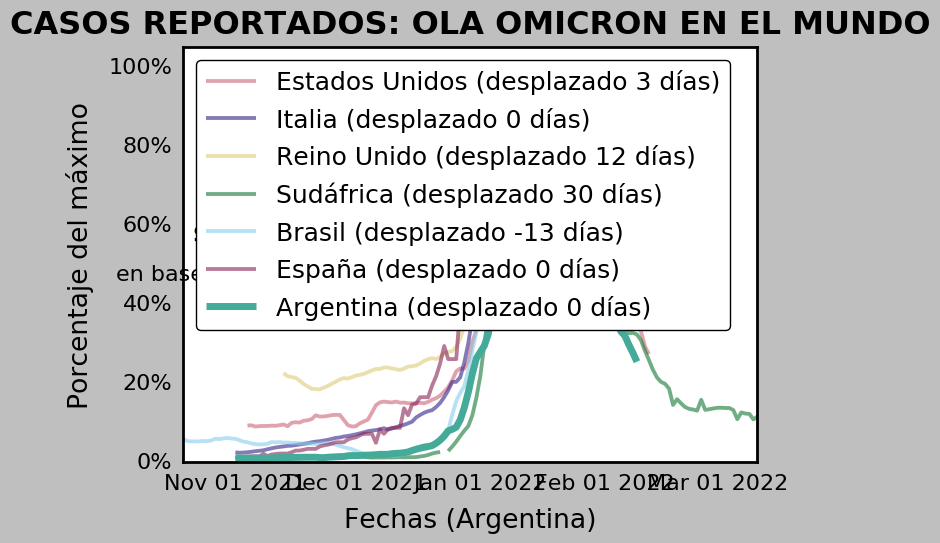

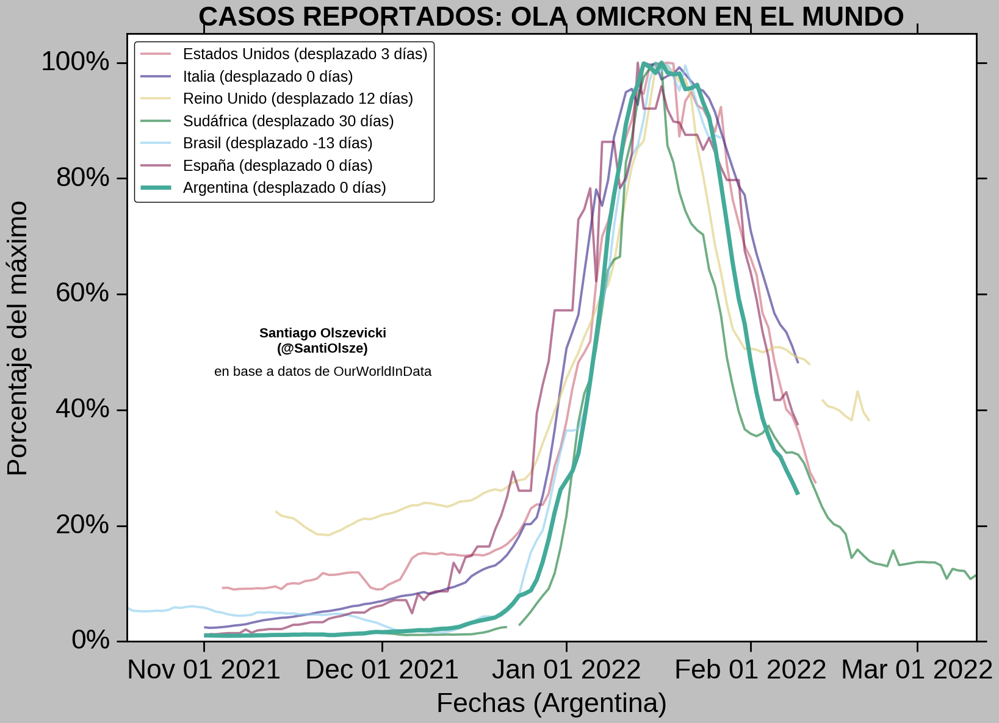

...

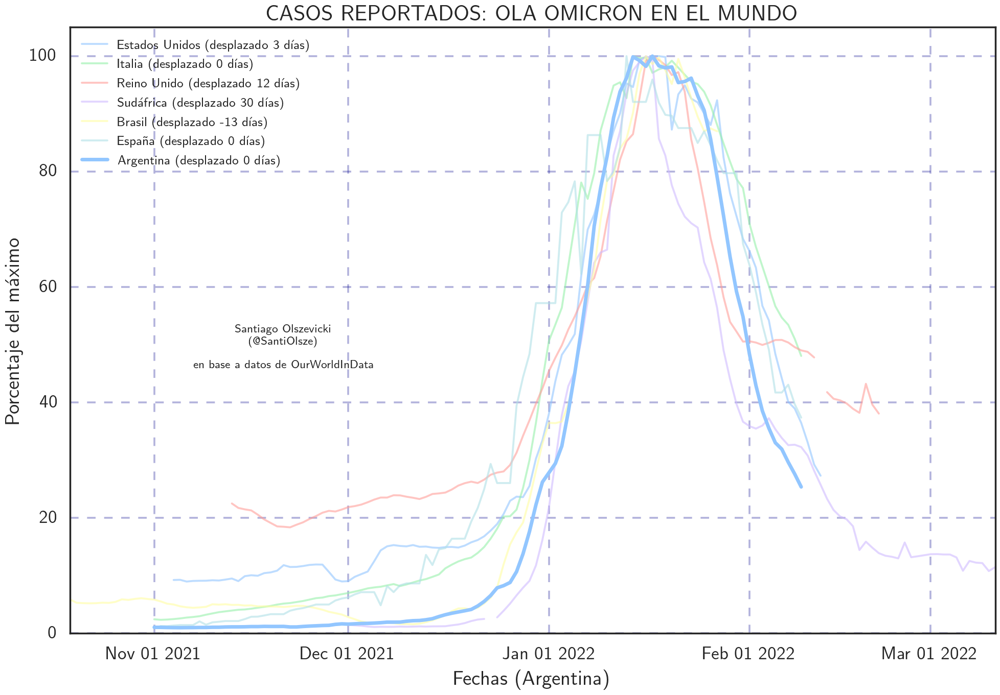

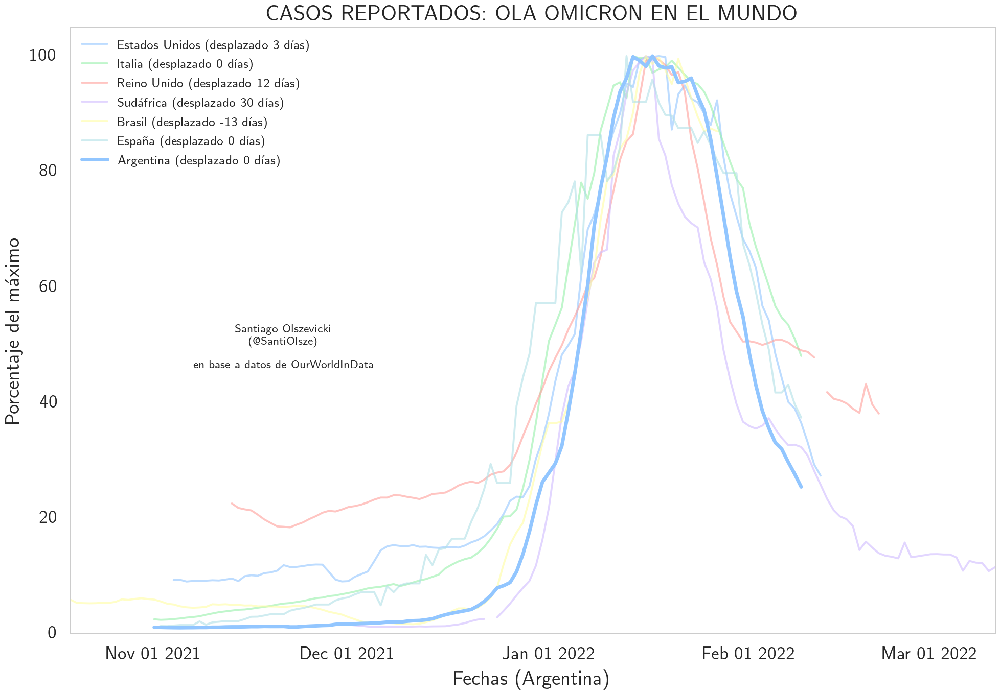

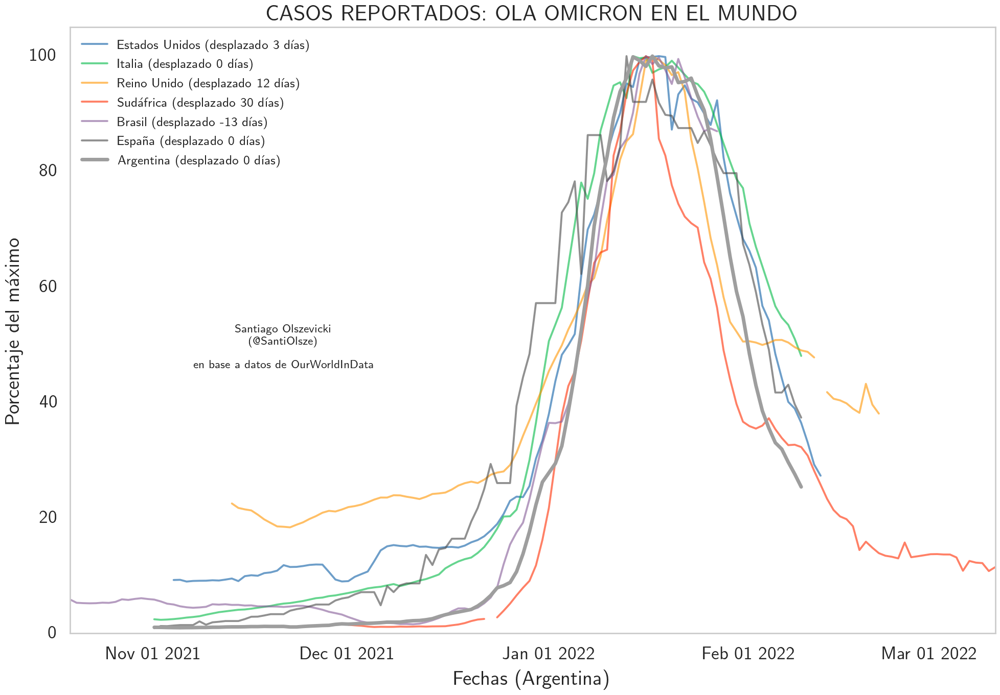

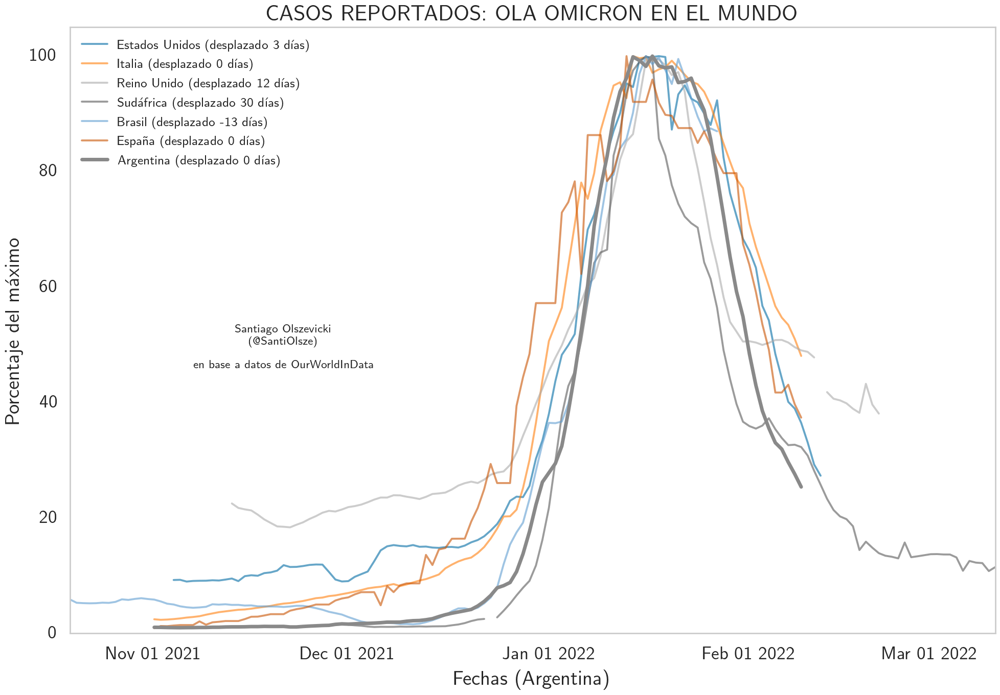

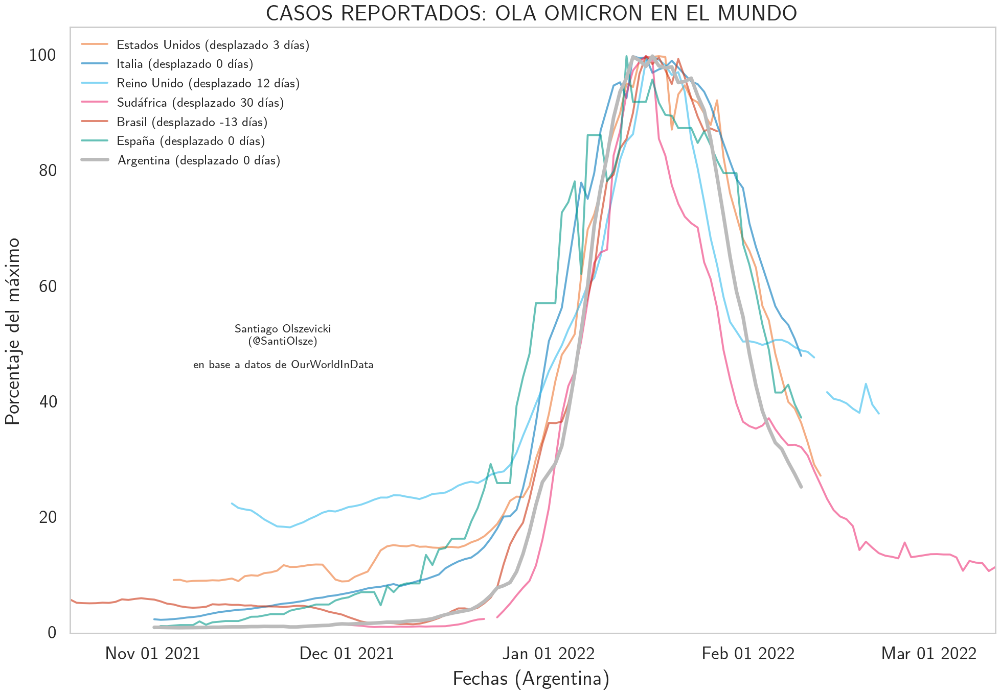

In [34]:
def plot_():
    fig, ax = plt.subplots(dpi = 200)
    for alpha, c in enumerate(dic):
        data = OWID[(OWID.location == c) & (OWID.datetime >= pd.to_datetime("2021-11-01"))].copy()
        data["datatime"] = data["datetime"] + datetime.timedelta(dic[c])
        data["new_cases_smoothed_soft"] = data["new_cases_smoothed"] / data["new_cases_smoothed"].max() * 100
        grosor = 2; alpha = 0.6
        if c == "Argentina": grosor = 3; alpha = 1
        ax.plot(data.datatime, data.new_cases_smoothed_soft, 
                label = f"{paises_dict[c]} (desplazado {dic[c]} días)",
                 #color = cols[c],
                alpha = alpha, linewidth = grosor- 1/(alpha+1))

        #ax.plot(data.datetime, data.new_cases_smoothed_soft, 
                #label = f"{paises_dict[c]} (desplazado {dic[c]} días)",
        #         color = cols[c], alpha = .1, linewidth = 2)

    ax.yaxis.set_major_formatter(FuncFormatter(perc_formatter))


    ax.legend(fontsize = 9, loc = "upper left")
    ax.set_ylabel("Porcentaje del máximo")
    ax.set_xlabel("Fechas (Argentina)")
    ax.grid(color = "darkblue", ls = "--", alpha = .3)
    ax.set_title("CASOS REPORTADOS: OLA OMICRON EN EL MUNDO", fontweight = "bold")
    plt.xticks([pd.to_datetime(i) for i in ["2021-11-01","2021-12-01","2022-01-01","2022-02-01","2022-03-01"]]);
    plt.ylim(0,105)

    plt.text(pd.to_datetime("2021-11-21"),50, "Santiago Olszevicki\n(@SantiOlsze)",fontsize = 8,fontweight='bold', ha ="center")
    fuente = "en base a datos de OurWorldInData" #\n
    plt.annotate(fuente,(pd.to_datetime("2021-11-21"),46),fontsize = 8, ha = "center")
    
for style in plt.style.available:
    try:
        print(style)
        plt.style.use(style)
        plot_()
    except:
        print(style, "failed")

['Solarize_Light2',
 '_classic_test_patch',
 'bmh',
 'bright',
 'cjk-jp-font',
 'cjk-kr-font',
 'cjk-sc-font',
 'cjk-tc-font',
 'classic',
 'dark_background',
 'fast',
 'fivethirtyeight',
 'ggplot',
 'grayscale',
 'grid',
 'high-contrast',
 'high-vis',
 'ieee',
 'light',
 'muted',
 'no-latex',
 'notebook',
 'pgf',
 'retro',
 'scatter',
 'science',
 'seaborn',
 'seaborn-bright',
 'seaborn-colorblind',
 'seaborn-dark',
 'seaborn-dark-palette',
 'seaborn-darkgrid',
 'seaborn-deep',
 'seaborn-muted',
 'seaborn-notebook',
 'seaborn-paper',
 'seaborn-pastel',
 'seaborn-poster',
 'seaborn-talk',
 'seaborn-ticks',
 'seaborn-white',
 'seaborn-whitegrid',
 'std-colors',
 'tableau-colorblind10',
 'vibrant']

In [3]:
data = pd.read_csv("letalidad_olas.csv")
data[data.columns[1:]] = data[data.columns[1:]] * 100

In [4]:
data["red"] = data.letalidad_OMICRON / data.letalidad_OLA2 * 100

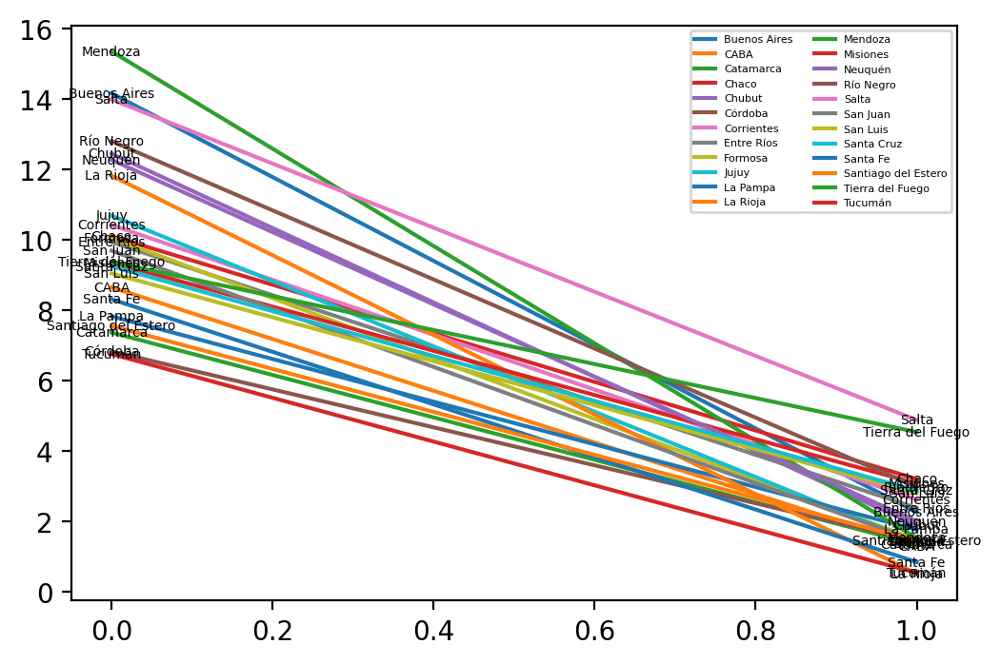

In [5]:
fig, ax = plt.subplots(dpi = 200)

for index, row in data.iterrows():
    ax.plot([0,1],[row.letalidad_OLA2, row.letalidad_OMICRON], label = row.residencia_provincia_nombre)
    ax.text(x = 0, y = row.letalidad_OLA2, s = row.residencia_provincia_nombre, va = "center",ha = "center", fontsize = 5)
    ax.text(x = 1, y = row.letalidad_OMICRON, s = row.residencia_provincia_nombre, va = "center",ha = "center", fontsize = 5)



plt.legend(fontsize = 4, ncol = 2)

In [7]:
data

,residencia_provincia_nombre,letalidad_OLA2,letalidad_OMICRON,red
0,Buenos Aires,14.168690,2.255527,15.919093
1,CABA,8.651880,1.295243,14.970658
2,Catamarca,7.365662,1.333333,18.102017
3,Chaco,10.106303,3.200235,31.665731
4,Chubut,12.454334,1.872176,15.032322
5,Córdoba,6.828771,1.431404,20.961364
6,Corrientes,10.425214,2.619208,25.123776
7,Entre Ríos,9.938704,2.376365,23.910208
8,Formosa,10.060514,1.469971,14.611287
9,Jujuy,10.688286,1.398210,13.081707


Text(0, 0.5, '% relativo a ola 2')

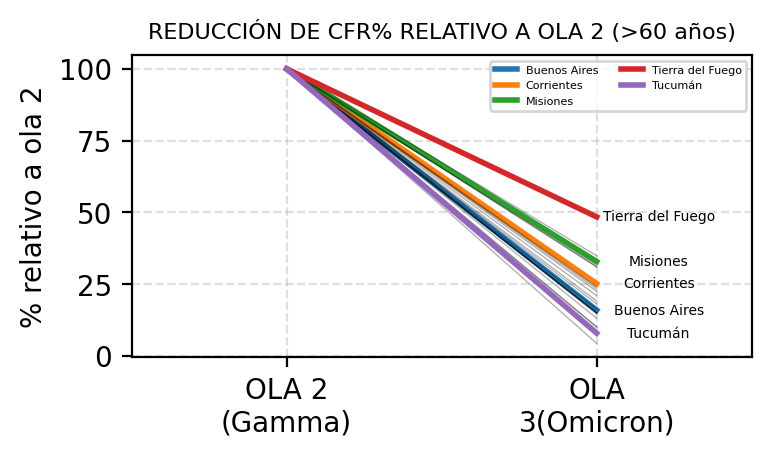

In [6]:
fig, ax = plt.subplots(dpi = 200, figsize = (4,2))

for index, row in data.iterrows():
    if row.residencia_provincia_nombre in ["Buenos Aires","Misiones","Corrientes","Tierra del Fuego", "Tucumán"]:
        ax.plot([0,1],[100, row.red], label = row.residencia_provincia_nombre, linewidth = 2)
        ax.text(x = 1.2, y = row.red, s = row.residencia_provincia_nombre, va = "center",ha = "center", fontsize = 5)

    else:
        ax.plot([0,1],[100, row.red], color = "k", alpha = .3, linewidth = .5)
    #ax.text(x = 0, y = row.letalidad_OLA2, s = row.residencia_provincia_nombre, va = "center",ha = "center", fontsize = 5)



plt.legend(fontsize = 4, ncol = 2)
plt.xlim(-.5,1.5)
plt.xticks([0,1],["OLA 2\n(Gamma)","OLA\n3(Omicron)"])
plt.grid(ls = "--", alpha = .4)
plt.title("REDUCCIÓN DE CFR% RELATIVO A OLA 2 (>60 años)", fontsize = 8)
plt.ylabel("% relativo a ola 2")
#plt.ylim(0,50)

In [4]:
OWID.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [47]:
plt.figure(dpi = 200)
plt.style.use("classic")
arg = OWID[OWID.location == "Argentina"][['datetime','people_vaccinated_per_hundred',
       'people_fully_vaccinated_per_hundred', 'total_boosters_per_hundred']]

arg = arg.rename(columns = {"people_vaccinated_per_hundred":"Una dosis",
                   "people_fully_vaccinated_per_hundred": "Esquema completo",
                   "total_boosters_per_hundred":"Dosis de refuerzo"})

for col in arg.columns.drop("datetime"):
    arg[col+"_shift"] = arg[col].shift(180).fillna(0)
    arg[col + "(ult. 6 meses)"] = arg[col] -  arg[col+"_shift"]
    #sns.lineplot(data = arg, x = "datetime", y = col+ "(ult. 6 meses)", label = col)
    


<Figure size 1280x960 with 0 Axes>

In [48]:

plt. style. use('default')


(array([18628., 18687., 18748., 18809., 18871., 18932., 18993., 19052.,
        19113.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

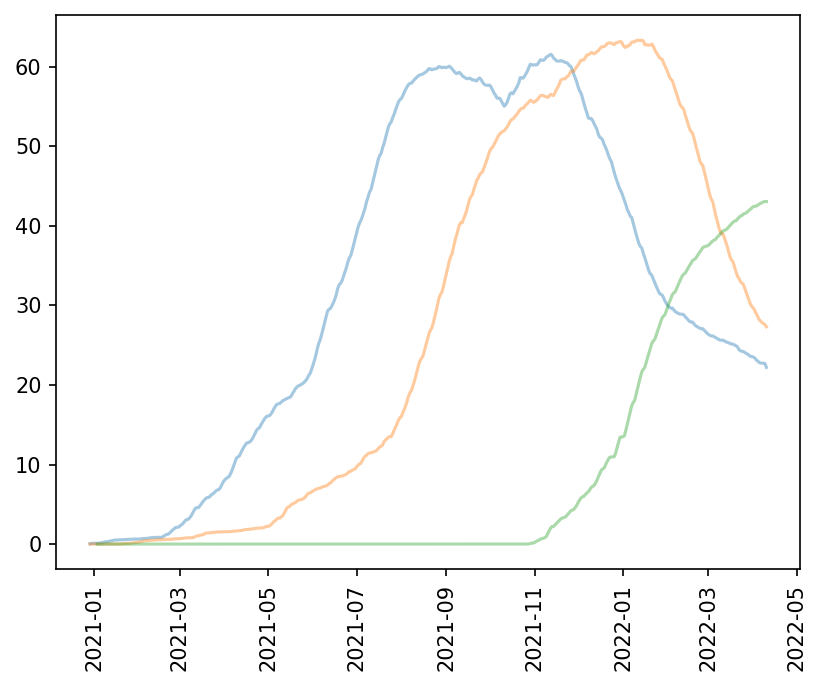

In [58]:
plt.figure(dpi = 150)
plt.plot(arg.datetime, arg["Una dosis(ult. 6 meses)"], alpha = .4)
plt.plot(arg.datetime, arg["Esquema completo(ult. 6 meses)"], alpha = .4 )

plt.plot(arg.datetime,arg["Dosis de refuerzo(ult. 6 meses)"], alpha = .4 )

plt.xticks(rotation = 90) 

In [62]:
arg[arg.columns[-3:]].fillna(0).sum()

,Esquema completo(ult. 6 meses),Dosis de refuerzo_shift,Dosis de refuerzo(ult. 6 meses)
6142,0.00,0.0,0.00
6143,0.00,0.0,0.00
6144,0.00,0.0,0.00
6145,0.00,0.0,0.00
6146,0.00,0.0,0.00
...,...,...,...
6968,28.03,0.0,42.81
6969,27.83,0.0,42.90
6970,27.70,0.0,43.00
6971,27.58,0.0,43.04
